## 3<sup>rd</sup> Year Project Lab Book

### Developing new methods to analyse functional magnetic resonance imaging to understand brain function 

#### Jemimah Tumelty and Kaung Kyaw 

To make this jupyter notebook easier to follow our project will be split into several different parts. With each part we will be developing and executing code, gaining insight into where the data originates from and relating it to the background knowledge. Background information will largely be written in <span style="color:green">green</span> and any errors in the code that we later had to modify is in <span style="color:red">red</span>. Our project plan, along with a gantt chart, has been inserted below.

### Project Plan


__Project Name__  Develop new methods to analyse functional magnetic resonance for brain function


__Project Supervisor__ Karen Mullinger


__Aims__
Use acquisition techniques on python software interface to analyse the post-stimulus response in BOLD data and distinguish if the post-stimulus response is found where the primary positive response is not.


__Objectives__
1) Understand how general linear models (GLMs) work by creating a simplified version using BOLD data for 1-3 subjects
2) Extract and plot time course and find the timings of the post-stimulus response relative to stimulus onset
3) Create a regressor which only models the post-stimulus response and analyse the post-stimulus response time window


__Key equipment and techniques__
Use of python 


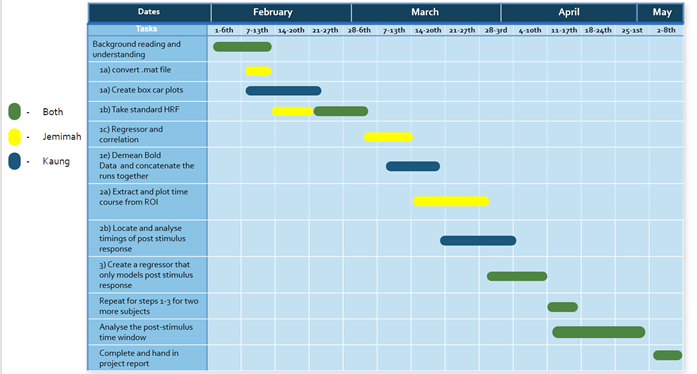

In [1]:
from IPython.display import Image
Image(filename="project_plan_table.png",width=1200, height=600, embed=True)

##### 4th February 2022

Our first meeting was held on teams, this session contained an overview of the project along with a run through of the theory behind it. We spent the next week reading through papers on the BOLD fMRI responese, focussing on the post-stimulus undershoot, and the hemodynamic response function to gain a more rounded sense of knowledge on the subject. 

The purpose of the project is to understand the post-stimulus bold response, and what it's thought to be driven by. In order to acheive this, it has been partitioned in three ways. The first part will be aimed at understanding how a Generalised Linear Model (GLM) works. The second part will be for understanding what the timecourses look like. The third part will consist of trying to create a regressor which only models the post-stimulus response.   

PART 1
The section has been split further again in order to make the task more palatable. Firstly, the boxcar of subject 12123 will be taken from experimental data. This is from onsets which contains information about when the BOLD signal comes on and how long it lasts. Next the standard hemodynamic response function (HRF) will be produced in order to convolve the boxcar with it. As the boxcars only tell the duration, and do not contain the shape itself of the BOLD signal which is captured by the double gamma function of the HRF - with one modelling the peak and another modelling the undershoot. 

##### 16th February 2022

After teething problems with code modules and previewing files we began coding, starting with Kaung producing a boxcar correlating to a sample run and Jemimah creating a hrf from the linear combination of two gamma equations, which was found in the paper _'Modelling the haemodynamic responsefunction in fMRI:Efficiency, Bias and Mis-modelling'_ by Martin A.Lindquist. 


Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[ 2.9762, 10.9844,  2.965 ,  3.    , 10.8586, 10.9822, 10.8824,
         2.9922, 10.973 , 11.    ,  2.7812,  2.9988]])} of type <class 'dict'>
Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
Durations specifically: [[ 2.9762 10.9844  2.965   3.     10.8586 10.9822 10.8824  2.9922 10.973
  11.      2.7812  2.9988]]
Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791.17921721]]



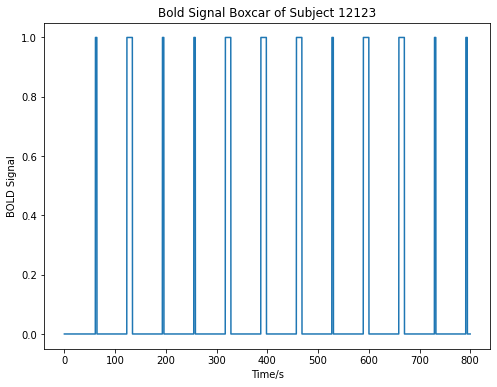

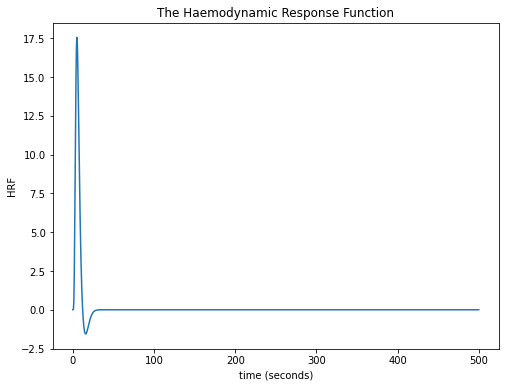

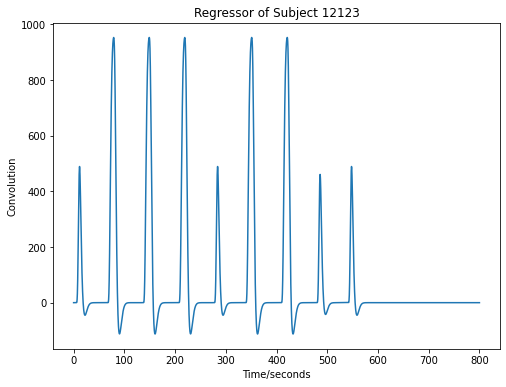

In [2]:
#%%
import scipy.io as sio
import matplotlib.pyplot as plt 
import numpy as np
from scipy.special import gamma, factorial
import nibabel

#Loads in the required .mat files in python
onset = sio.loadmat("Python Code\\run1_BOLD_EMG_onset.mat")
durations = sio.loadmat("Python Code\\run1_durations.mat")

#control testing to show the actual values and types of data that are worked with
print(f"""
Duration is: {durations} of type {type(durations)}
Onset is: {onset} of type {type(onset)}
Durations specifically: {durations["move_dur"]}
Onset specifically: {onset["bold"]}
""")


#calls keys of dictionaries to get np array 
onset_data = onset["bold"][0]
duration_data = durations["move_dur"][0]

#setting lists and arrays for coordinates
x = np.arange(0,800,0.1)
y = []
j = 0

# loop to create the y values for boxcar
for i in range(len(x)): 
    if x[i] >= onset_data[j] and x[i] <= onset_data[j]+duration_data[j]:
        y.append(1)
        
    elif  x[i] > onset_data[j]+duration_data[j] and j != len(onset_data)-1: 
        y.append(0)
        j +=1
    else: 
        y.append(0)

#plotting figures of x and y for boxcar
plt.figure(figsize=(8,6))
plt.title("Bold Signal Boxcar of Subject 12123")
plt.ylabel("BOLD Signal")
plt.xlabel("Time/s")
plt.plot(x,y)


#plotting a hrf 
t= np.arange(0,500.1,0.1)
A=100
a1=6
a2=16
b1=1
b2=1
c=1/6
Ta1=gamma(6)
Ta2=gamma(16)
x1=(t**(a1-1)*(b2**a1)*(np.exp(-b1*t)))/Ta1
y1= (t**(a2-1)*(b2**a2)*(np.exp(-b2*t)))/Ta2

h = A*(x1-(y1*c))
plt.figure(figsize=(8,6))
plt.plot(t,h)
plt.title('The Haemodynamic Response Function') # Give the plot a title
plt.axis() # show axis
plt.xlabel("time (seconds)") #label for x axis
plt.ylabel("HRF") #label for y axis


#convolution plot with same parameter in order to get the same number of output as inputted largest no. of data points array.
conv = np.convolve(y,h,"same")
plt.figure(figsize=(8,6))
plt.title("Regressor of Subject 12123")
plt.xlabel("Time/seconds")
plt.ylabel("Convolution")
plt.plot(x,conv)
plt.show()


#%%

The code above was created as a means of producing a regressor, which is a convolution of the boxcar and hrf of subject 12123. The boxcar is a result of a BOLD signal from a prolonged stimulus. The standard hemodynamic response function is modelled using the double gamma variate. As a consequence of convoluting the boxcar with the HRF, the HRF broadens or thins with the boxcar duration of the experiment - in addition to having multiple peaks and undershoots rather than having just 1 peak and 1 undershoot as modelled by the 2 gamma functions. 

#### 21st February 2022

In order to show the post-stimulus undershoot only, the second gamma equation from Lindquist was isolated (where the first gamma equation represents the main overshoot).

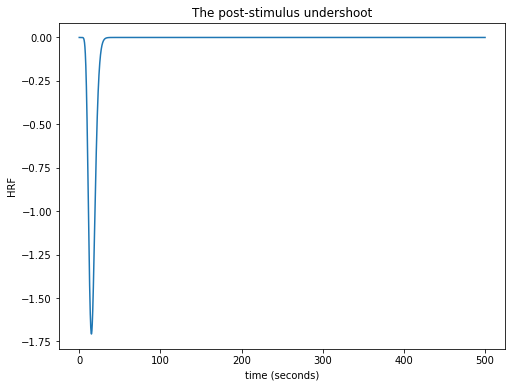

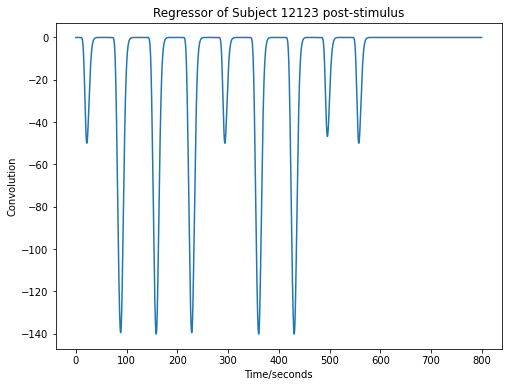

In [3]:
psu = A*(-y1*c)
plt.figure(figsize=(8,6))
plt.plot(t,psu)
plt.title('The post-stimulus undershoot') # Give the plot a title
plt.axis() # show axis
plt.xlabel("time (seconds)") #label for x axis
plt.ylabel("HRF") #label for y axis

#convolution plot with same parameter in order to get the same number of output as inputted largest no. of data points array.
conv2 = np.convolve(y,psu,"same")
plt.figure(figsize=(8,6))
plt.title("Regressor of Subject 12123 post-stimulus")
plt.xlabel("Time/seconds")
plt.ylabel("Convolution")
plt.plot(x,conv2)
plt.show()

24th Feburary 2022


<span style="color:red">After a teams meeting with Dr Mullinger, it was discussed that the total time duration of the boxcar was incorrect.</span> This had implications of incorrect graphs being further produced from the convolution of the boxcar with the HRF down. The time duration was 800s which was just an assumption originally but this has been changed to be dynamics * TR - 294*3 = 882s which is the actual duration of the data. 


Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[ 2.9762, 10.9844,  2.965 ,  3.    , 10.8586, 10.9822, 10.8824,
         2.9922, 10.973 , 11.    ,  2.7812,  2.9988]])} of type <class 'dict'>
Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
Durations specifically: [[ 2.9762 10.9844  2.965   3.     10.8586 10.9822 10.8824  2.9922 10.973
  11.      2.7812  2.9988]]
Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791.17921721]]



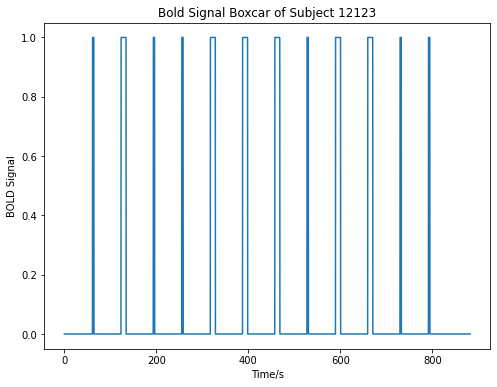

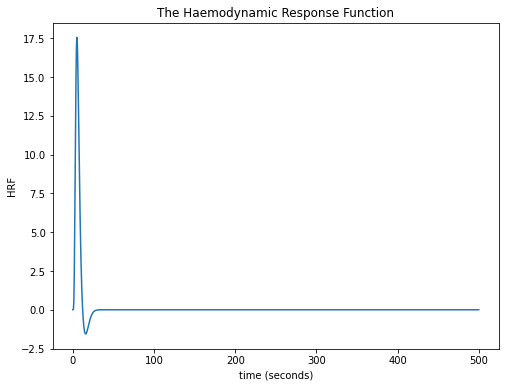

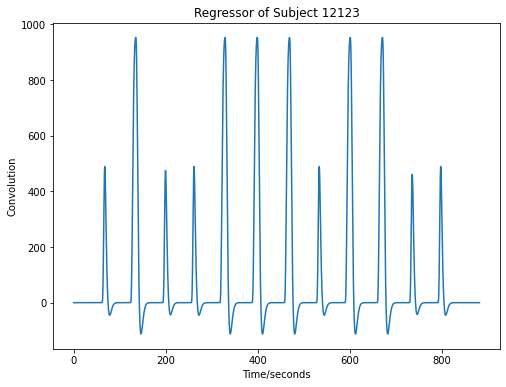

In [4]:
#%%
import scipy.io as sio
import matplotlib.pyplot as plt 
import numpy as np
from scipy.special import gamma, factorial
import nibabel

#Loads in the required .mat files in python
onset = sio.loadmat("Python Code\\run1_BOLD_EMG_onset.mat")
durations = sio.loadmat("Python Code\\run1_durations.mat")

#control testing to show the actual values and types of data that are worked with
print(f"""
Duration is: {durations} of type {type(durations)}
Onset is: {onset} of type {type(onset)}
Durations specifically: {durations["move_dur"]}
Onset specifically: {onset["bold"]}
""")


#calls keys of dictionaries to get np array 
onset_data = onset["bold"][0]
duration_data = durations["move_dur"][0]

#setting lists and arrays for coordinates
dynamics = 294
TR = 3
x = np.arange(0,dynamics*TR,0.1)
y = []
j = 0

# loop to create the y values for boxcar
for i in range(len(x)): 
    if x[i] >= onset_data[j] and x[i] <= onset_data[j]+duration_data[j]:
        y.append(1)
        
    elif  x[i] > onset_data[j]+duration_data[j] and j != len(onset_data)-1: 
        y.append(0)
        j +=1
    else: 
        y.append(0)

#plotting figures of x and y for boxcar
plt.figure(figsize=(8,6))
plt.title("Bold Signal Boxcar of Subject 12123")
plt.ylabel("BOLD Signal")
plt.xlabel("Time/s")
plt.plot(x,y)


#plotting a hrf 
t= np.arange(0,500.1,0.1)
A=100
a1=6
a2=16
b1=1
b2=1
c=1/6
Ta1=gamma(6)
Ta2=gamma(16)
x1=(t**(a1-1)*(b2**a1)*(np.exp(-b1*t)))/Ta1
y1= (t**(a2-1)*(b2**a2)*(np.exp(-b2*t)))/Ta2

h = A*(x1-(y1*c))
plt.figure(figsize=(8,6))
plt.plot(t,h)
plt.title('The Haemodynamic Response Function') # Give the plot a title
plt.axis() # show axis
plt.xlabel("time (seconds)") #label for x axis
plt.ylabel("HRF") #label for y axis


#convolution plot with same parameter in order to get the same number of output as inputted largest no. of data points array.
conv = np.convolve(y,h)
plt.figure(figsize=(8,6))
plt.title("Regressor of Subject 12123")
plt.xlabel("Time/seconds")
plt.ylabel("Convolution")
plt.plot(x,conv[0:len(x)])
plt.show()


#%%

The regressor now looks to be correct, as it has a the same number of peaks as expected which is the same as the boxcar signals (12). The number of returned data points for the convolution was more than the number of data points that were inserted, this is due to the function giving n+m-1 data points back, where n and m is the number of data points of the 2 convoluted arrays. This should not be negatively impacting to the data (i.e no loss of data), as the convolution should be 0s after the 12th peak. 

The code that was produced to give the post-stimulus undershoot only is also run again with the new updated variables in order to attain the correct graph. The code is using the "same" argument of the np.convovle function and this is again changed as this is giving the overlap of a specific region rather than the whole. As with the above correction, the output will be sliced to get the correct dimensions and no data loss should occur as per same reasoning. 

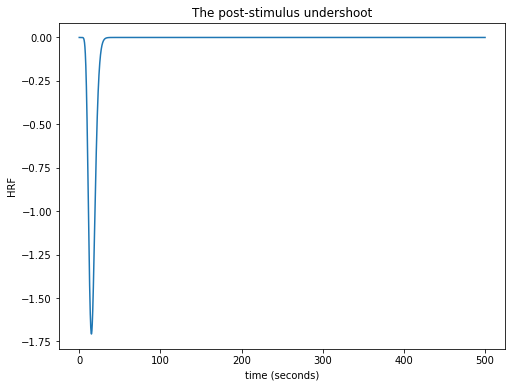

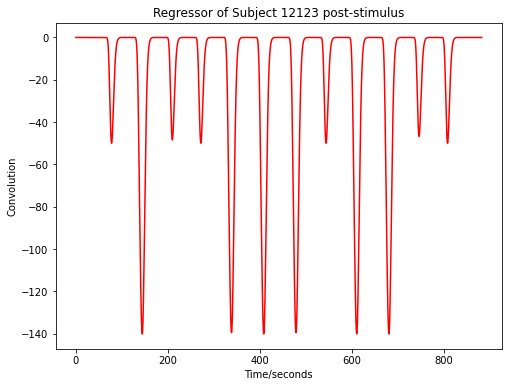

In [5]:
psu = A*(-y1*c)
plt.figure(figsize=(8,6))
plt.plot(t,psu)
plt.title('The post-stimulus undershoot') # Give the plot a title
plt.axis() # show axis
plt.xlabel("time (seconds)") #label for x axis
plt.ylabel("HRF") #label for y axis

#convolution plot with same parameter in order to get the same number of output as inputted largest no. of data points array.
conv2 = np.convolve(y,psu)
plt.figure(figsize=(8,6))
plt.title("Regressor of Subject 12123 post-stimulus")
plt.xlabel("Time/seconds")
plt.ylabel("Convolution")
plt.plot(x,conv2[0:len(x)],"r")
plt.show()

The regressor looks more correct this time, as there are the same number of peaks as expected (12) just like the boxcar number of peaks.The standard HRF has an overshoot and undershoot for each BOLD singal response, so were the same to be done to the overshoot 12 would also be present. However, the main interest of the project is in the undershoot. 

#### Wednesday 2nd March 

The above sample code of the hrf and regressor have time ranges and frequency that is different to the actual experimental data, where total number of data points should be 294 with a frequency of 3 seconds. This will need to be ammended in order to make a correlation comparison for the data from slice. 


Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[ 2.9762, 10.9844,  2.965 ,  3.    , 10.8586, 10.9822, 10.8824,
         2.9922, 10.973 , 11.    ,  2.7812,  2.9988]])} of type <class 'dict'>
Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
Durations specifically: [[ 2.9762 10.9844  2.965   3.     10.8586 10.9822 10.8824  2.9922 10.973
  11.      2.7812  2.9988]]
Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791.17921721]]



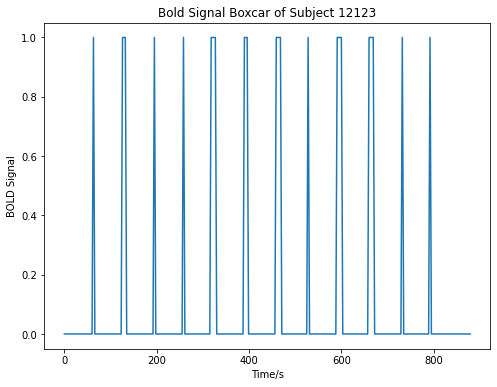

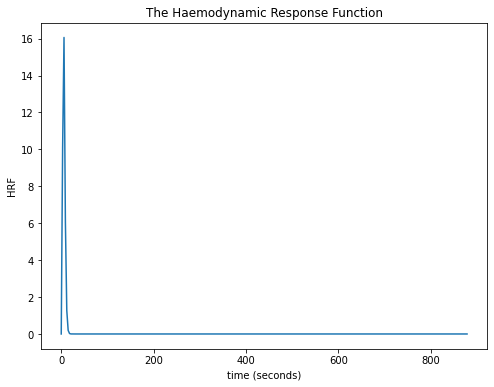

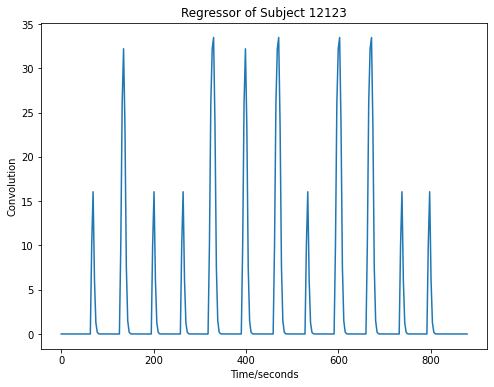

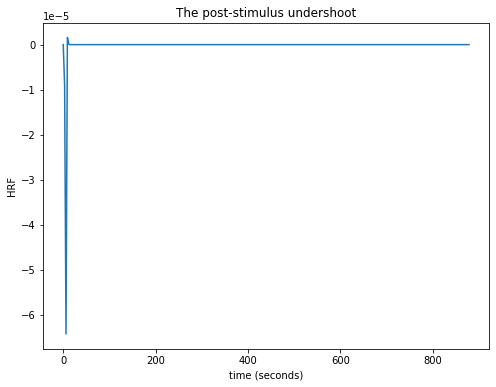

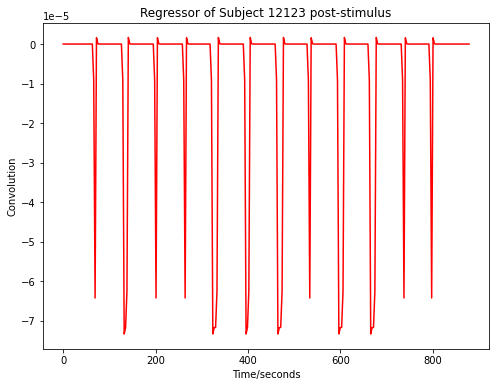

In [6]:
#%%
import scipy.io as sio
import matplotlib.pyplot as plt 
import numpy as np
from scipy.special import gamma, factorial
import nibabel

#Loads in the required .mat files in python
onset = sio.loadmat("Python Code\\run1_BOLD_EMG_onset.mat")
durations = sio.loadmat("Python Code\\run1_durations.mat")

#control testing to show the actual values and types of data that are worked with
print(f"""
Duration is: {durations} of type {type(durations)}
Onset is: {onset} of type {type(onset)}
Durations specifically: {durations["move_dur"]}
Onset specifically: {onset["bold"]}
""")


#calls keys of dictionaries to get np array 
onset_data = onset["bold"][0]
duration_data = durations["move_dur"][0]

#setting lists and arrays for coordinates
dynamics = 294
TR = 3
x = np.arange(0,dynamics*TR,TR)
y = []
j = 0

# loop to create the y values for boxcar
for i in range(len(x)): 
    if x[i] >= onset_data[j] and x[i] <= onset_data[j]+duration_data[j]:
        y.append(1)
        
    elif  x[i] > onset_data[j]+duration_data[j] and j != len(onset_data)-1: 
        y.append(0)
        j +=1
    else: 
        y.append(0)

#plotting figures of x and y for boxcar
plt.figure(figsize=(8,6))
plt.title("Bold Signal Boxcar of Subject 12123")
plt.ylabel("BOLD Signal")
plt.xlabel("Time/s")
plt.plot(x,y)


#plotting a hrf 
t= x
A=100
a1=6
a2=16
b1=1
b2=1
c=1/6
Ta1=gamma(6)
Ta2=gamma(16)
x1=(t**(a1-1)*(b2**a1)*(np.exp(-b1*t)))/Ta1
y1= (t**(a2-1)*(b2**a2)*(np.exp(-b2*t)))/Ta2

h = A*(x1-(y1*c))
plt.figure(figsize=(8,6))
plt.plot(t,h)
plt.title('The Haemodynamic Response Function') # Give the plot a title
plt.axis() # show axis
plt.xlabel("time (seconds)") #label for x axis
plt.ylabel("HRF") #label for y axis


#convolution plot with same parameter in order to get the same number of output as inputted largest no. of data points array.
conv = np.convolve(y,h)
plt.figure(figsize=(8,6))
plt.title("Regressor of Subject 12123")
plt.xlabel("Time/seconds")
plt.ylabel("Convolution")
plt.plot(x,conv[0:len(x)])


psu = A*(-y1*c)
plt.figure(figsize=(8,6))
plt.plot(t,psu)
plt.title('The post-stimulus undershoot') # Give the plot a title
plt.axis() # show axis
plt.xlabel("time (seconds)") #label for x axis
plt.ylabel("HRF") #label for y axis

#convolution plot with same parameter in order to get the same number of output as inputted largest no. of data points array.
conv2 = np.convolve(y,psu)
plt.figure(figsize=(8,6))
plt.title("Regressor of Subject 12123 post-stimulus")
plt.xlabel("Time/seconds")
plt.ylabel("Convolution")
plt.plot(x,conv2[0:len(x)],"r")
plt.show()


#%%

The resulting graphs show a decrease in smoothness, which is to be expected as the frequency of data being plotted is now more sparse. The undershoot appears to be less pronounced for the double gamma function, and the graph of the post-stimulus undershoot actually appears to show a small peak. 

Now that we have succesfully coded for the regressor, we must now turn to producing an image of the subjects brain which will later be correlated with the regressor. MRI data can be read using the nibabel package. It's very comprehensive and can cope with numerous medical imaging files. As well as reading in the array of voxels, it can also deal with header and affine information and comes with some useful tools to manipulate data. Subject 12123 had an EPI (echo planar imaging) scan, through 12 slices of their brain. the data collected was read into python using nibabel and an image was created.


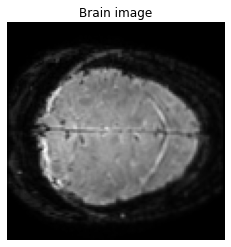

The voxels of this image are 1.4 x 1.4 x 1.5 mm


In [7]:
import nibabel as nib # We'll call nibabel nib for short as we'll be calling it lots
from nibabel.processing import resample_from_to 
import matplotlib.pyplot as plt 
import scipy.io as sio
import os
from nibabel.testing import data_path
# Now we're going to import an anatomical image of the brain. The `epi_img` variable contains all the information relevant to this nifti image, things like its voxels array, its affine transform and its voxel sizes are all stored here.

epi_img = nib.load("flirts\\flirt_BOLD_TS_12123_r1.nii") # Import the data. 
epi_voxels = epi_img.get_fdata() # Get a 3D array of voxels

plt.imshow(epi_voxels[:, :, epi_voxels.shape[2]//2, 1], cmap='gray') # Show the central axial slice
plt.title('Brain image') # Give the plot a title
plt.axis(False) # Turn off the axis
plt.show() # Show the plot

epi_hdr = epi_img.header # Get the images header
zoom = epi_hdr.get_zooms()
print('The voxels of this image are {0:.1f} x {1:.1f} x {2:.1f} mm'.format(*zoom)) # Print the size of each voxel to the console

epi_affine = epi_img.affine # We'll need this to save any output data. It tells us the mapping between the voxel space and scanner space


we then went on to code for a subplot that showed all 12 slices of the brain at the same time. When dealing with crowded subplots you have to be cautious of overlapping axis, correct ratios etc. this is shown below in my first attempt to plot and then my refined version.

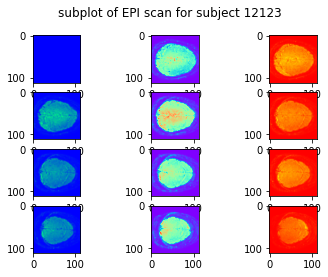

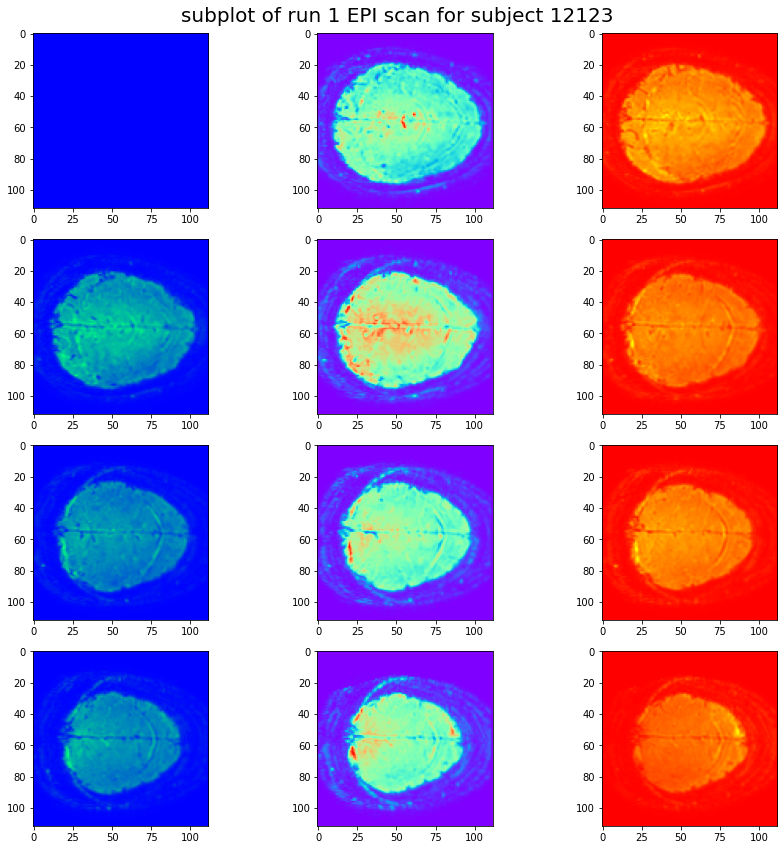

In [8]:
f, axarr = plt.subplots(4,3)
plt.suptitle('subplot of EPI scan for subject 12123')
axarr[0,0].imshow(epi_voxels[:, :, 0, 0], cmap='winter') #plotting subplot of 12 slices of the brain
axarr[0,1].imshow(epi_voxels[:, :, 1, 0], cmap='rainbow')
axarr[0,2].imshow(epi_voxels[:, :, 2, 0], cmap='autumn')
axarr[1,0].imshow(epi_voxels[:, :, 3, 0], cmap='winter')
axarr[1,1].imshow(epi_voxels[:, :, 4, 0], cmap='rainbow')
axarr[1,2].imshow(epi_voxels[:, :, 5, 0], cmap='autumn')
axarr[2,0].imshow(epi_voxels[:, :, 6, 0], cmap='winter')
axarr[2,1].imshow(epi_voxels[:, :, 7, 0], cmap='rainbow')
axarr[2,2].imshow(epi_voxels[:, :, 8, 0], cmap='autumn')
axarr[3,0].imshow(epi_voxels[:, :, 9, 0], cmap='winter')
axarr[3,1].imshow(epi_voxels[:, :, 10, 0], cmap='rainbow')
axarr[3,2].imshow(epi_voxels[:, :, 11, 0], cmap='autumn')

#refined version to allow spacing between plots
f, axarr = plt.subplots(4,3,figsize=(12,12)) #increasing the whole figure size so details of plots can be seen
f.tight_layout() #altering the layout so there is no overlap
plt.suptitle("subplot of run 1 EPI scan for subject 12123", fontsize= 20)
plt.subplots_adjust(top=0.95)
axarr[0,0].imshow(epi_voxels[:, :, 0, 0], cmap='winter')
axarr[0,1].imshow(epi_voxels[:, :, 1, 0], cmap='rainbow')
axarr[0,2].imshow(epi_voxels[:, :, 2, 0], cmap='autumn')
axarr[1,0].imshow(epi_voxels[:, :, 3, 0], cmap='winter')
axarr[1,1].imshow(epi_voxels[:, :, 4, 0], cmap='rainbow')
axarr[1,2].imshow(epi_voxels[:, :, 5, 0], cmap='autumn')
axarr[2,0].imshow(epi_voxels[:, :, 6, 0], cmap='winter')
axarr[2,1].imshow(epi_voxels[:, :, 7, 0], cmap='rainbow')
axarr[2,2].imshow(epi_voxels[:, :, 8, 0], cmap='autumn')
axarr[3,0].imshow(epi_voxels[:, :, 9, 0], cmap='winter')
axarr[3,1].imshow(epi_voxels[:, :, 10, 0], cmap='rainbow')
axarr[3,2].imshow(epi_voxels[:, :, 11, 0], cmap='autumn')


The epi plots colours were altered to make sure the subplot followed a spatial order from left to right, top to bottom. The colour will now be switched back to gray for each slice. The subplot shows the 12 slices of the brain which are of different spatial regions, these regions then are divided into 294 instances with 3 seconds of spacing (only 0th element or 1st slice shown). The very last image is a sample of a mask being created which will be used to separte the brain signal intensity from the noise coming outisde of the brain. The code has been made in the form of a function so that it may later be called upon for different slices of the brain. From a first glance at the expectation, the mask does appear as expected with the regions outside of the brain, and weaker signals appearing as black and the stronger signals appear as white - clearly making it distinguishable.

Next a general function was made, in order to produce a way of making a mask which outputs 0 (black) for noise (intensity <= 1e+6) and 1 (white) for a signal above the set limit of 1e+6. The limit was chosen by seeing on the interactive python graph, the outlined region of the brain's intensity, which was found to be about 1e+6. 

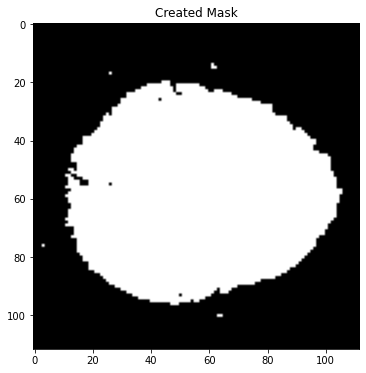

In [9]:
#defining which slice to use and setting limit of intensity 
#example slice 3 or element 2 used
data = epi_voxels[:, :, 2,0]
width = data.shape[0]
height = data.shape[1]
limit = 1e+6
#creating a mask min value of 2*10**5
def make_mask(name,width,height,limit) -> np.array: 
    mask = np.zeros(shape=(width,height))
    for i in range(width):
        for j in range(height):
            if name[i,j] > limit:
                mask[i,j] = 1
            
            else: 
                mask[i,j] = 0
    return mask



mask = make_mask(data,width,height,limit)
plt.figure(figsize=(8,6))
plt.title("Created Mask")

plt.imshow(mask,cmap="gray")
plt.show()



The resulting output is as expected, with mostly white shape of the brain. However, since even in the non-maske version certain regions of the brain were of lesser intensity there are a few black dot within the shape. 

#### Thursday 10th March


The mask function will now be used to find regions of the brain where it is signal and not noise, and thereby producing a signal output for the 112x112 coordinates in the 294 instances. The aim of the code below will be to make areas of the brain show pictorially with colour which regions respond the most correlated to the standard regressor of Subject 12123.  

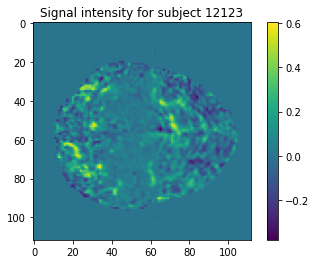

In [10]:
#defining total number of slices, total number of instances and blank matrix for correlation image
total_slices = epi_voxels.shape[2]
num_instances = epi_voxels.shape[3]
cc_image = np.zeros(shape=(width,height,total_slices))
regressor_list = conv[0:len(t)]
signal_list = []

for i in range(width):
    for j in range(height):
        for slice in range(num_instances):
            if mask[i,j] == 1:
                signal = epi_voxels[i,j,2,slice]
                signal_list.append(signal)
        if mask[i,j] == 1:     
            cc = np.corrcoef(signal_list,regressor_list)
            
            cc_image[i,j,2] = cc[0,1]
            #print(cc)
            signal_list = []
                     
plt.imshow(cc_image[:,:,2])
plt.colorbar()
plt.title("Signal intensity for subject 12123")
plt.show()




The output shows certain regions of the brain as being a different colour to blue, a brighter green which sugguests areas of higher correlation. Since outside the brain the region should be not correlated, and it is blue, the colour scheme shows bluish colours are regions that are less correlated - though the choice of colour is arbitrary and the difference is what matters. The colour bar gives a numerical understanding and interpretation for correlation.  

The above was a test code of slice 3 or element 2, and now the rest of the slices will be done using the same. For ease of use, a function will be created to produce the above. 

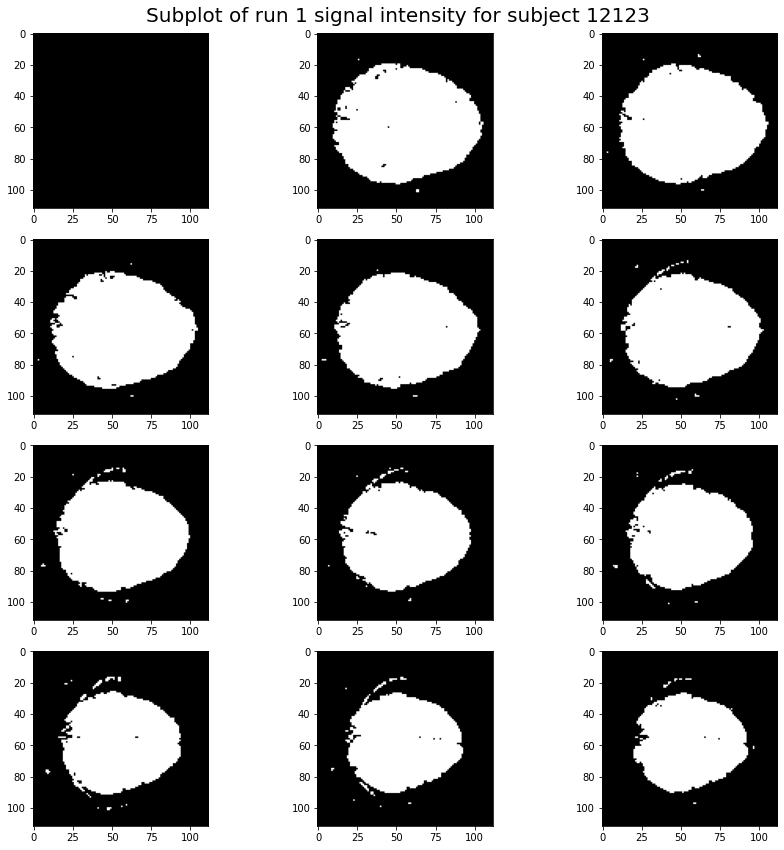

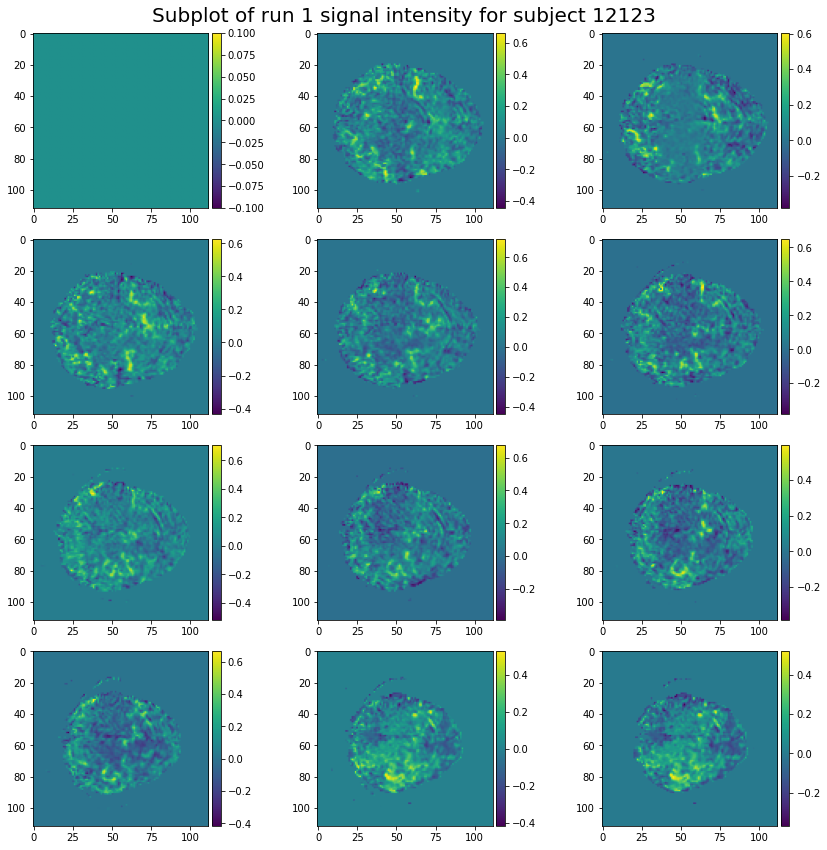

(112, 112, 12)


In [11]:
#calls import to change location of colourbar later
from mpl_toolkits.axes_grid1 import make_axes_locatable
#regressor list from before to do correlation
regressor_list = conv[0:len(t)]

#creating function for making correlation map and masks subplots
def correlation_map(epi_voxels,regressor_list) -> tuple:
    #defining temporary variables for the function such as dimensions and function output lists
    cc_image=np.zeros(shape=(epi_voxels.shape[0],epi_voxels.shape[1],epi_voxels.shape[2]))
    width = epi_voxels.shape[0]
    height = epi_voxels.shape[1]
    num_slice = epi_voxels.shape[2]
    num_instances = epi_voxels.shape[3]
    signal_list = []
    mask_list = []
  
    #first loop over the number of total slices, 12.
    for s in range(num_slice):
        #limit is bigger for 0-10 elements as intensity is higher
        if s < 11:
            data = epi_voxels[:, :, s,0]
            limit = 1e+6
        #limit lower for 11th element as intensity is lower           
        else:
            data = epi_voxels[:, :, s,0]
            limit = 1e+5
        #calls previously created mask function and appends
        mask = make_mask(data,width,height,limit)
        mask_list.append(mask)
        #nested loop for each of the x,y coordinates and for 294 instances
        for i in range(width):
            for j in range(height):
                for instance in range(num_instances):
                    #filters out noise as only 1 is brain
                    if mask_list[-1][i,j] == 1:
                        signal = epi_voxels[i,j,s,instance]
                        signal_list.append(signal)
                #again filters out noise and correlates to regressor and empties singal list
                if mask_list[-1][i,j] == 1:     
                    cc = np.corrcoef(signal_list,regressor_list)
                    cc_image[i,j,s] = cc[0,1]
                    signal_list = []

    #turns into array so easier to do certain operations for error checking 
    # creates figure to subplot and also dummy variable n to iterate element of 1st dimension of mask_list                
    mask_list = np.array(mask_list)    
    fig,axes = plt.subplots(nrows=4,ncols=3,figsize=(12,12)) 
    fig.tight_layout()
    plt.subplots_adjust(top=0.95)
    n= 0 
    for x in range(4):
        for y in range(3):
            axes[x,y].imshow(mask_list[n,:,:],cmap="gray")
            n+=1
            plt.suptitle("Subplot of run 1 signal intensity for subject 12123", fontsize= 20)
              
    #creates another subplot figure with n varible again to iterate, same concept as before
    fig1,axes1 = plt.subplots(nrows=4,ncols=3,figsize=(12,12)) 
    fig1.tight_layout()                    
    n = 0
    for x in range(4):
        for y in range(3):
            axes1[x,y].imshow(cc_image[:,:,n])
            divider = make_axes_locatable(axes1[x,y])
            cax = divider.append_axes('right', size='5%', pad=0.05)
            fig1.colorbar(axes1[x,y].imshow(cc_image[:,:,n]),cax=cax,orientation='vertical')  
            n = n+1
            plt.suptitle("Subplot of run 1 signal intensity for subject 12123", fontsize= 20)
    plt.subplots_adjust(top=0.95)
    plt.show()
    return mask_list,cc_image

mask_list,cc_image = correlation_map(epi_voxels,regressor_list)
print(cc_image.shape)


<span style="color:green">If you analyse these correlation maps, you can see there is more activation of the BOLD signal on the left hand side of the brain (lower quadrant of the graph). This is because subject 12123 was performing motor activities with their right hand.</span>

#### Saturday 13th March 


The above code outputs a subplot of the masks and correlation maps for each of the slices with colourbars for interpretation. Originally an output of a very blurry correlation map subplot with a lot of noise was shown, and the subplot for the masks was repeated for only 1 of the brain slices 12 times. <span style="color:red">The former had been due to a typo of writing 1e+5 instead of 1e+6 in the threshold limit for s smaller than 11.</span> The mask subplots were coming out as identical superficially on the output, but not in the calculation, because in the iteration the changing variable n had not be written and a plain number was there by mistake. These mistakes have been fixed, and the wrong original outputs are saved as "Mask_Subplots.png" and "Correlation_Map_Subplots.png", and the correct ones are saved as "Mask_Subplots(1).png" and "Correlation_Map_Subplots(1).png". The latest version of the subplots of the masks are saved with the argument cmap = "gray", in order that there may be consistency between the earlier plot on Wednesday 2nd March. 

The code runs through each of the points of the brain that is not noise, and runs through the 294 instances compiling a time series. These 12 slices of the brain will then have 294 time series points for each of their non-noise coordinates. This is correlated with the regressor (convolution of standard HRF with boxcar) and those points are plotted back on the map as a correlation coefficient, this exhibits itself as a colour of correlation or lack thereof. Areas with colours closer to green shows where there is a high correlation with the regressor of the standard HRF and boxcar convolution (brain activation), and areas closer to blue show no correlation and purple shows negative correlation. 

#### Tuesday 15th March 


The next task will require the graphs of the boxcar, hrf, regressor convolution, and post-stimulus response graph to be recreated for the 3 runs of the subject (12123). This is for the purpose of making further masks and correlation maps of the brain, such that an average may be drawn and a clearer correlation might be seen. A test run with the newly generated function will be done for the already received outputs of run1, so that that a comparison of the results may be done. 


Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[ 2.9762, 10.9844,  2.965 ,  3.    , 10.8586, 10.9822, 10.8824,
         2.9922, 10.973 , 11.    ,  2.7812,  2.9988]])} of type <class 'dict'>
Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
Durations specifically: [[ 2.9762 10.9844  2.965   3.     10.8586 10.9822 10.8824  2.9922 10.973
  11.      2.7812  2.9988]]
Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791.17921721]]



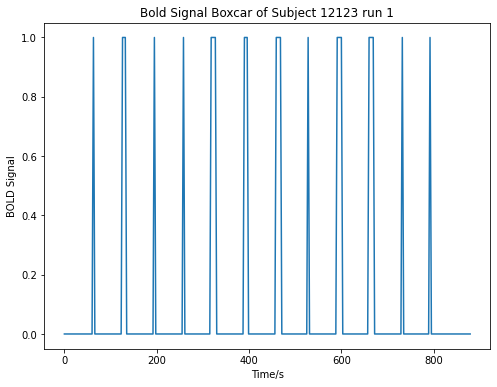

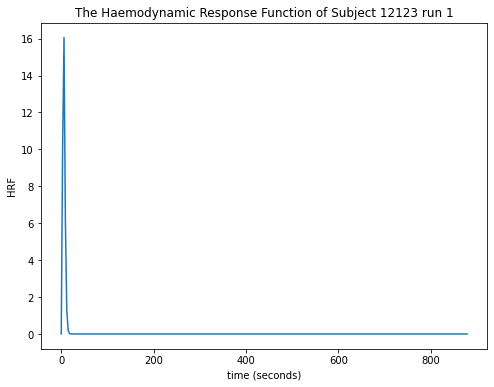

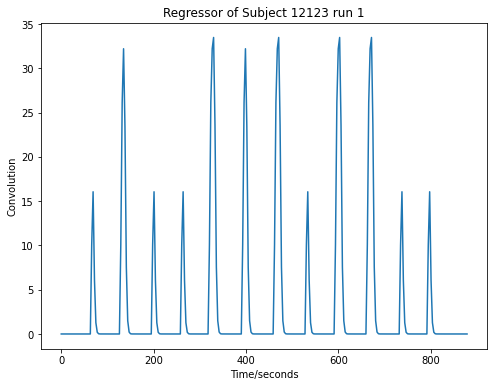

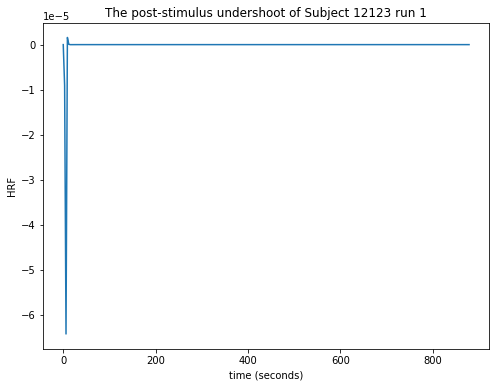

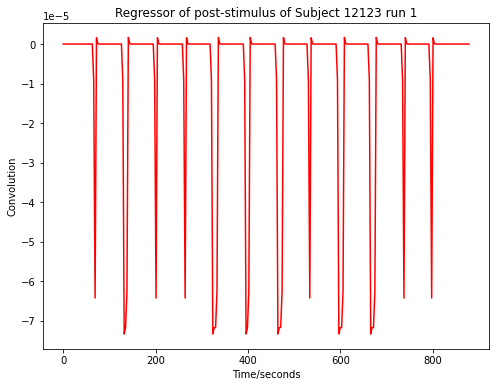

In [12]:
#%%
import scipy.io as sio
import matplotlib.pyplot as plt 
import numpy as np
from scipy.special import gamma, factorial
import nibabel

#Loads in the required .mat files in python
onset = sio.loadmat("Python Code\\run1_BOLD_EMG_onset.mat")
durations = sio.loadmat("Python Code\\run1_durations.mat")

#control testing to show the actual values and types of data that are worked with
print(f"""
Duration is: {durations} of type {type(durations)}
Onset is: {onset} of type {type(onset)}
Durations specifically: {durations["move_dur"]}
Onset specifically: {onset["bold"]}
""")

def box_car(number,onset_data,durations,dynamics=294,TR=3) -> tuple:
    #calls keys of dictionaries to get np array 
    onset_data = onset["bold"][0]
    duration_data = durations["move_dur"][0]

    #setting lists and arrays for coordinates
    dynamics = 294
    TR = 3
    x = np.arange(0,dynamics*TR,TR)
    y = []
    j = 0

    # loop to create the y values for boxcar
    for i in range(len(x)): 
        if x[i] >= onset_data[j] and x[i] <= onset_data[j]+duration_data[j]:
            y.append(1)
            
        elif  x[i] > onset_data[j]+duration_data[j] and j != len(onset_data)-1: 
            y.append(0)
            j +=1
        else: 
            y.append(0)

    """#plotting figures of x and y for boxcar
    plt.figure(figsize=(8,6))
    plt.title("Bold Signal Boxcar of Subject 12123")
    plt.ylabel("BOLD Signal")
    plt.xlabel("Time/s")
    plt.plot(x,y)"""
    
   
    #plotting a hrf 
    t= x
    A=100
    a1=6
    a2=16
    b1=1
    b2=1
    c=1/6
    Ta1=gamma(6)
    Ta2=gamma(16)
    x1=(t**(a1-1)*(b2**a1)*(np.exp(-b1*t)))/Ta1
    y1= (t**(a2-1)*(b2**a2)*(np.exp(-b2*t)))/Ta2

    h = A*(x1-(y1*c))
    
    #plotting figures of x and y for boxcar
    plt.figure(figsize=(8,6))
    plt.title("Bold Signal Boxcar of " +number)
    plt.ylabel("BOLD Signal")
    plt.xlabel("Time/s")
    plt.plot(x,y)
    
    #plotting hrf 
    plt.figure(figsize=(8,6))
    plt.plot(t,h)
    plt.title('The Haemodynamic Response Function of '+ number) # Give the plot a title
    plt.axis() # show axis
    plt.xlabel("time (seconds)") #label for x axis
    plt.ylabel("HRF") #label for y axis


    #convolution plot with same parameter in order to get the same number of output as inputted largest no. of data points array.
    conv = np.convolve(y,h)
    convolution = conv[0:len(x)]
    plt.figure(figsize=(8,6))
    plt.title("Regressor of "+number)
    plt.xlabel("Time/seconds")
    plt.ylabel("Convolution")
    plt.plot(x,convolution)


    psu = A*(-y1*c)
    plt.figure(figsize=(8,6))
    plt.plot(t,psu)
    plt.title('The post-stimulus undershoot of '+ number) # Give the plot a title
    plt.axis() # show axis
    plt.xlabel("time (seconds)") #label for x axis
    plt.ylabel("HRF") #label for y axis

    #convolution plot with same parameter in order to get the same number of output as inputted largest no. of data points array.
    conv2 = np.convolve(y,psu)
    convolution2 = conv2[0:len(x)]
    plt.figure(figsize=(8,6))
    plt.title("Regressor of post-stimulus of " +number)
    plt.xlabel("Time/seconds")
    plt.ylabel("Convolution")
    plt.plot(x,convolution2,"r")
    plt.show()

    return x,y,convolution, convolution2

x1,y1,convolution1,postconv1 = box_car("Subject 12123 run 1",onset,durations)

#%%

The output was as expected, as the values and the graphs look the same as prior before it was turned into a function. Now the next step will be to try the same for run 2 and run 3, however, run 2 seems to be missing some files so run 3 will be computed first. 
***

### run 3 data

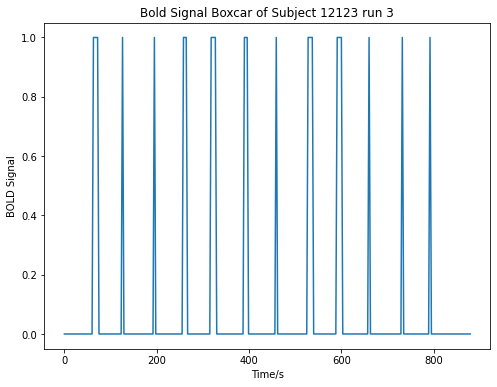

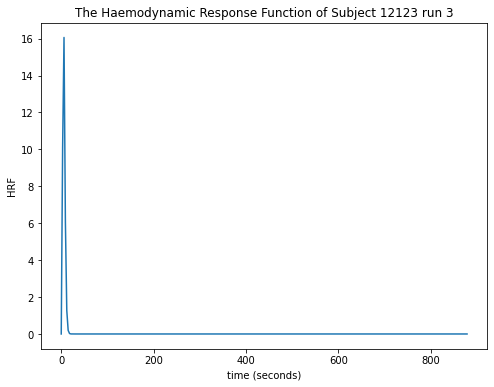

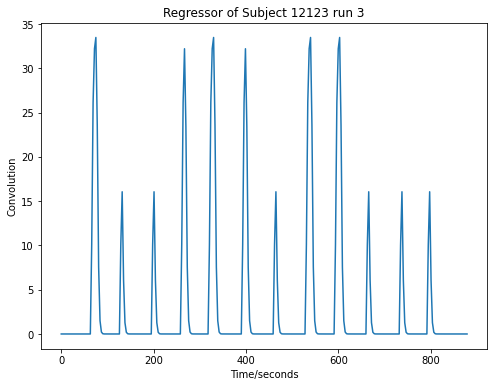

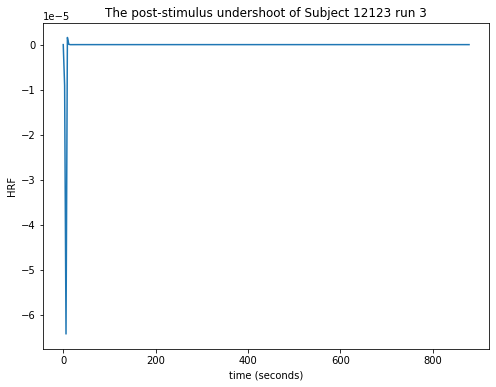

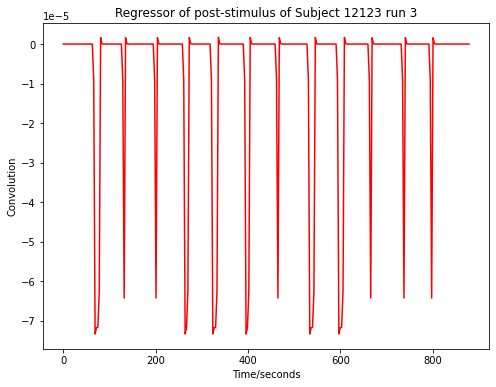

In [13]:
onset3= sio.loadmat("Python Code\\run3_BOLD_EMG_onset_12123")
durations3 = sio.loadmat("Python Code\\run3_durations_12123")
x3,y3,convolution3,postconv3= box_car("Subject 12123 run 3",onset3,durations3)

The output seems to show the correct number of peaks and troughs. For the convolution of the boxcar with the standard hrf (regressor), it showed 12 peaks as expected. For the poststimulus only convolution with the boxcar it showed 12 troughs as expected.

#### Wednesday 16th March

The functions created above will now be called in order to attain masks and correlation maps of the run3. The output signals of run3 will be averaged with that of run3 in order to get a more accurate intensity with less noise, potentially giving a clearer image. A possible barrier will be that the masks of run3 may need to be handled with a different threshold intensity to distinguish between noise and signal. 

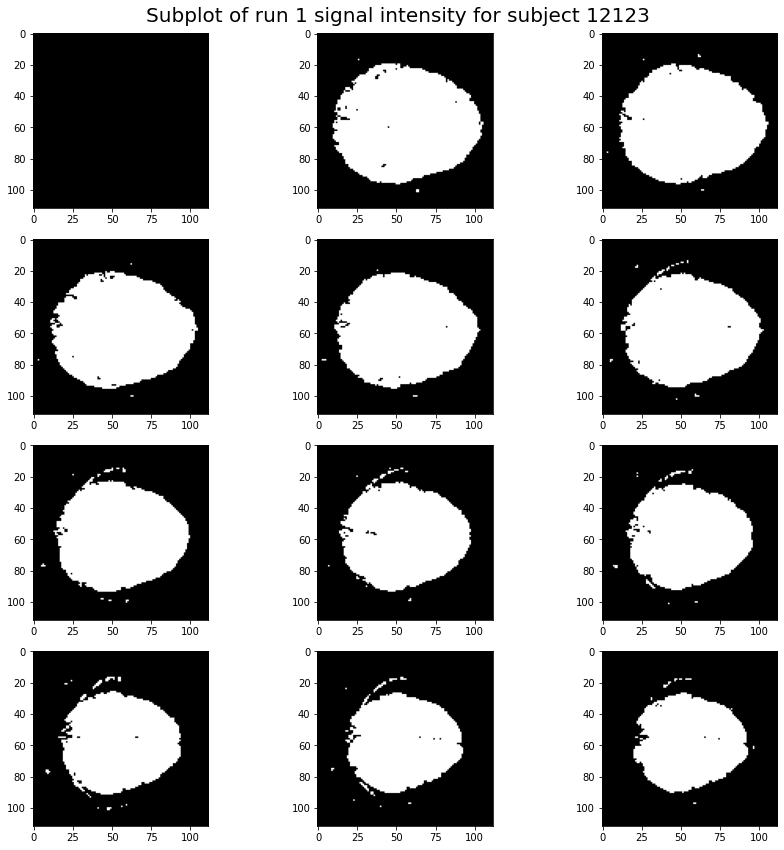

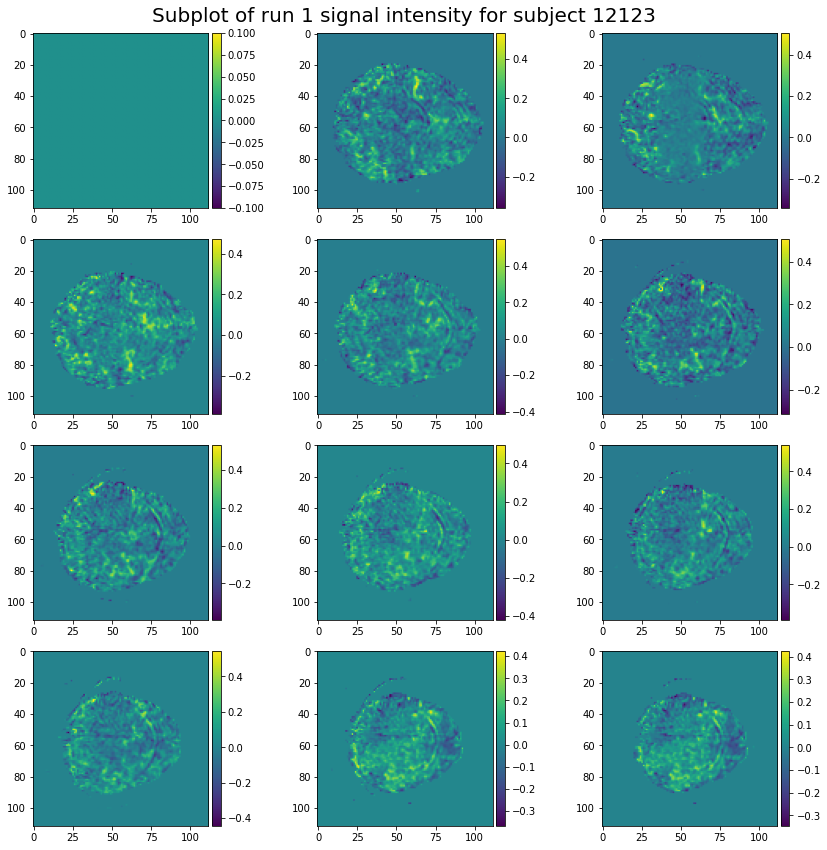

In [14]:
epi_img3 = nib.load("flirts\\flirt_BOLD_TS_12123_r3.nii") # Import the data. 
epi_voxels3 = epi_img.get_fdata() # Get a 3D array of voxels
mask_list3, cc_image3 = correlation_map(epi_voxels3,convolution3)

Upon first impression, the output of the masks seem to be acceptable as it gives the correct general shape which is reflected upon by the correlation map of the different slices. However, there does appear to be regions of black holes in the brain shape which suggest that the threshhold intensity could be too high as well as it would suggest that there was not a strong signal from some regions inside the brain with this mask. 

Next the output signals will be averaged, and a subplot will be created for the correlation map

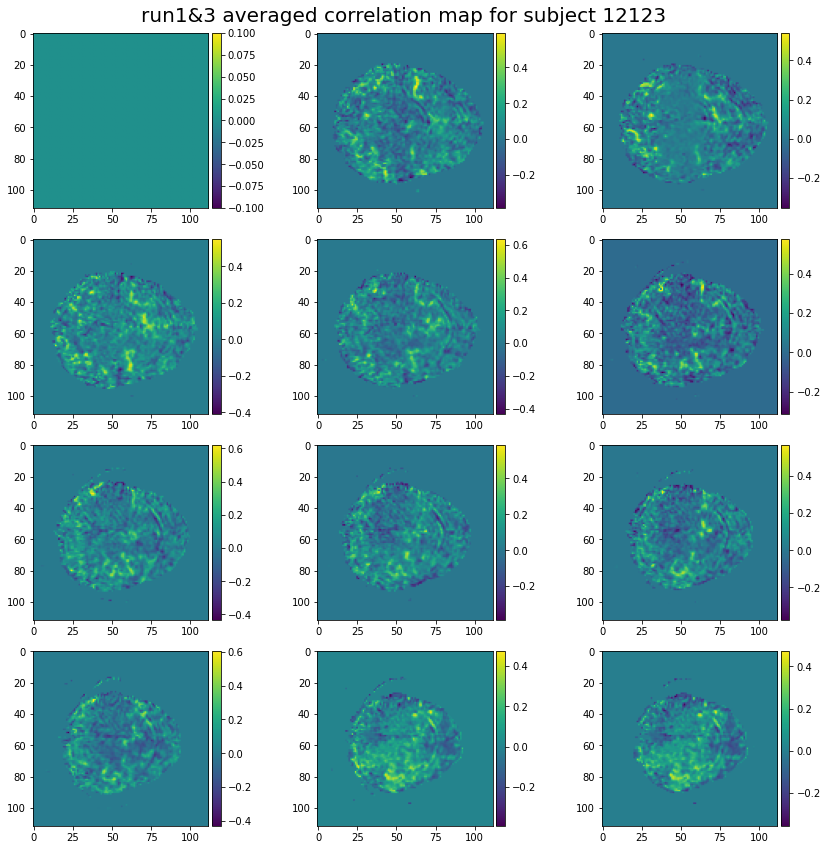

In [15]:
cc_average = (cc_image + cc_image3)/2
def average_plot(title, average):
    fig1,axes1 = plt.subplots(nrows=4,ncols=3,figsize=(12,12)) 
    fig1.tight_layout()                    
    n = 0
    for x in range(4):
        for y in range(3):
            axes1[x,y].imshow(average[:,:,n])
            divider = make_axes_locatable(axes1[x,y])
            cax = divider.append_axes('right', size='5%', pad=0.05)
            fig1.colorbar(axes1[x,y].imshow(average[:,:,n]),cax=cax,orientation='vertical')  
            n = n+1
    plt.suptitle(title, fontsize= 20)
    plt.subplots_adjust(top=0.95)
    plt.show()

average_plot = average_plot("run1&3 averaged correlation map for subject 12123",cc_average)

In [16]:
#checking run1, run3, and averaged of 2 are different in intensity
print(cc_image[60,60])
print(cc_image3[60,60])
print(cc_average[60,60])

[ 0.          0.17598009  0.06491589  0.11375367  0.18282645  0.37222219
  0.11542827  0.14660007 -0.02199567 -0.05124897  0.03801078  0.04515944]
[ 0.          0.0758368   0.04529598  0.07387831  0.12504082  0.22747233
 -0.01769385  0.02407148 -0.0175477  -0.04859672  0.04169924  0.04885107]
[ 0.          0.12590844  0.05510593  0.09381599  0.15393363  0.29984726
  0.04886721  0.08533577 -0.01977169 -0.04992284  0.03985501  0.04700526]


The above output does seem to display a clear region of correlation, and a lacking region of correlation. Certain areas of negative correlation are particularly easier to spot. Short problem testing code has also been implemented to exhibit that run1's intensity, run3's intensity, and hence the average of the 3 are of different values. 

### Thursday 17th March

The graphs for the boxcar, hrf, convolution regressor, post-stimulus graph,and postimulus convolution with box car will need to be redone. There seems to be a problem, as the standard hrf is missing a trough, and the post-stimulus graph has a small peak when it should not. This is likely explained by the changing of sampling rate before the equations are performed. Hence the sampling rate will start off at 0.1 and the operations will take place, then the 30th element will be plotted - as 3 seconds divided by 0.1 seconds is 30.

The following graphs are for run1!

    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[ 2.9762, 10.9844,  2.965 ,  3.    , 10.8586, 10.9822, 10.8824,
         2.9922, 10.973 , 11.    ,  2.7812,  2.9988]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[ 2.9762 10.9844  2.965   3.     10.8586 10.9822 10.8824  2.9922 10.973
  11.      2.7812  2.9988]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.174754

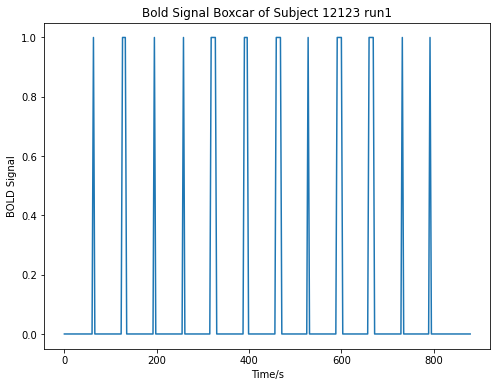

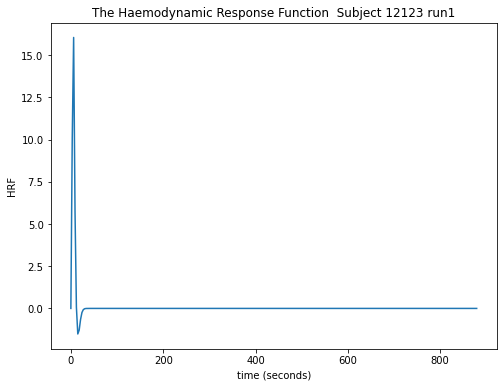

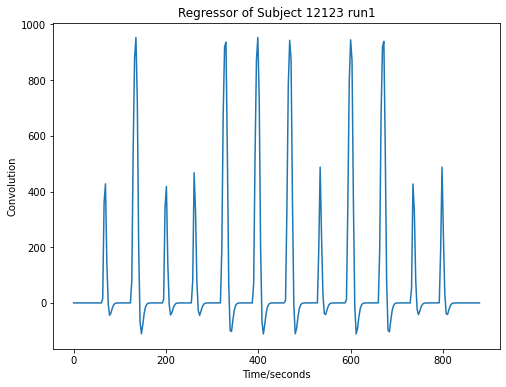

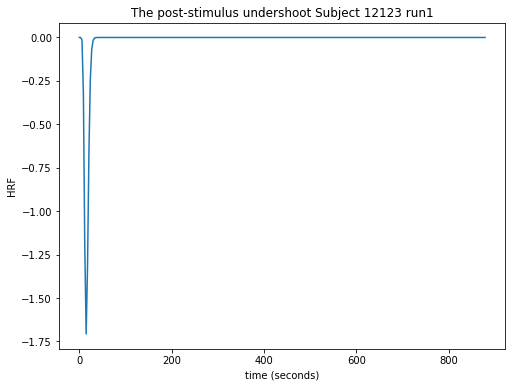

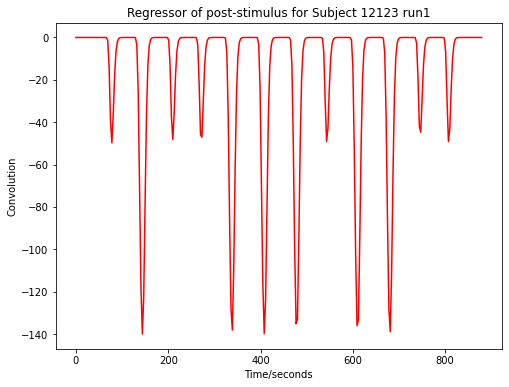

In [17]:
#%%
import scipy.io as sio
import matplotlib.pyplot as plt 
import numpy as np
from scipy.special import gamma, factorial
import nibabel
from nibabel.processing import resample_from_to 

#Loads in the required .mat files in python
onset = sio.loadmat("Python Code\\run1_BOLD_EMG_onset.mat")
durations = sio.loadmat("Python Code\\run1_durations.mat")



def box_car(number,onset,durations,dynamics=294,TR=3) -> tuple:
    #calls keys of dictionaries to get np array 
    onset_data = onset["bold"][0]
    duration_data = durations["move_dur"][0]
    #control testing to show the actual values and types of data that are worked with
    print(f"""
    Duration is: {durations} of type {type(durations)}
    Onset is: {onset} of type {type(onset)}
    Durations specifically: {durations["move_dur"]}
    Onset specifically: {onset["bold"]}
    """)

    #setting lists and arrays for coordinates
    dynamics = 294
    TR = 3
    x = np.arange(0,dynamics*TR,0.1)
    y = []
    j = 0

    # loop to create the y values for boxcar
    for i in range(len(x)): 
        if x[i] >= onset_data[j] and x[i] <= onset_data[j]+duration_data[j]:
            y.append(1)
            
        elif  x[i] > onset_data[j]+duration_data[j] and j != len(onset_data)-1: 
            y.append(0)
            j +=1
        else: 
            y.append(0)

    """#plotting figures of x and y for boxcar
    plt.figure(figsize=(8,6))
    plt.title("Bold Signal Boxcar of Subject 12123")
    plt.ylabel("BOLD Signal")
    plt.xlabel("Time/s")
    plt.plot(x,y)"""
    
   
    #plotting a hrf 
    t= x
    A=100
    a1=6
    a2=16
    b1=1
    b2=1
    c=1/6
    Ta1=gamma(6)
    Ta2=gamma(16)
    x1=(t**(a1-1)*(b2**a1)*(np.exp(-b1*t)))/Ta1
    y1= (t**(a2-1)*(b2**a2)*(np.exp(-b2*t)))/Ta2

    h = A*(x1-(y1*c))
    
    #plotting figures of x and y for boxcar
    plt.figure(figsize=(8,6))
    plt.title("Bold Signal Boxcar of " +number)
    plt.ylabel("BOLD Signal")
    plt.xlabel("Time/s")
    plt.plot(x[::30],y[::30])
    
    #plotting hrf 
    plt.figure(figsize=(8,6))
    plt.plot(t[::30],h[::30])
    plt.title('The Haemodynamic Response Function  '+number) # Give the plot a title
    plt.axis() # show axis
    plt.xlabel("time (seconds)") #label for x axis
    plt.ylabel("HRF") #label for y axis


    #convolution plot with same parameter in order to get the same number of output as inputted largest no. of data points array.
    conv = np.convolve(y,h)
    convolution = conv[0:len(x)]
    plt.figure(figsize=(8,6))
    plt.title("Regressor of " +number)
    plt.xlabel("Time/seconds")
    plt.ylabel("Convolution")
    plt.plot(x[::30],convolution[::30])


    psu = A*(-y1*c)
    plt.figure(figsize=(8,6))
    plt.plot(t[::30],psu[::30])
    plt.title('The post-stimulus undershoot '+ number) # Give the plot a title
    plt.axis() # show axis
    plt.xlabel("time (seconds)") #label for x axis
    plt.ylabel("HRF") #label for y axis

    #convolution plot with same parameter in order to get the same number of output as inputted largest no. of data points array.
    conv2 = np.convolve(y,psu)
    convolution2 = conv2[0:len(x)]
    plt.figure(figsize=(8,6))
    plt.title("Regressor of post-stimulus for " +number)
    plt.xlabel("Time/seconds")
    plt.ylabel("Convolution")
    plt.plot(x[::30],convolution2[::30],"r")
    plt.show()

    return x,y,convolution, convolution2

print("The following graphs are for run1!")
x1,y1,convolution1,postconv1 = box_car("Subject 12123 run1",onset,durations)

#%%

The output now appears to be correct, as the standard hrf now includes a peak and a trough and the post-stimulus undershoot only exhibits a trough. Next the same function will be used to generate the same type of graphs for the run 3 of subject 12123


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:15:19 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[10.9986,  2.9722,  2.8046, 11.    , 10.9698, 10.9288,  2.9516,
        10.9976, 10.9922,  2.9852,  2.9916,  2.8786]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:15:19 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.0286837 , 131.07734087, 193.25990993, 255.07344807,
        325.1142438 , 395.094763  , 465.14763253, 527.11685325,
        597.13290496, 667.14731513, 729.14470817, 791.24725021]])} of type <class 'dict'>
    Durations specifically: [[10.9986  2.9722  2.8046 11.     10.9698 10.9288  2.9516 10.9976 10.9922
   2.9852  2.9916  2.8786]]
    Onset specifically: [[ 61.0286837  131.07734087 193.25990993 255.07344807 325.1142438
  395.094763   465.14763253 527.11685325 597.13290496 667.14731513
  729.14470817 791.

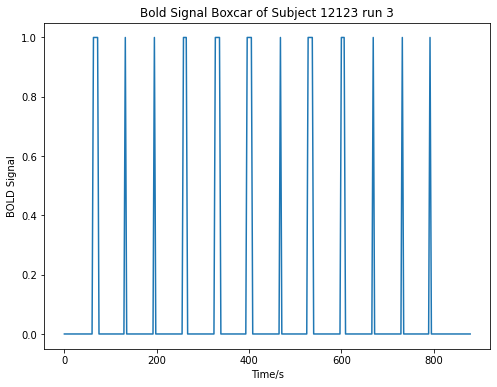

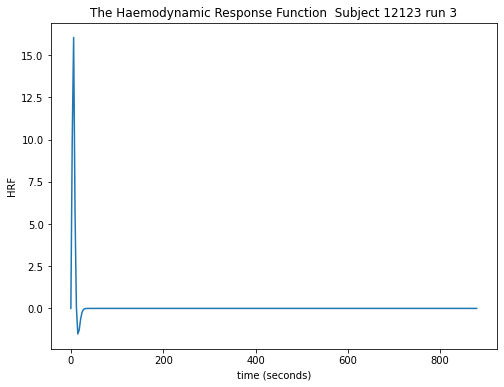

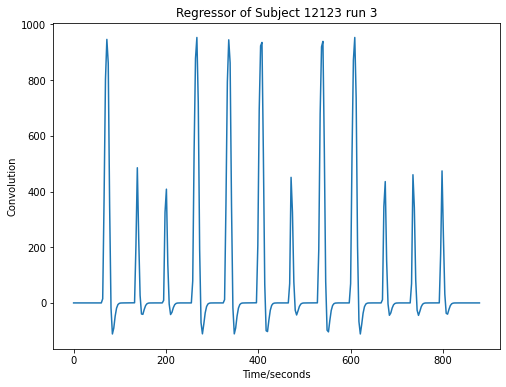

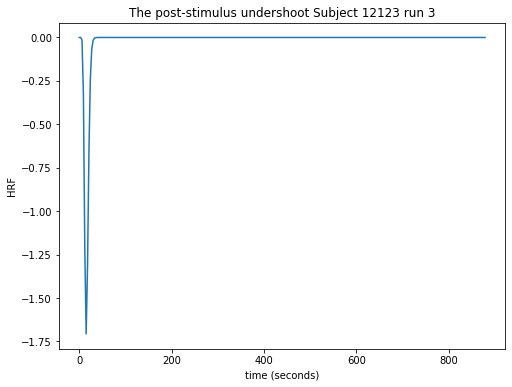

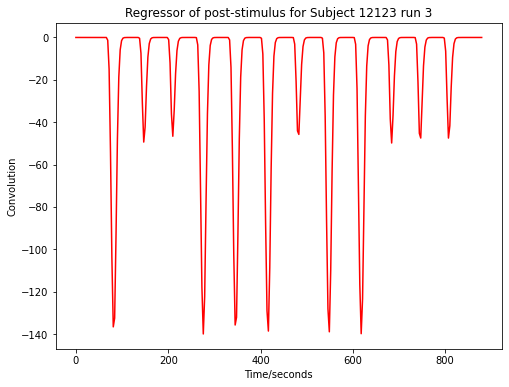

In [18]:
onset3 = sio.loadmat("Python Code\\run3_BOLD_EMG_onset_12123.mat")
durations3 = sio.loadmat("Python Code\\run3_durations_12123.mat")
x3,y3,convolution3,postconv3 = box_car( "Subject 12123 run 3",onset3,durations3)

Again, the output graphs are now including the expected charateristics. Therefore the correlation map subplots should be ran again with these new lists/graphs, otherwise the correlation gathered before hand is superificial to the wrong graphs.

In [19]:
#epi_img3 = nib.load("Subject12123\\flirt_BOLD_TS.nii") # Import the data. 
#epi_voxels3 = epi_img.get_fdata() # Get a 3D array of voxels
#mask_list3, cc_image3 = correlation_map(epi_voxels3,convolution3)

***
### Run 2

The data files for run 2 have now been located, the difficulty in finding it was due to it being under a different named file then the other two. Box car, regressor, mask and correlation map will now be produced for this sample run.


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:15:04 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[10.9846,  2.6864, 10.979 , 10.9446,  2.9726,  2.9874,  2.8542,
        10.615 ,  2.9494,  3.    , 10.7972, 10.856 ]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:15:04 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.05419303, 131.35770647, 193.09618095, 263.1283663 ,
        333.12388616, 395.11804541, 457.26018683, 519.37952822,
        589.16598701, 651.14297356, 713.34295197, 783.30652228]])} of type <class 'dict'>
    Durations specifically: [[10.9846  2.6864 10.979  10.9446  2.9726  2.9874  2.8542 10.615   2.9494
   3.     10.7972 10.856 ]]
    Onset specifically: [[ 61.05419303 131.35770647 193.09618095 263.1283663  333.12388616
  395.11804541 457.26018683 519.37952822 589.16598701 651.14297356
  713.34295197 783

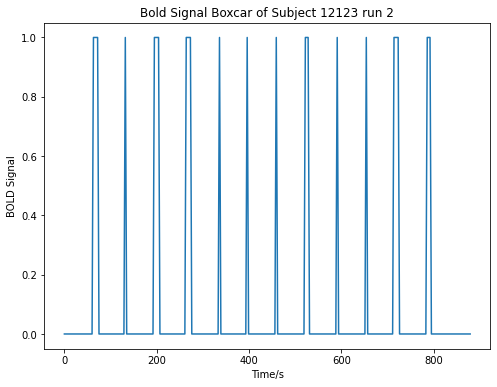

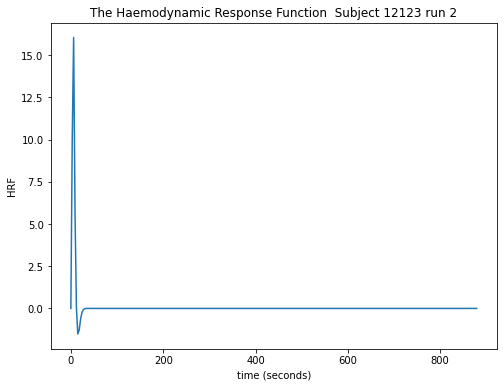

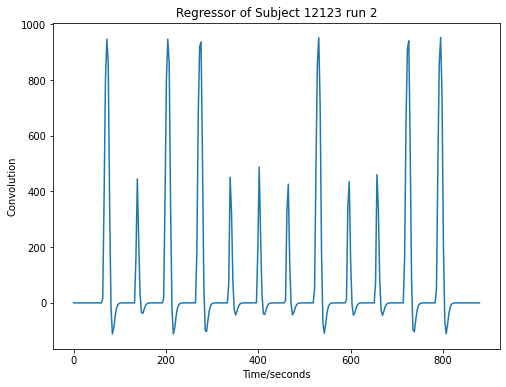

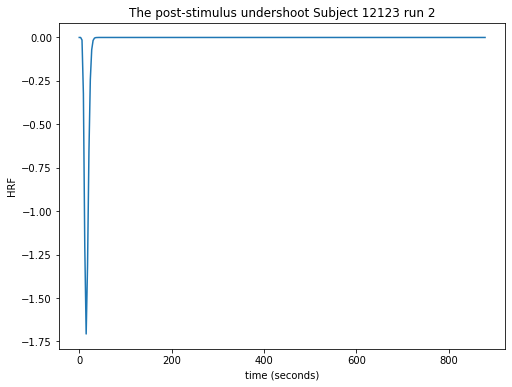

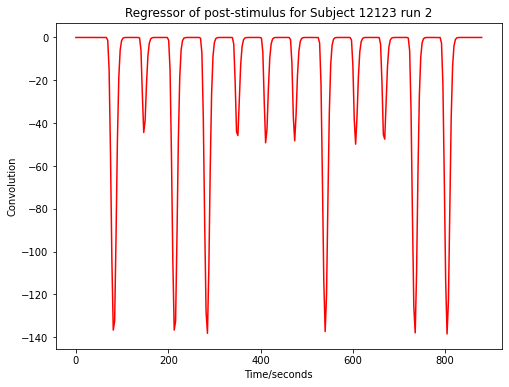

In [20]:
onset2= sio.loadmat("Subject12123\\run2_BOLD_EMG_onset_12123")
durations2 = sio.loadmat("Subject12123\\run2_durations_12123")
x2,y2,convolution2,postconv2= box_car("Subject 12123 run 2",onset2,durations2)

And now the correlation map

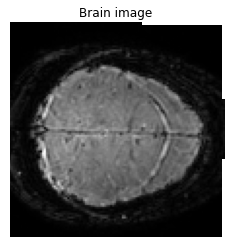

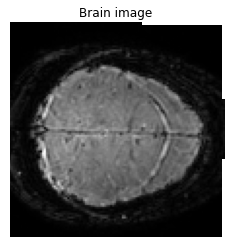

The voxels of this image are 1.4 x 1.4 x 1.5 mm


In [21]:
import nibabel as nib # We'll call nibabel nib for short as we'll be calling it lots
from nibabel.processing import resample_from_to 
import matplotlib.pyplot as plt 
import scipy.io as sio
import os
from nibabel.testing import data_path
# Now we're going to import an anatomical image of the brain. The `epi_img` variable contains all the information relevant to this nifti image, things like its voxels array, its affine transform and its voxel sizes are all stored here.

epi_img2 = nib.load("flirts\\realign_interleaved_BOLD_TS_12123.hdr") # Import the data. 
epi_voxels2 = epi_img2.get_fdata() # Get a 3D array of voxels

plt.imshow(epi_voxels2[:, :, epi_voxels2.shape[2]//2, 1], cmap='gray') # Show the central axial slice
plt.title('Brain image') # Give the plot a title
plt.axis(False) # Turn off the axis
plt.show() # Show the plot

epi_img2 = nib.load("flirts\\realign_interleaved_BOLD_TS_12123.img") # Import the data. 
epi_voxels2 = epi_img2.get_fdata() # Get a 3D array of voxels

plt.imshow(epi_voxels2[:, :, epi_voxels2.shape[2]//2, 1], cmap='gray') # Show the central axial slice
plt.title('Brain image') # Give the plot a title
plt.axis(False) # Turn off the axis
plt.show() # Show the plot


epi_hdr = epi_img2.header # Get the images header
zoom = epi_hdr.get_zooms()
print('The voxels of this image are {0:.1f} x {1:.1f} x {2:.1f} mm'.format(*zoom)) # Print the size of each voxel to the console

epi_affine = epi_img2.affine # We'll need this to save any output data. It tells us the mapping between the voxel space and scanner space

#### Thursday 24th March

Now that the hrf and relavent graphs are corrected, the functions of the brain may be called once more to produce a better correlation map. The subplots function will have a new parameter for adding in arugment of subplot title. 

In [22]:
#calls import to change location of colourbar later
from mpl_toolkits.axes_grid1 import make_axes_locatable
#regressor list from before to do correlation
regressor_list = conv[0:len(t)]

#creating function for making correlation map and masks subplots
def correlation_map(title,epi_voxels,regressor_list,I1=1e+6,I2=1e+5) -> tuple:
    #defining temporary variables for the function such as dimensions and function output lists
    cc_image=np.zeros(shape=(epi_voxels.shape[0],epi_voxels.shape[1],epi_voxels.shape[2]))
    width = epi_voxels.shape[0]
    height = epi_voxels.shape[1]
    num_slice = epi_voxels.shape[2]
    num_instances = epi_voxels.shape[3]
    signal_list = []
    mask_list = []
  
    #first loop over the number of total slices, 12.
    for s in range(num_slice):
        #limit is bigger for 0-10 elements as intensity is higher
        if s < 11:
            data = epi_voxels[:, :, s,0]
            limit = I1
        #limit lower for 11th element as intensity is lower           
        else:
            data = epi_voxels[:, :, s,0]
            limit = I2
        #calls previously created mask function and appends
        mask = make_mask(data,width,height,limit)
        mask_list.append(mask)
        #nested loop for each of the x,y coordinates and for 294 instances
        for i in range(width):
            for j in range(height):
                for instance in range(num_instances):
                    #filters out noise as only 1 is brain
                    if mask_list[-1][i,j] == 1:
                        signal = epi_voxels[i,j,s,instance]
                        signal_list.append(signal)
                #again filters out noise and correlates to regressor and empties singal list
                if mask_list[-1][i,j] == 1:     
                    cc = np.corrcoef(signal_list,regressor_list)
                    cc_image[i,j,s] = cc[0,1]
                    signal_list = []

    #turns into array so easier to do certain operations for error checking 
    # creates figure to subplot and also dummy variable n to iterate element of 1st dimension of mask_list                
    mask_list = np.array(mask_list)    
    fig,axes = plt.subplots(nrows=4,ncols=3,figsize=(12,12)) 
    fig.tight_layout()
    plt.subplots_adjust(top=0.95)
    n= 0 
    for x in range(4):
        for y in range(3):
            axes[x,y].imshow(mask_list[n,:,:],cmap="gray")
            n+=1
            plt.suptitle("Mask "+title, fontsize= 20)
              
    #creates another subplot figure with n varible again to iterate, same concept as before
    fig1,axes1 = plt.subplots(nrows=4,ncols=3,figsize=(12,12)) 
    fig1.tight_layout()                    
    n = 0
    for x in range(4):
        for y in range(3):
            axes1[x,y].imshow(cc_image[:,:,n])
            divider = make_axes_locatable(axes1[x,y])
            cax = divider.append_axes('right', size='5%', pad=0.05)
            fig1.colorbar(axes1[x,y].imshow(cc_image[:,:,n]),cax=cax,orientation='vertical')  
            n = n+1
            plt.suptitle("Corelation map" + title, fontsize= 20)
    plt.subplots_adjust(top=0.95)
    plt.show()
    
    return mask_list,cc_image

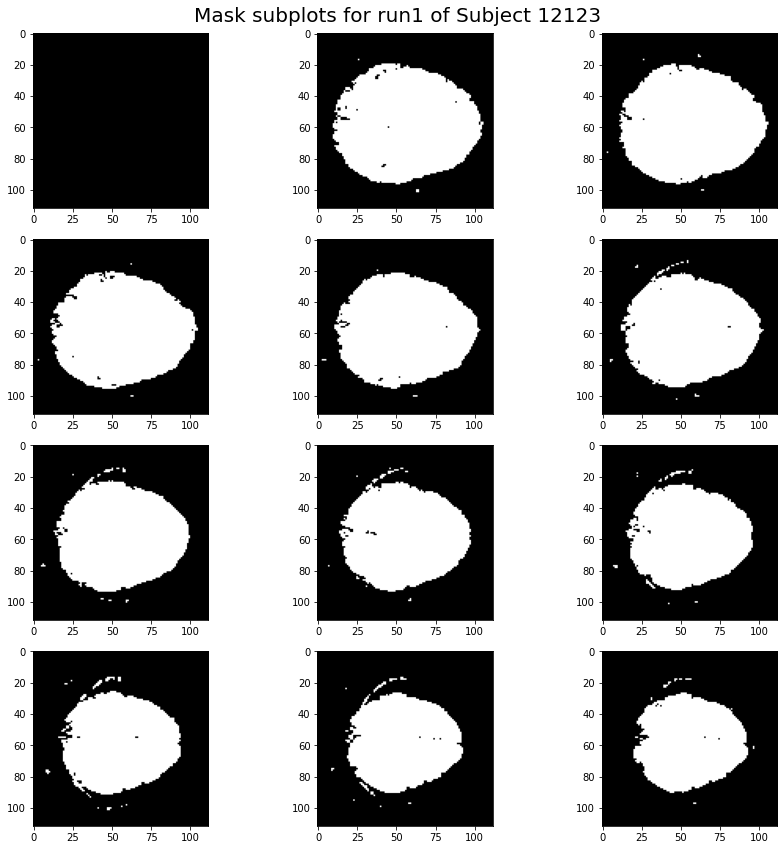

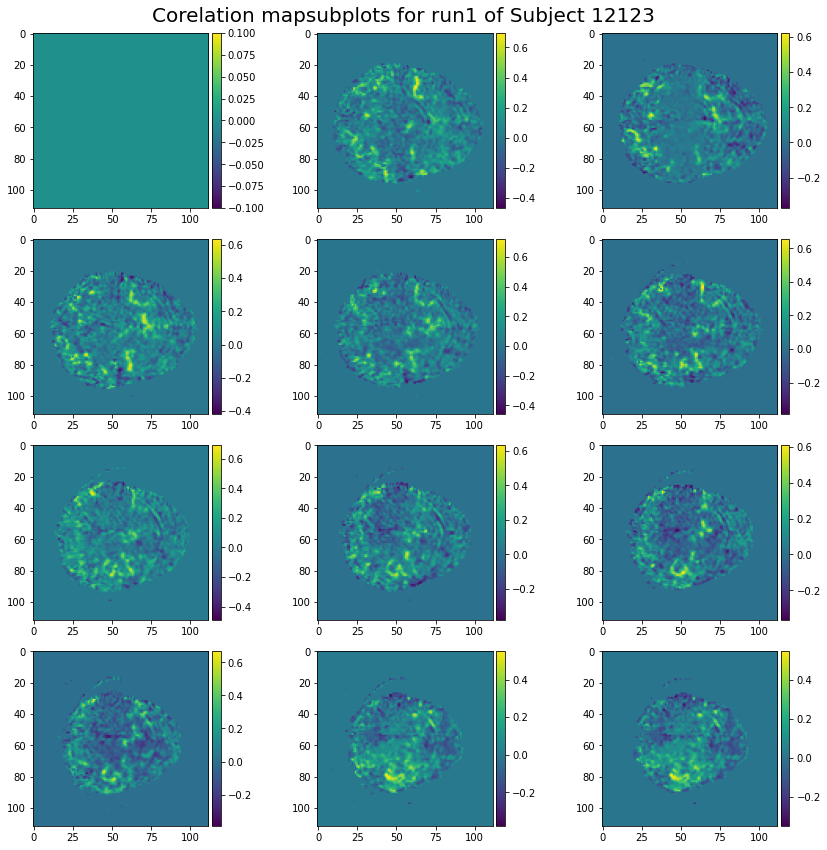

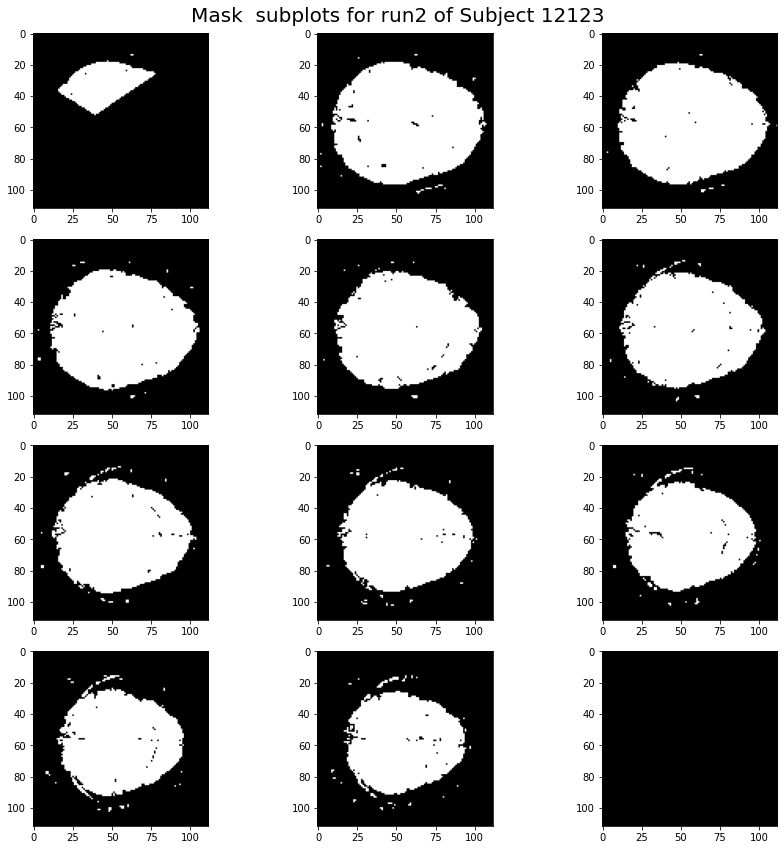

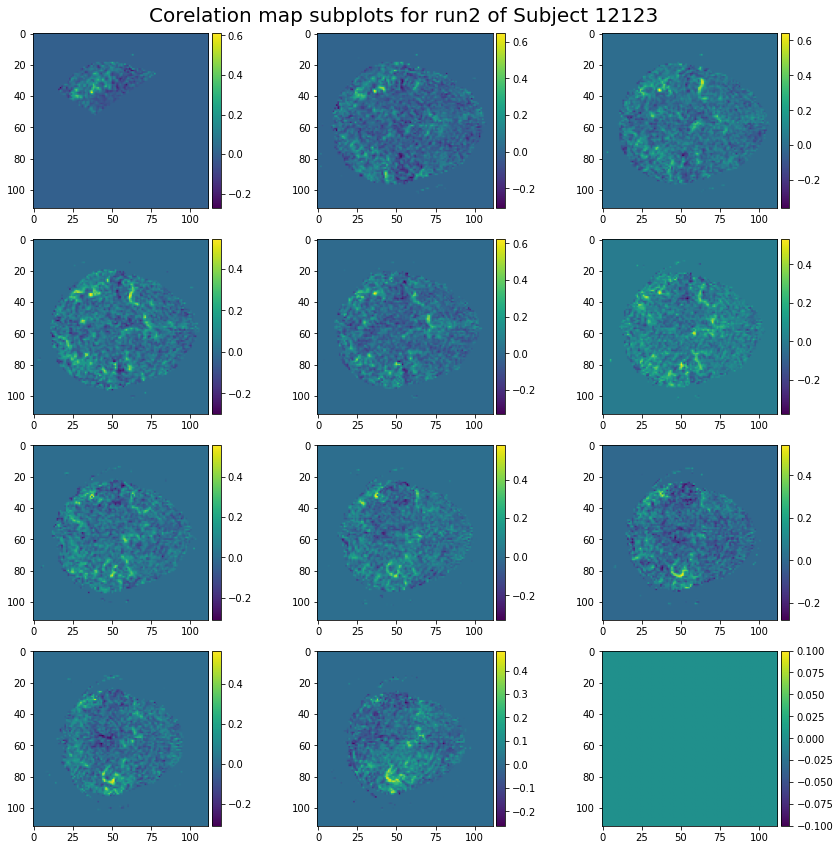

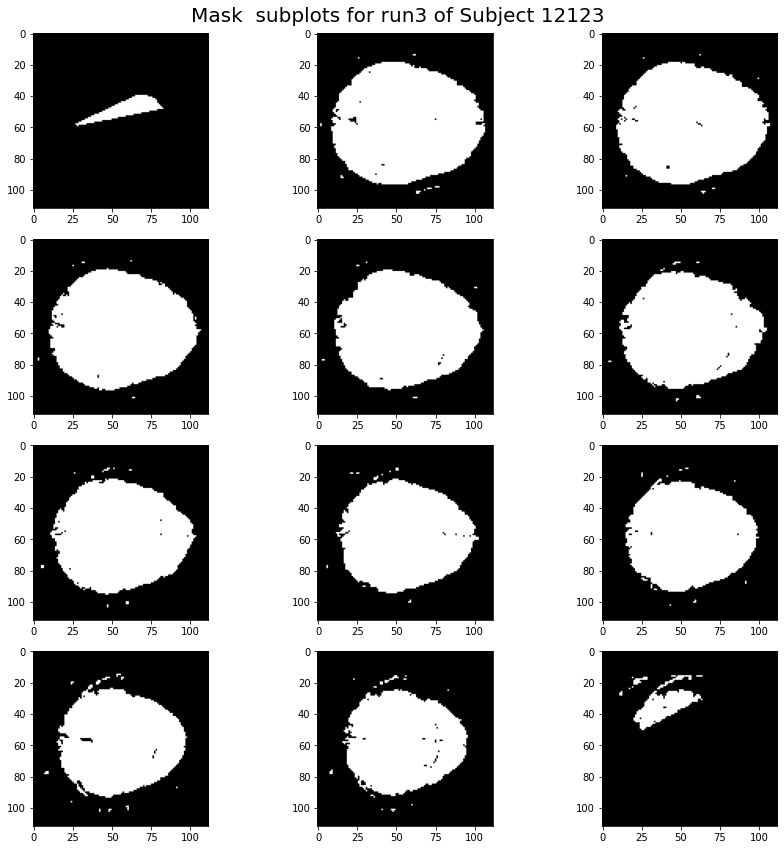

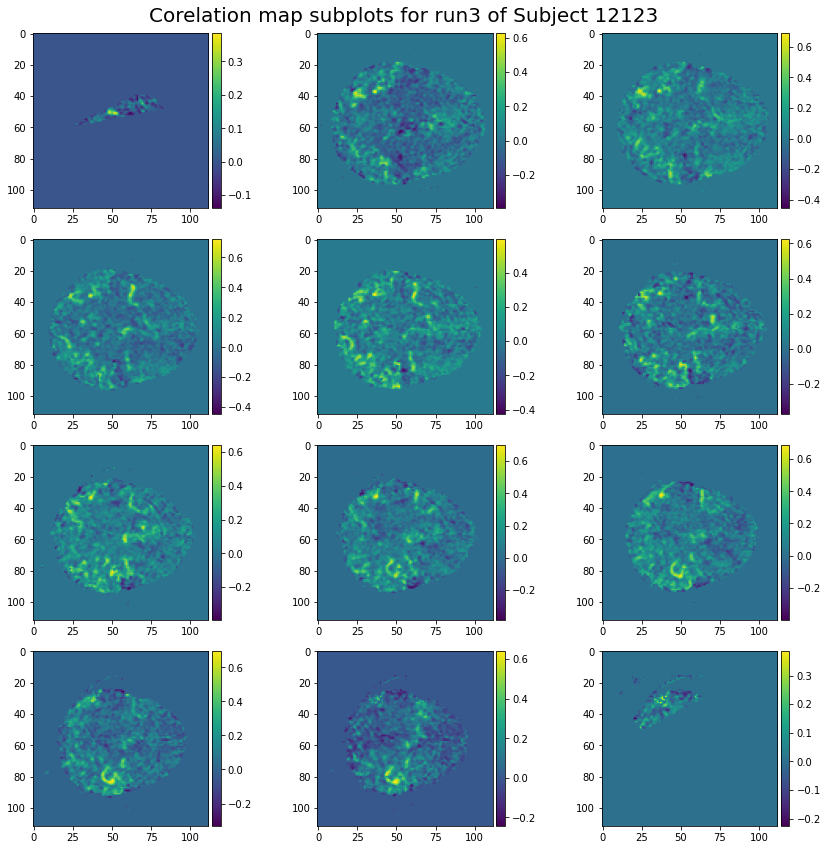

In [23]:
import nibabel as nib # We'll call nibabel nib for short as we'll be calling it lots
from nibabel.processing import resample_from_to 
import matplotlib.pyplot as plt 
import scipy.io as sio
import os
from nibabel.testing import data_path
epi_img1 = nib.load("flirts\\flirt_BOLD_TS_12123_r1.nii") # Import the data. 
epi_voxels1 = epi_img1.get_fdata() # Get a 3D array of voxels
mask_list1, cc_image1 = correlation_map("subplots for run1 of Subject 12123",epi_voxels1,convolution1[::30])
epi_img2 = nib.load("flirts\\realign_interleaved_BOLD_TS_12123.img") # Import the data. 
epi_voxels2 = epi_img2.get_fdata() # Get a 3D array of voxels
mask_list2, cc_image2 = correlation_map(" subplots for run2 of Subject 12123",epi_voxels2,convolution2[::30])
epi_img3 = nib.load("flirts\\flirt_BOLD_TS_12123_r3.nii") # Import the data. 
epi_voxels3 = epi_img3.get_fdata() # Get a 3D array of voxels
mask_list3, cc_image3 = correlation_map(" subplots for run3 of Subject 12123",epi_voxels3,convolution3[::30])


Aswell as the correlation map of the post stimulus response only.

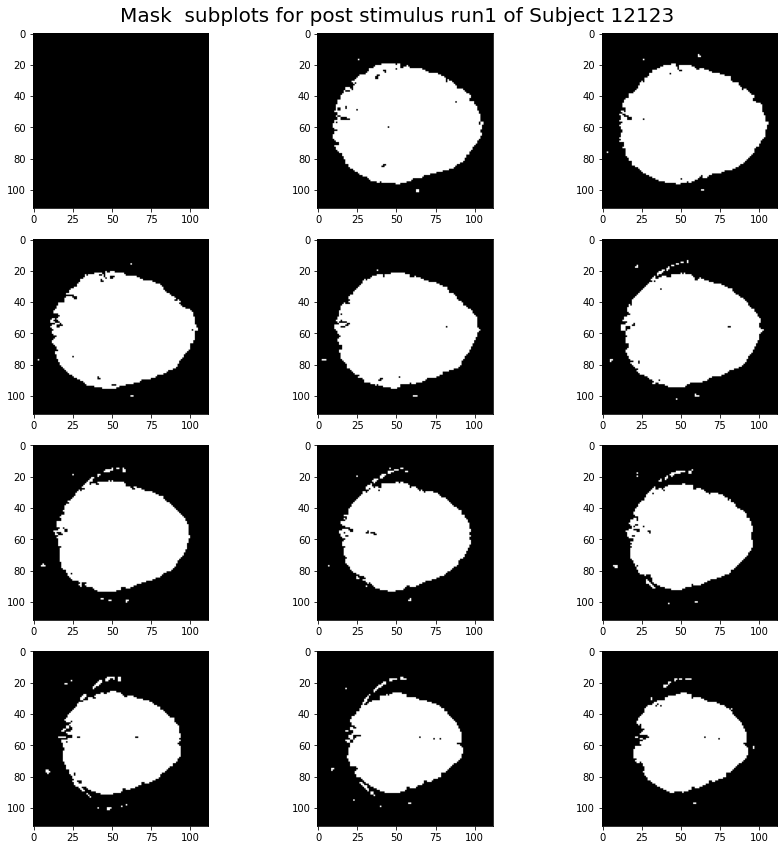

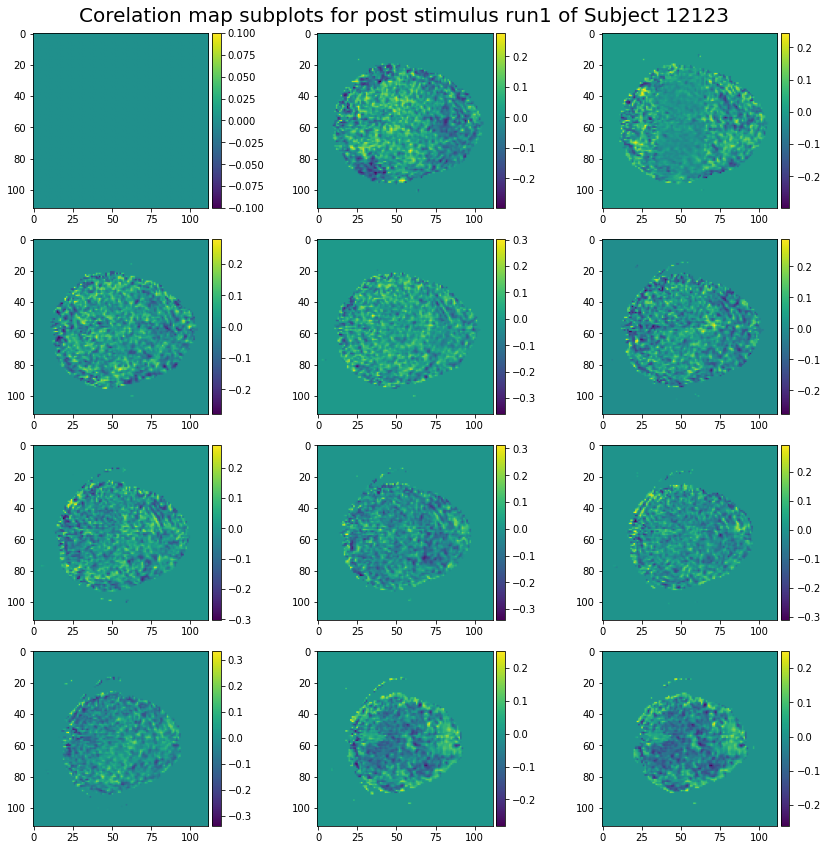

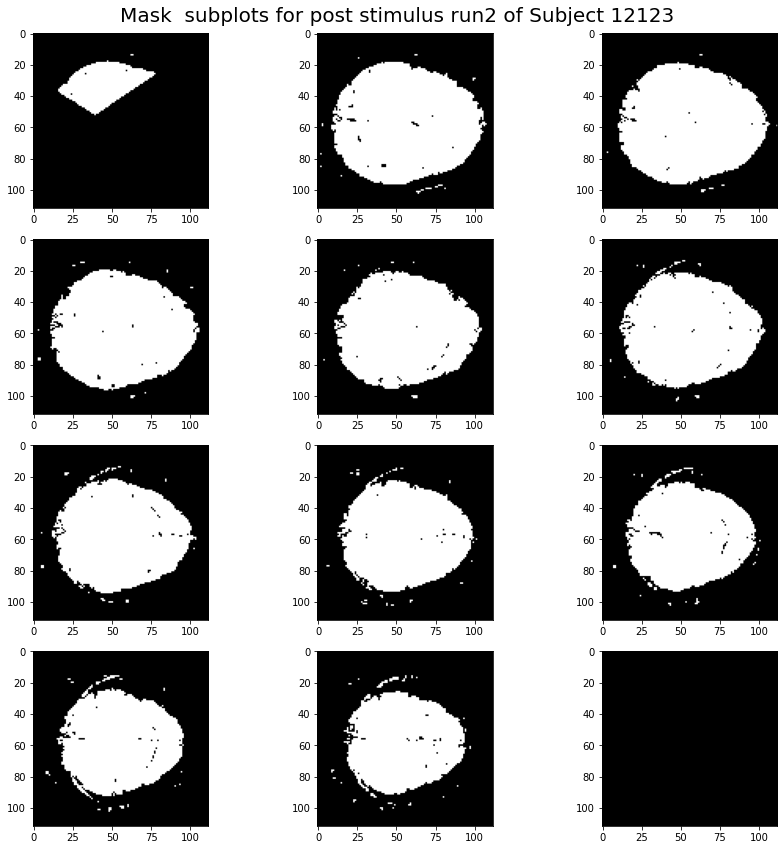

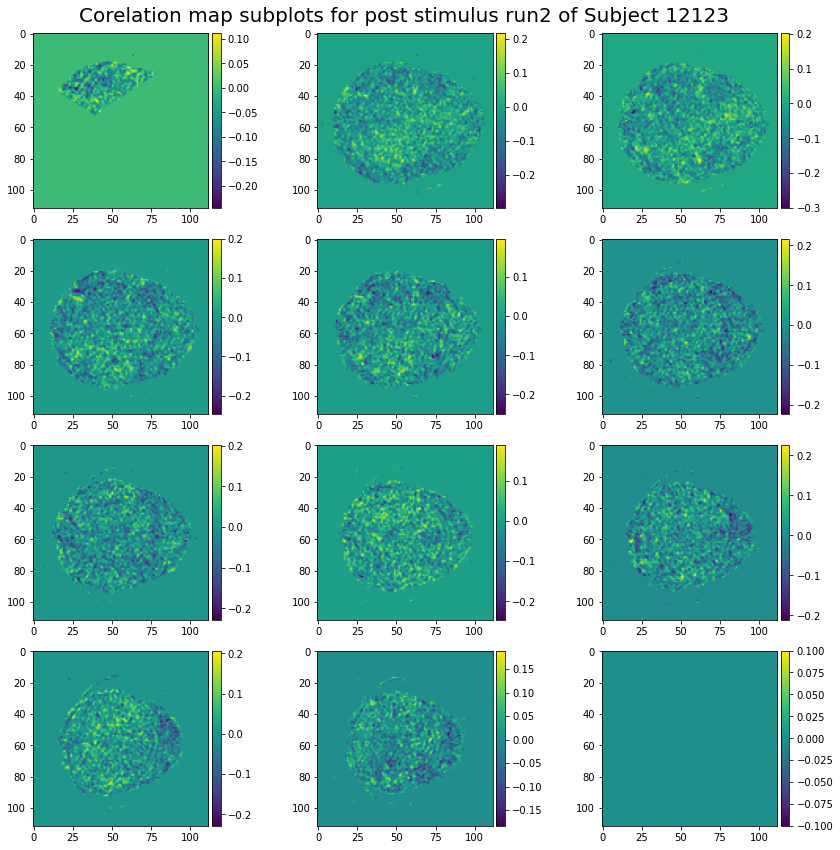

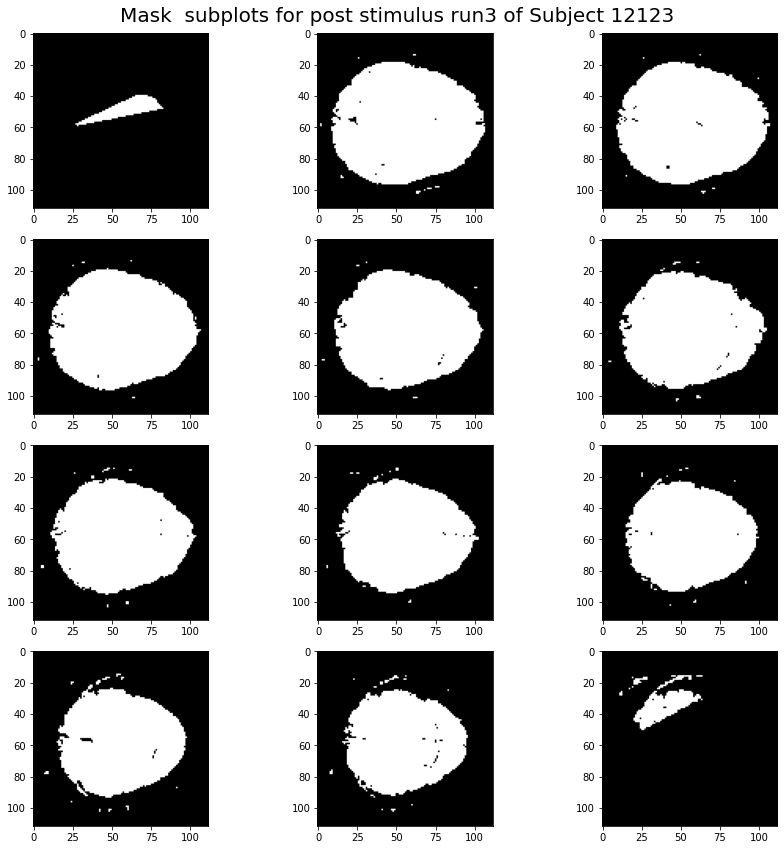

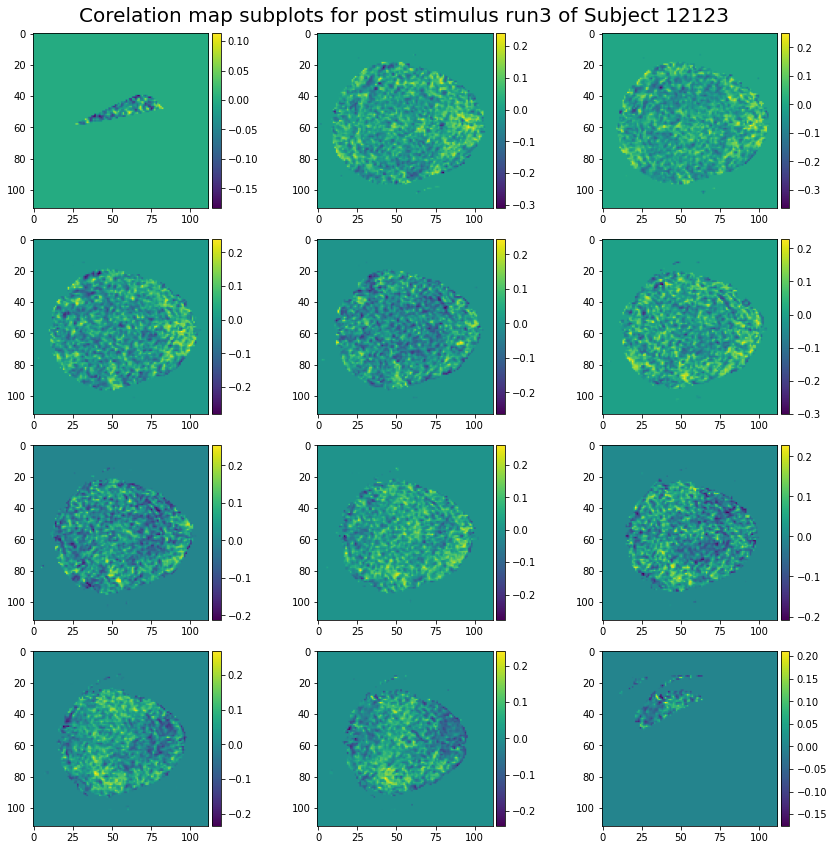

In [24]:
import nibabel as nib # We'll call nibabel nib for short as we'll be calling it lots
from nibabel.processing import resample_from_to 
import matplotlib.pyplot as plt 
import scipy.io as sio
import os
from nibabel.testing import data_path
epi_img1 = nib.load("flirts\\flirt_BOLD_TS_12123_r1.nii") # Import the data. 
epi_voxels1 = epi_img1.get_fdata() # Get a 3D array of voxels
mask_list1p, cc_image1p = correlation_map(" subplots for post stimulus run1 of Subject 12123",epi_voxels1,postconv1[::30]) #creating correlation maps for post stimulus response
epi_img2 = nib.load("flirts\\realign_interleaved_BOLD_TS_12123.img") # Import the data. 
epi_voxels2 = epi_img2.get_fdata() # Get a 3D array of voxels
mask_list2p, cc_image2p = correlation_map(" subplots for post stimulus run2 of Subject 12123",epi_voxels2,postconv2[::30])
epi_img3 = nib.load("flirts\\flirt_BOLD_TS_12123_r3.nii") # Import the data. 
epi_voxels3 = epi_img3.get_fdata() # Get a 3D array of voxels
mask_list3p, cc_image3p = correlation_map(" subplots for post stimulus run3 of Subject 12123",epi_voxels3,postconv3[::30])

The ouptut shows correlation as expected with the lower region having a higher correlation, and this is the motor cortex with the right hand being moved the left hemisphere is active. There is however a problem with the 1st and 12th plots of the 2nd and 3rd run. This is likely due to be down to the threshold intensity which was chosen to distinguish noise from signal. In the 1st run the last image had a weak signal and had to be lowered, so there may be something anomalous with the 12th image of the 2nd and 3rd run. This will be the next focus. 

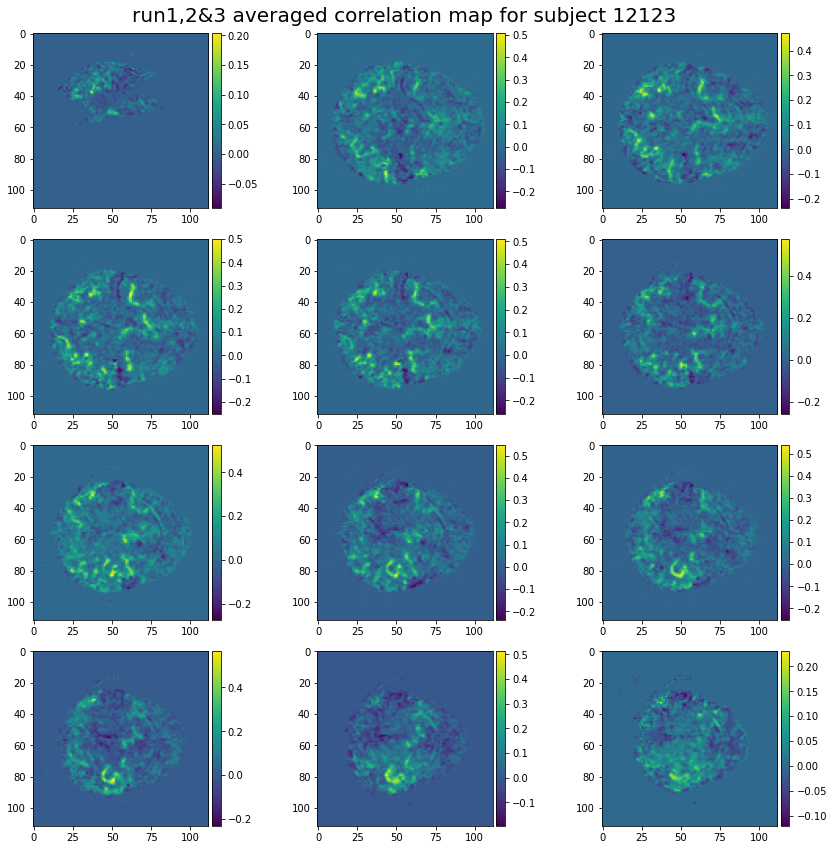

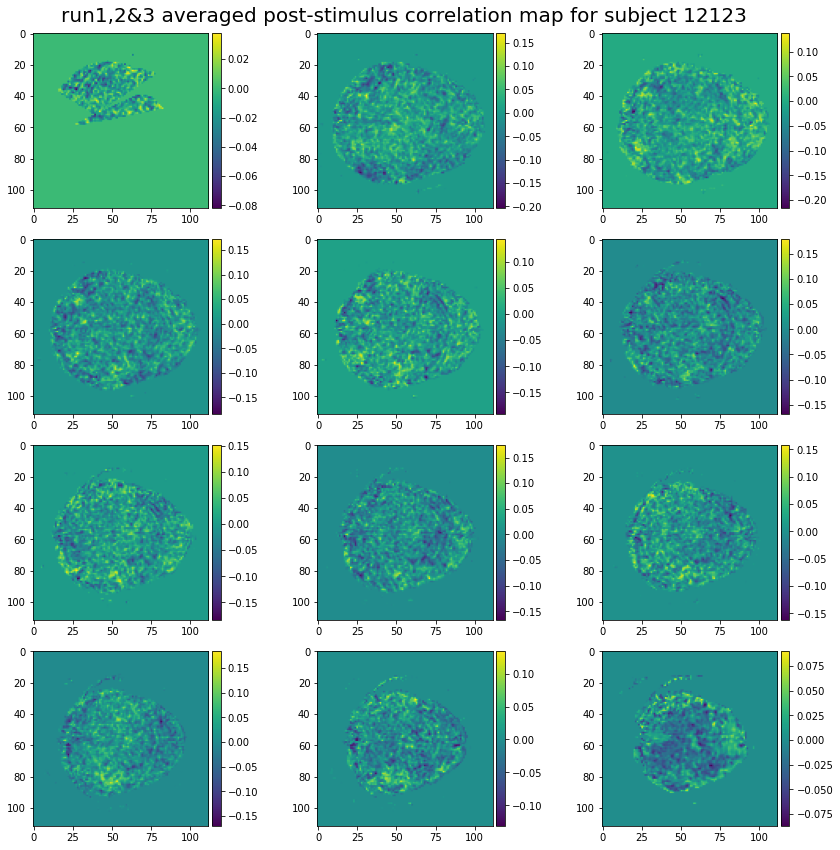

In [25]:

def average_plot(title, average):
    fig1,axes1 = plt.subplots(nrows=4,ncols=3,figsize=(12,12)) 
    fig1.tight_layout()                    
    n = 0
    for x in range(4):
        for y in range(3):
            axes1[x,y].imshow(average[:,:,n])
            divider = make_axes_locatable(axes1[x,y])
            cax = divider.append_axes('right', size='5%', pad=0.05)
            fig1.colorbar(axes1[x,y].imshow(average[:,:,n]),cax=cax,orientation='vertical')  
            n = n+1
    plt.suptitle(title, fontsize= 20)
    plt.subplots_adjust(top=0.95)
    plt.show()

cc_average_12123 = (cc_image1 + cc_image2 + cc_image3)/3
average_plot_12123 = average_plot("run1,2&3 averaged correlation map for subject 12123",cc_average_12123)
cc_post_average_12123 = (cc_image1p + cc_image2p + cc_image3p)/3
post_average_plot_12123 = average_plot("run1,2&3 averaged post-stimulus correlation map for subject 12123",cc_post_average_12123)

***
# Subject 06275

Now we turn to a new subject

In [26]:
import nibabel as nib # We'll call nibabel nib for short as we'll be calling it lots
from nibabel.processing import resample_from_to 
import matplotlib.pyplot as plt 
import scipy.io as sio
import os
from nibabel.testing import data_path
#showing mask and correlation maps for the BOLD response
epi_img1_06275 = nib.load("flirts\\flirt_BOLD_TS_06275_r1.nii") # Import the data. 
epi_voxels1_06275 = epi_img1_06275.get_fdata() # Get a 3D array of voxels
mask_list1_06275, cc_image1_06275 = correlation_map("subplots for run1 of Subject 06275",epi_voxels1_06275,convolution1_06275[::30])
epi_img2_06275 = nib.load("flirts\\realign_interleaved_BOLD_TS_06275_r2.img") # Import the data. 
epi_voxels2_06275 = epi_img2_06275.get_fdata() # Get a 3D array of voxels
mask_list2_06275, cc_image2_06275 = correlation_map(" subplots for run2 of Subject 06275",epi_voxels2_06275,convolution2_06275[::30])
epi_img3_06275 = nib.load("flirts\\flirt_BOLD_TS_06275_r3.nii") # Import the data. 
epi_voxels3_06275 = epi_img3_06275.get_fdata() # Get a 3D array of voxels
mask_list3_06275, cc_image3_06275 = correlation_map(" subplots for run3 of Subject 06275",epi_voxels3_06275,convolution3_06275[::30])

#showing post stimulus response
mask_list1_06275p, cc_image1_06275p = correlation_map("subplots for post-stimulus run 1 of Subject 06275",epi_voxels1_06275,postconv1_06275[::30])

mask_list2_06275p, cc_image2_06275p = correlation_map(" subplots for post-stimulus run 2 of Subject 06275",epi_voxels2_06275,postconv2_06275[::30])

mask_list3_06275p, cc_image3_06275p = correlation_map(" subplots for post-stimulus run 3 of Subject 06275",epi_voxels3_06275,postconv3_06275[::30])

FileNotFoundError: No such file or no access: 'flirts\flirt_BOLD_TS_06275_r1.nii'

And now the averaged correlation map for both post stimulus and whole signal is shown below

In [27]:
cc_average_06275 = (cc_image1_06275 + cc_image2_06275 + cc_image3_06275)/3
average_plot_06275 = average_plot("run1,2&3 averaged correlation map for subject 06275",cc_average_06275)
cc_post_average_06275 = (cc_image1_06275p + cc_image2_06275p + cc_image3_06275p)/3
post_average_plot_06275 = average_plot("run1,2&3 averaged post-stimulus correlation map for subject 06275",cc_post_average_06275)

NameError: name 'cc_image1_06275' is not defined

***
# Subject 10925


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Fri Jan 24 13:23:01 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[ 2.9846, 11.    ,  2.996 ,  2.9984, 10.9948, 10.8926, 10.633 ,
         3.    , 11.    , 10.9962,  3.    ,  2.9342]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[ 2.9846 11.      2.996   2.9984 10.9948 10.8926 10.633   3.     11.
  10.9962  3.      2.9342]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791.179

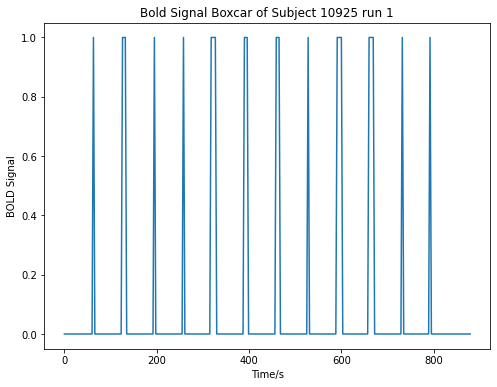

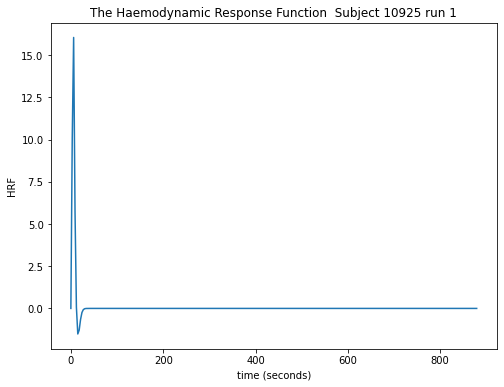

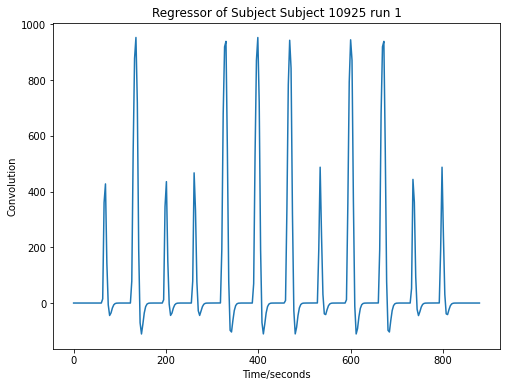

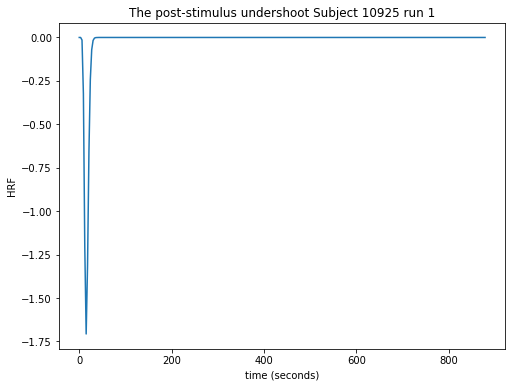

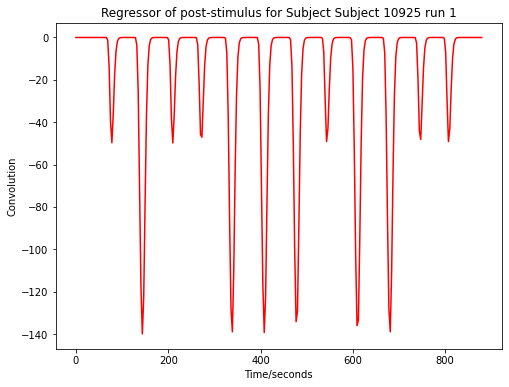


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Fri Jan 24 13:23:19 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[10.9814,  2.8946, 10.9814, 10.7666,  2.824 ,  2.9806,  2.9524,
        11.    ,  2.9594,  2.796 , 10.9658, 10.8286]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[10.9814  2.8946 10.9814 10.7666  2.824   2.9806  2.9524 11.      2.9594
   2.796  10.9658 10.8286]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791

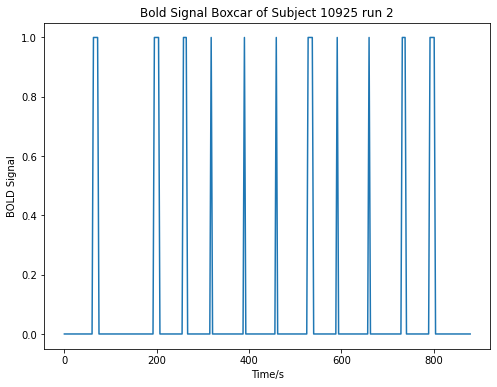

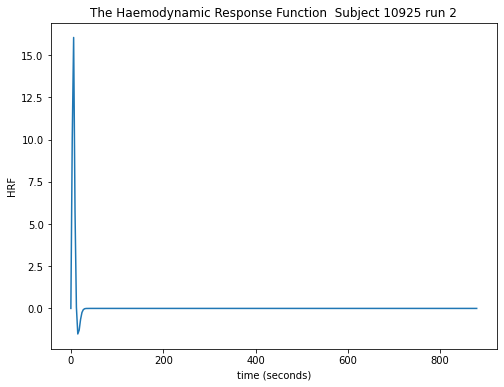

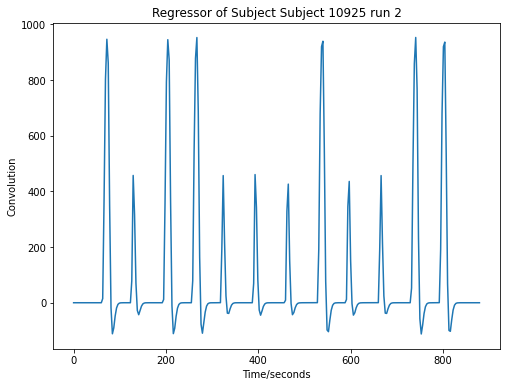

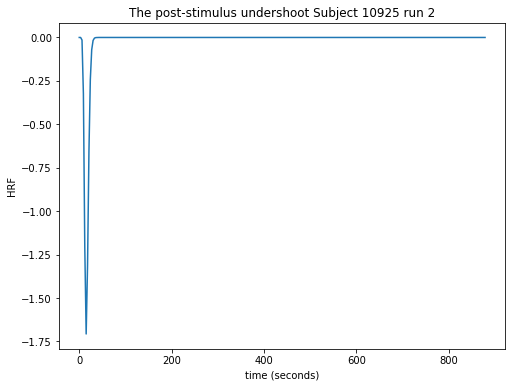

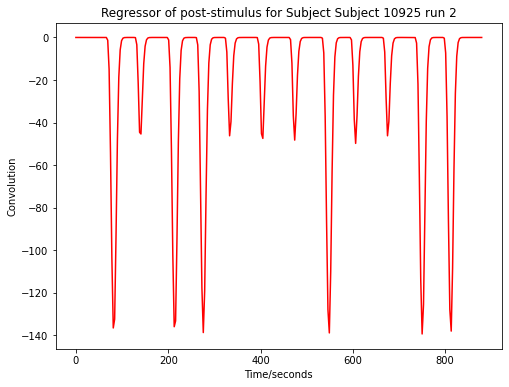


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Fri Jan 24 13:23:34 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[10.9482,  2.9054,  2.9836, 10.9222, 10.9238, 11.    ,  2.9784,
        10.9598, 10.9748,  2.9494,  3.    ,  2.9818]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[10.9482  2.9054  2.9836 10.9222 10.9238 11.      2.9784 10.9598 10.9748
   2.9494  3.      2.9818]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791

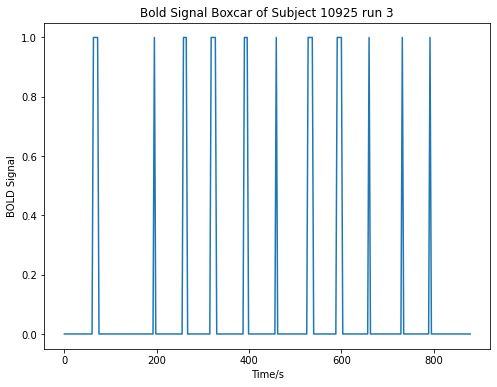

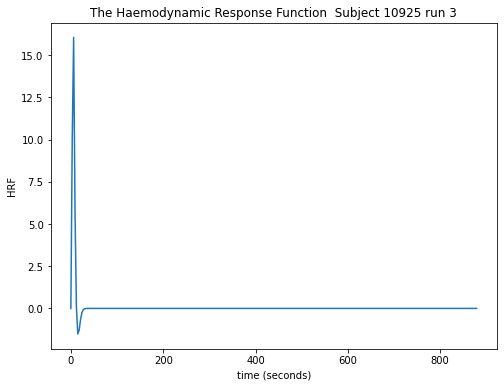

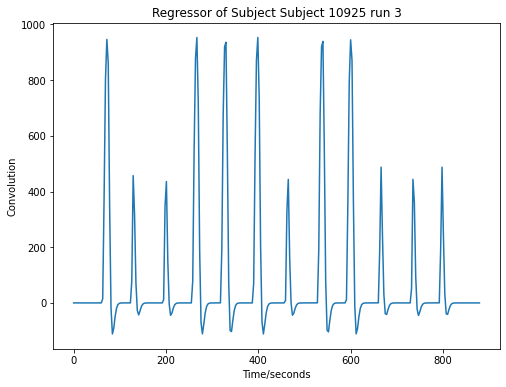

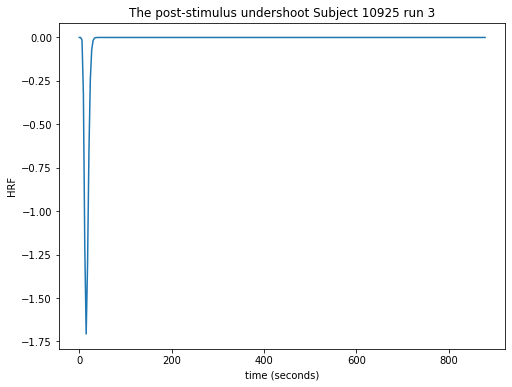

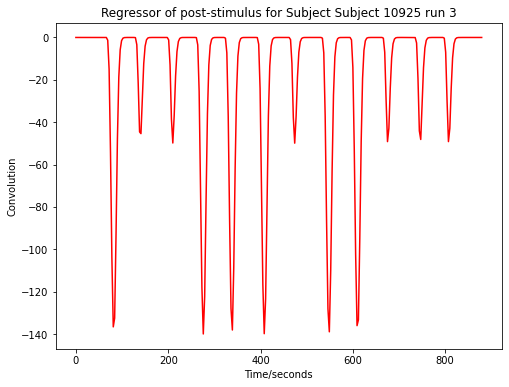

In [ ]:
#run 1
onset1_10925= sio.loadmat("Subject10925\\run1_BOLD_EMG_onset_10925")
durations1_10925 = sio.loadmat("Subject10925\\run1_durations_10925")
x1_10925,y1_10925,convolution1_10925,postconv1_10925= box_car("Subject 10925 run 1",onset1_10925,durations1_10925)
#run 2
onset2_10925= sio.loadmat("Subject10925\\run2_BOLD_EMG_onset_10925")
durations2_10925 = sio.loadmat("Subject10925\\run2_durations_10925")
x2_10925,y2_10925,convolution2_10925,postconv2_10925= box_car("Subject 10925 run 2",onset2_10925,durations2_10925)
#run 3
onset3_10925= sio.loadmat("Subject10925\\run3_BOLD_EMG_onset_10925")
durations3_10925 = sio.loadmat("Subject10925\\run3_durations_10925")
x3_10925,y3_10925,convolution3_10925,postconv3_10925= box_car("Subject 10925 run 3",onset3_10925,durations3_10925)

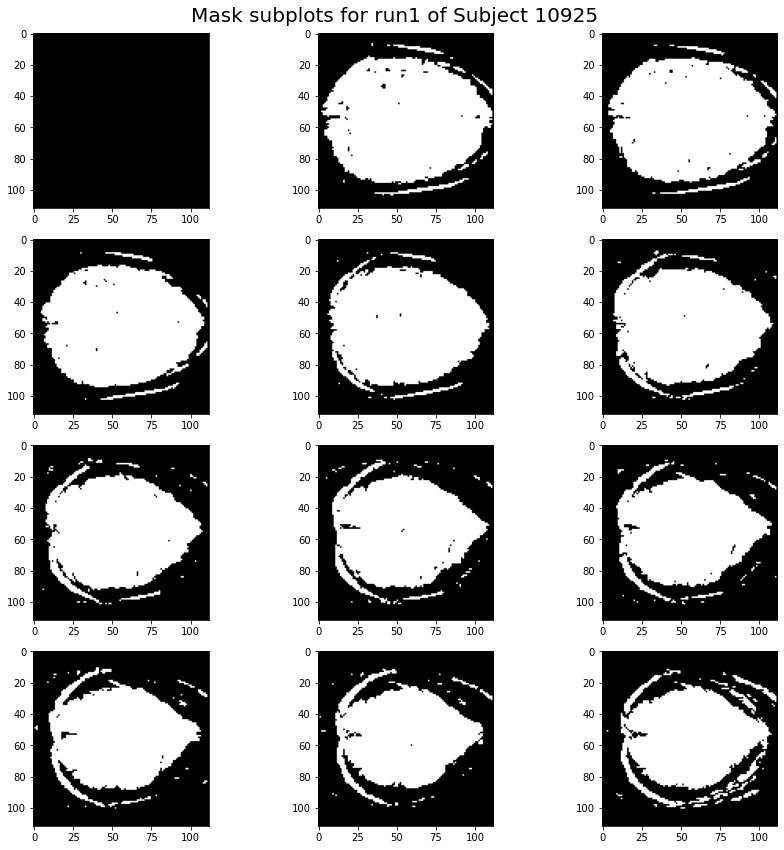

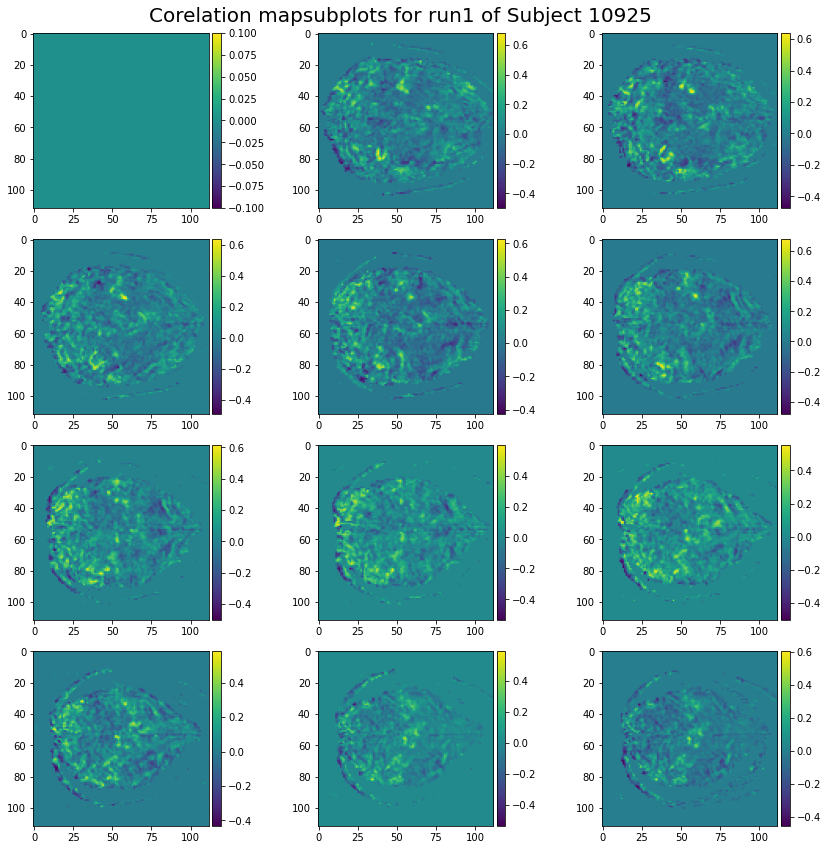

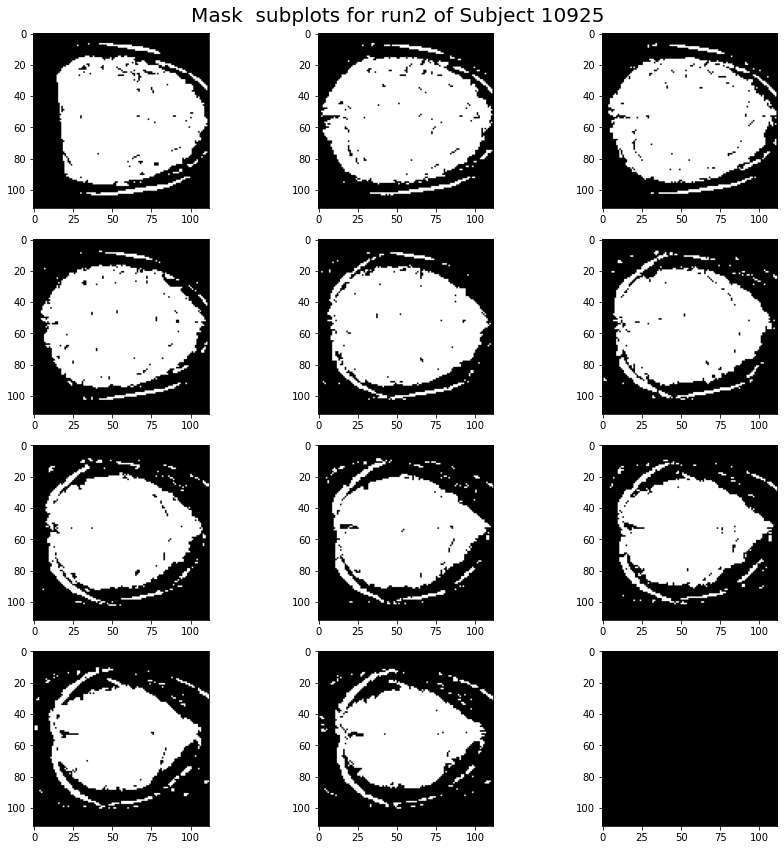

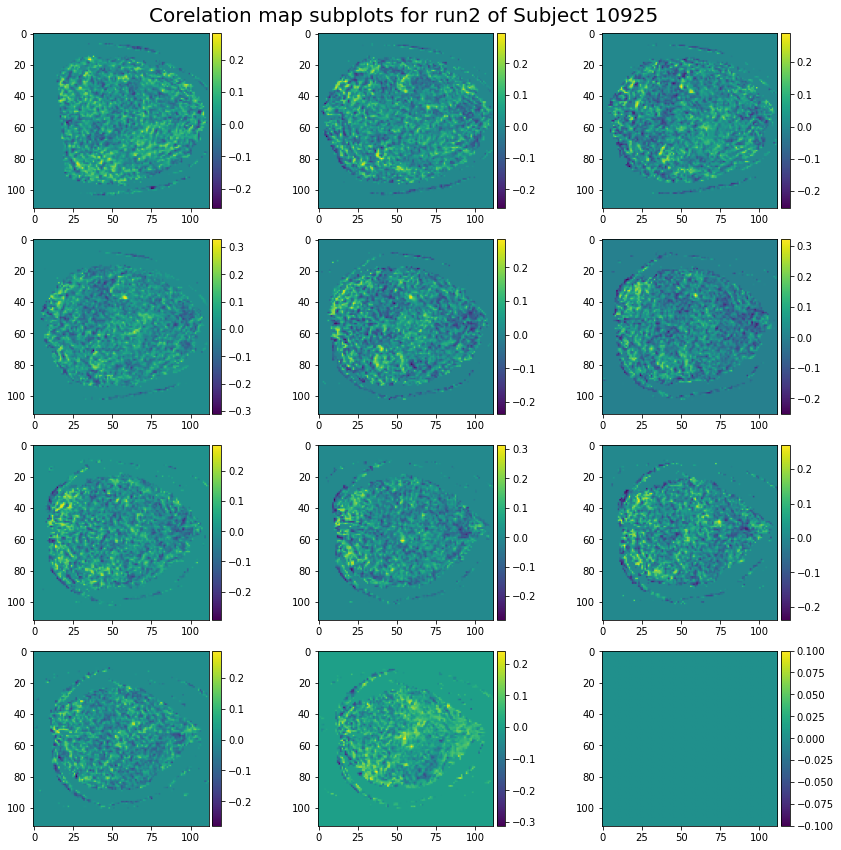

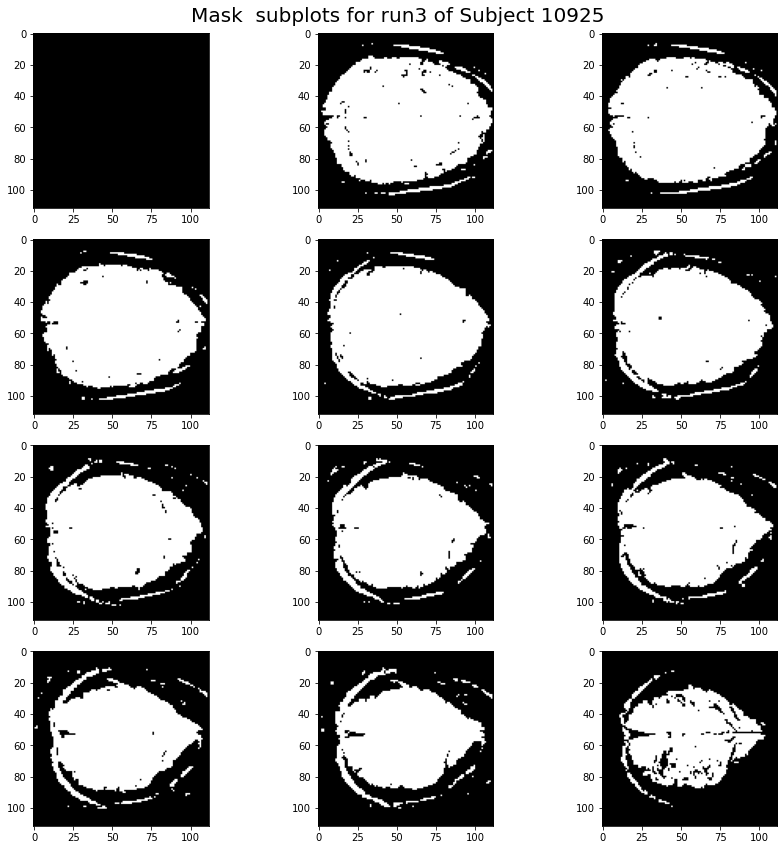

...

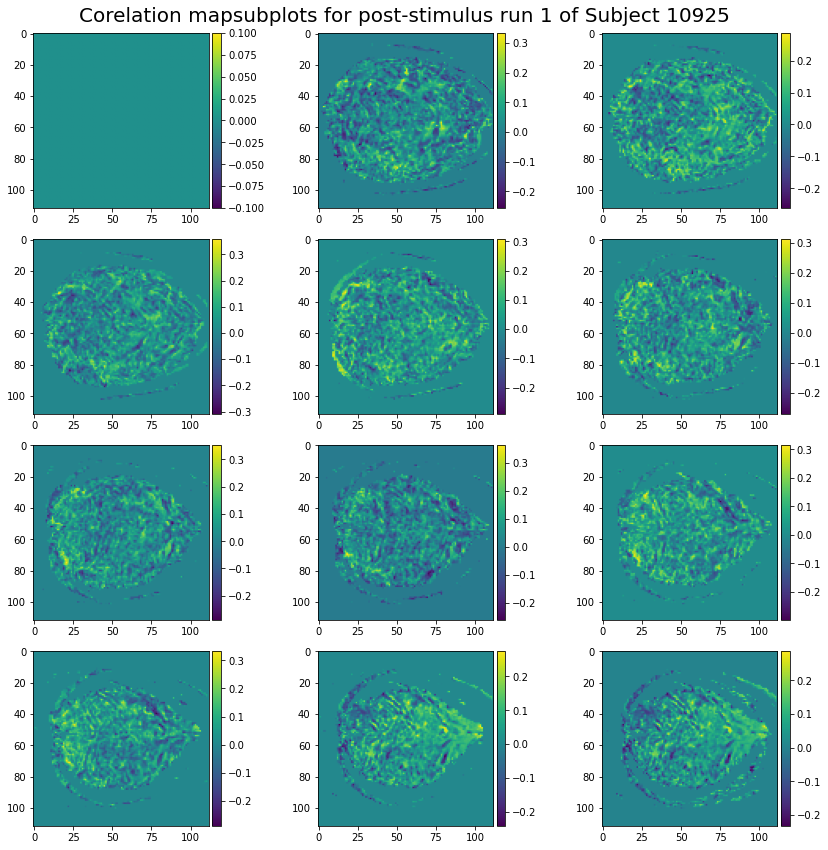

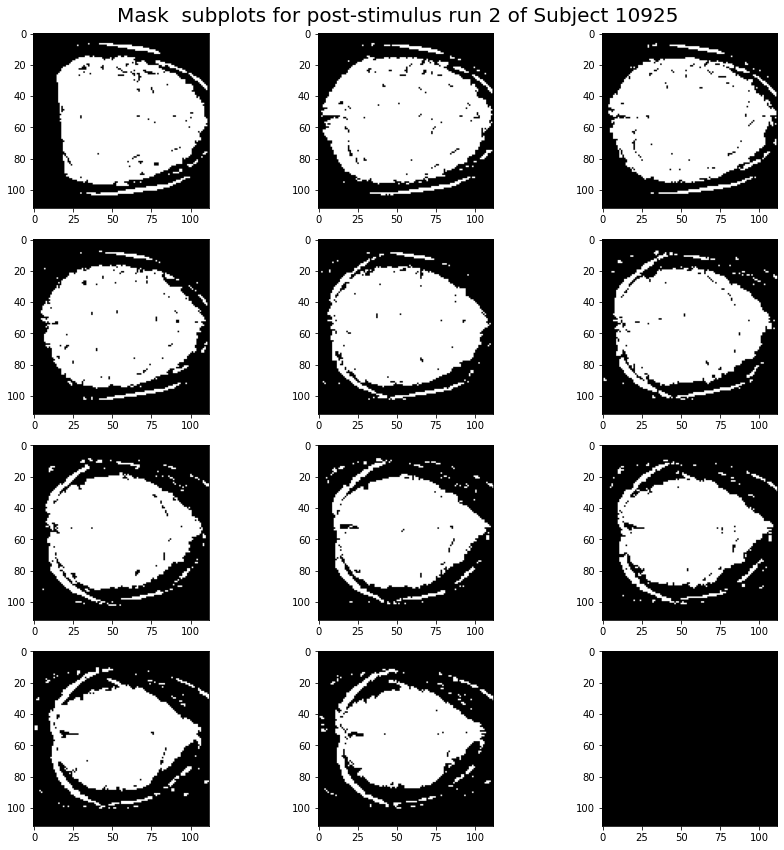

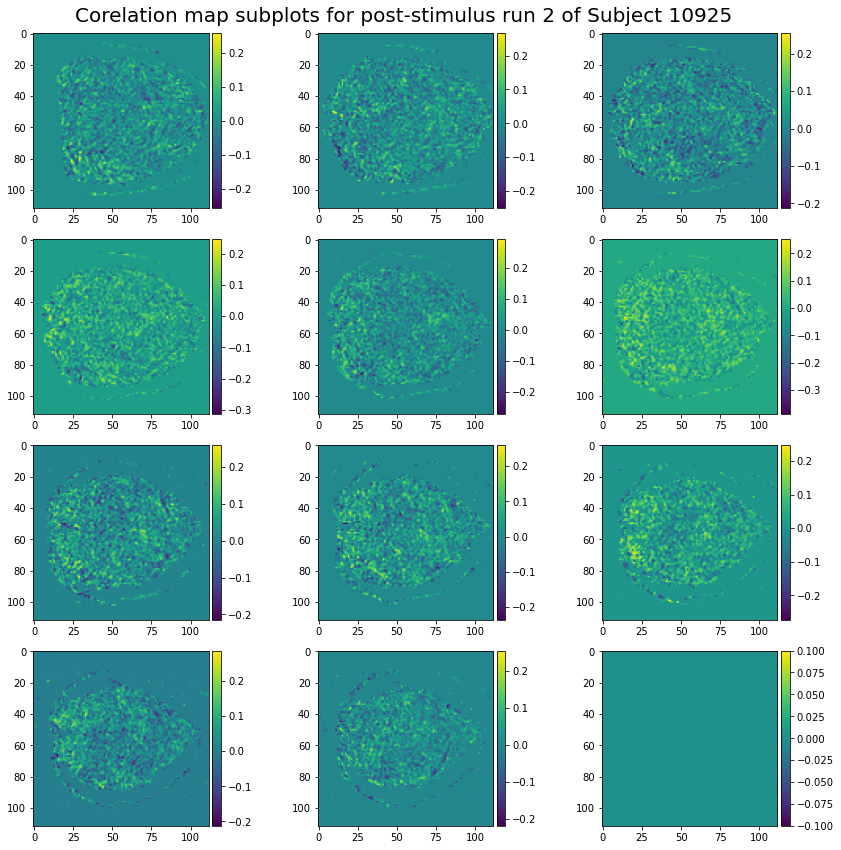

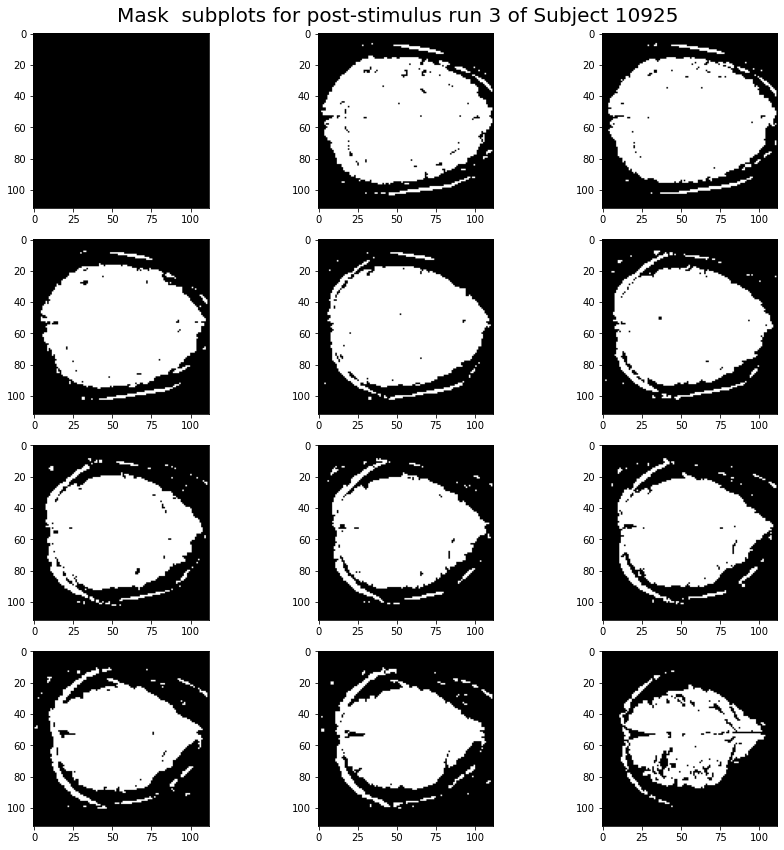

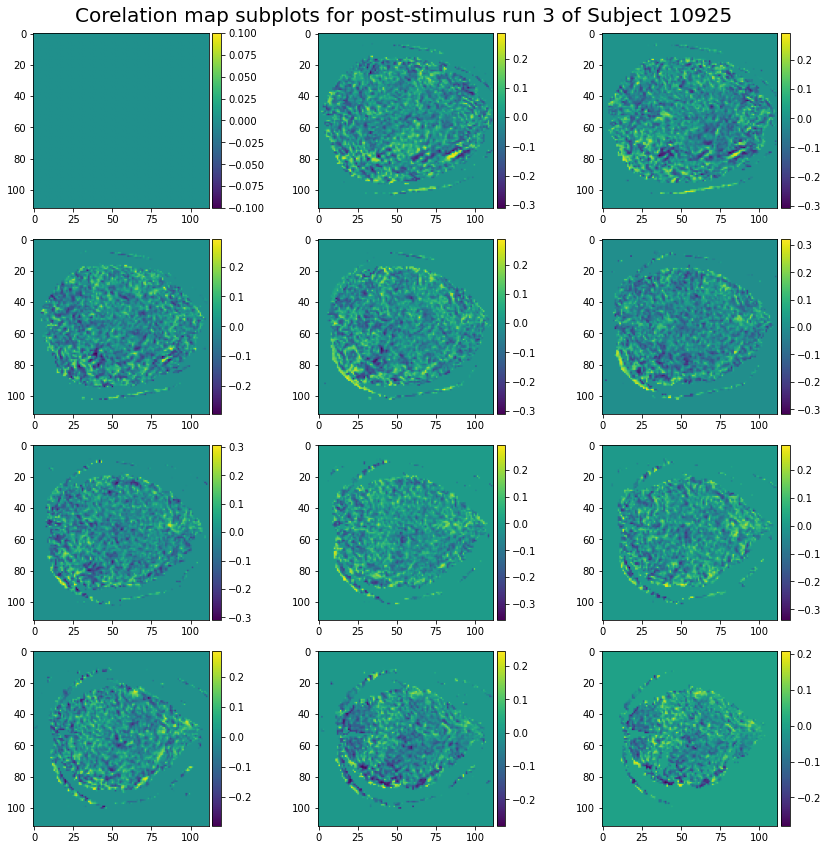

In [ ]:
import nibabel as nib # We'll call nibabel nib for short as we'll be calling it lots
from nibabel.processing import resample_from_to 
import matplotlib.pyplot as plt 
import scipy.io as sio
import os
from nibabel.testing import data_path
#showing mask and correlation maps for the BOLD response
epi_img1_10925 = nib.load("flirts\\flirt_BOLD_TS_10925_r1.nii") # Import the data. 
epi_voxels1_10925 = epi_img1_10925.get_fdata() # Get a 3D array of voxels
mask_list1_10925, cc_image1_10925 = correlation_map("subplots for run1 of Subject 10925 ",epi_voxels1_10925,convolution1_10925[::30])
epi_img2_10925 = nib.load("flirts\\realign_interleaved_BOLD_TS_10925_r2.img") # Import the data. 
epi_voxels2_10925 = epi_img2_10925.get_fdata() # Get a 3D array of voxels
mask_list2_10925, cc_image2_10925 = correlation_map(" subplots for run2 of Subject 10925",epi_voxels2_10925,convolution2_10925[::30])
epi_img3_10925 = nib.load("flirts\\flirt_BOLD_TS_10925_r3.nii") # Import the data. 
epi_voxels3_10925 = epi_img3_10925.get_fdata() # Get a 3D array of voxels
mask_list3_10925, cc_image3_10925 = correlation_map(" subplots for run3 of Subject 10925",epi_voxels3_10925,convolution3_10925[::30])

#showing post stimulus response
mask_list1_10925p, cc_image1_10925p = correlation_map("subplots for post-stimulus run 1 of Subject 10925",epi_voxels1_10925,postconv1_10925[::30])

mask_list2_10925p, cc_image2_10925p = correlation_map(" subplots for post-stimulus run 2 of Subject 10925",epi_voxels2_10925,postconv2_10925[::30])

mask_list3_10925p, cc_image3_10925p = correlation_map(" subplots for post-stimulus run 3 of Subject 10925",epi_voxels3_10925,postconv3_10925[::30])

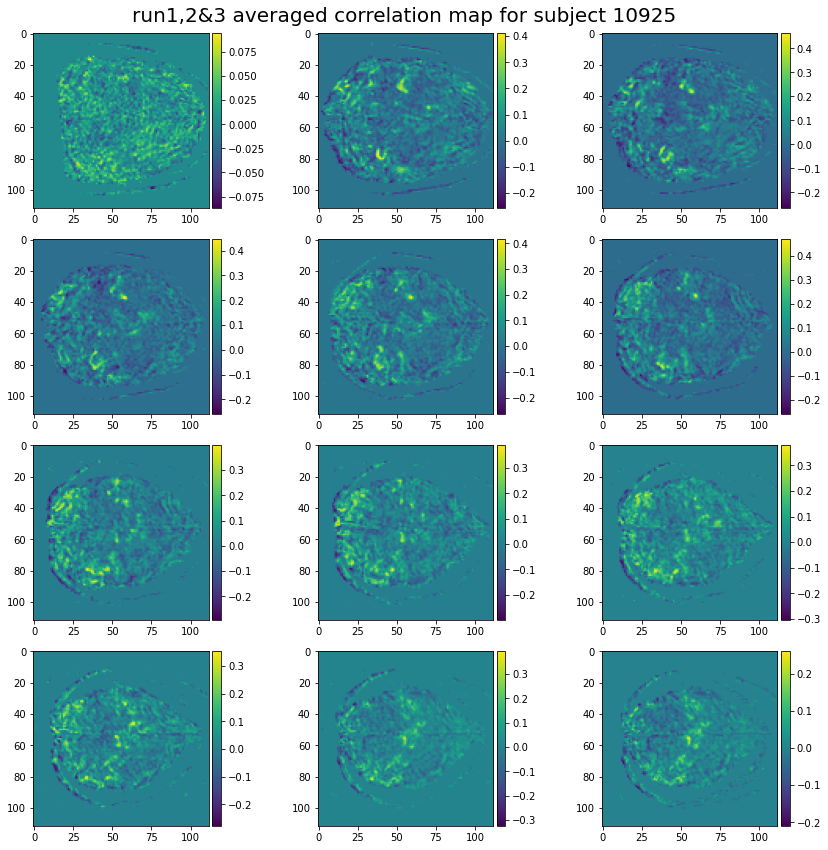

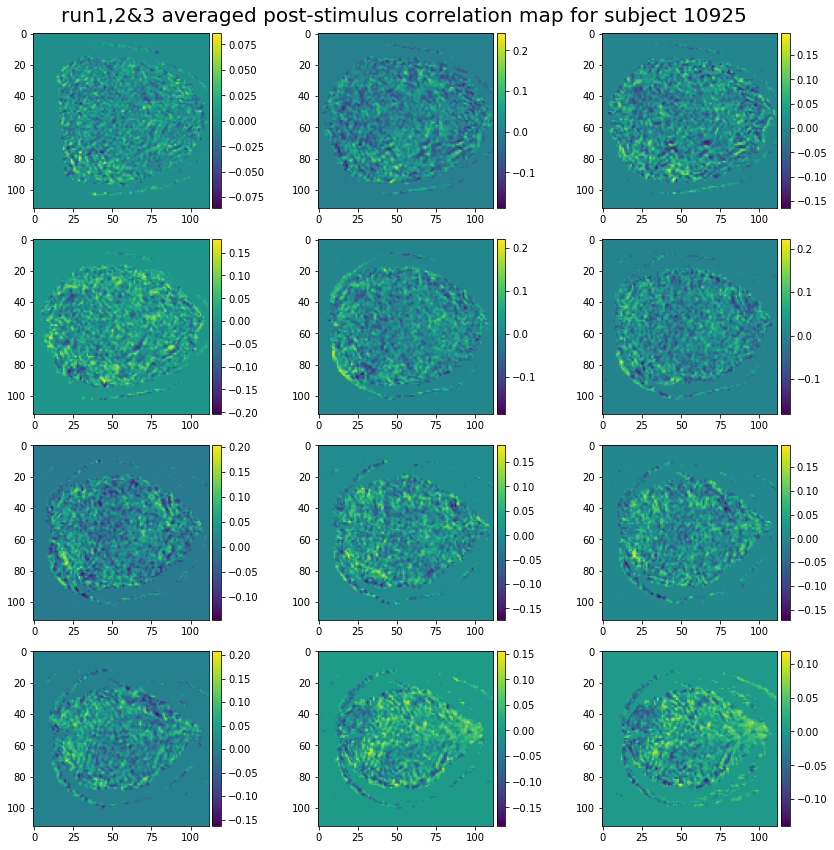

In [ ]:
cc_average_10925 = (cc_image1_10925 + cc_image2_10925 + cc_image3_10925)/3
average_plot_10925 = average_plot("run1,2&3 averaged correlation map for subject 10925",cc_average_10925)
cc_post_average_10925 = (cc_image1_10925p + cc_image2_10925p + cc_image3_10925p)/3
post_average_plot_10925 = average_plot("run1,2&3 averaged post-stimulus correlation map for subject 10925",cc_post_average_10925)

***
# Subject 11264


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Sun Jan 26 17:50:46 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[ 2.9824, 10.995 ,  2.9308,  2.999 , 11.    , 11.    , 10.9712,
         2.986 , 10.9898, 10.8936,  2.9556,  2.8924]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[ 2.9824 10.995   2.9308  2.999  11.     11.     10.9712  2.986  10.9898
  10.8936  2.9556  2.8924]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791

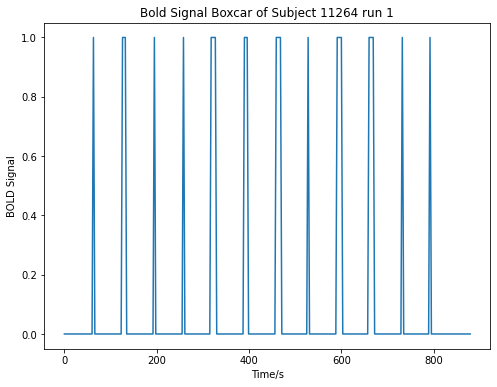

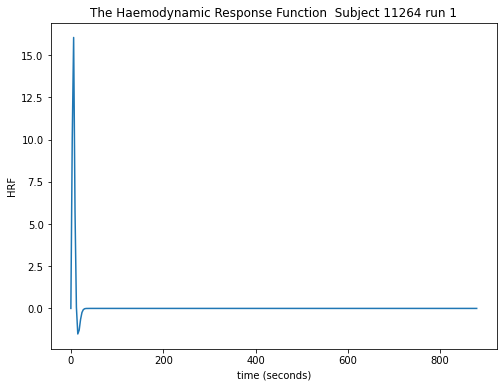

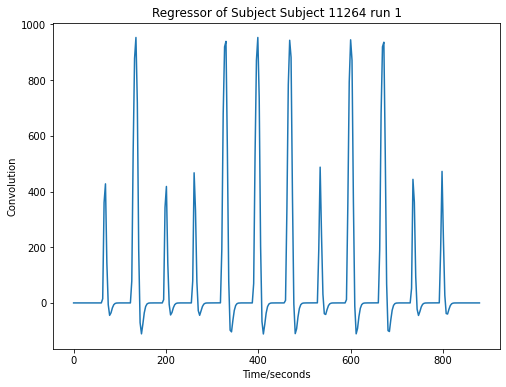

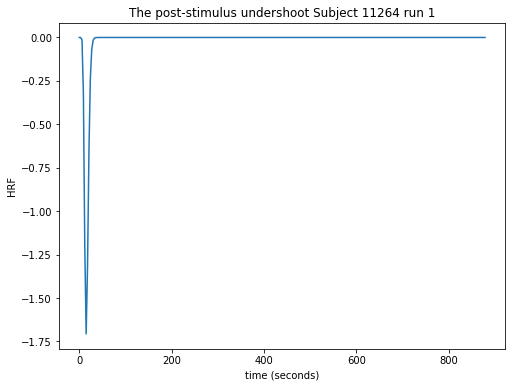

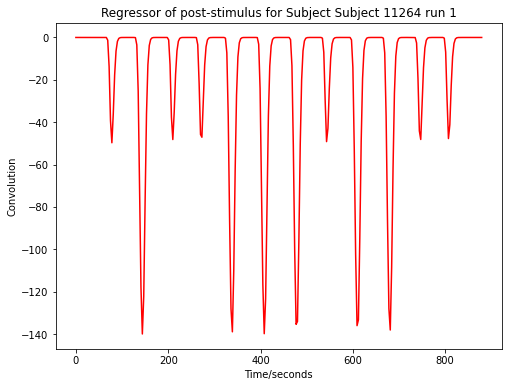


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Sun Jan 26 17:50:59 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[10.981 ,  2.693 , 10.9978, 10.9442,  2.9816,  2.9962,  2.9788,
        10.8954,  2.9106,  2.617 , 10.8916, 10.9704]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[10.981   2.693  10.9978 10.9442  2.9816  2.9962  2.9788 10.8954  2.9106
   2.617  10.8916 10.9704]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791

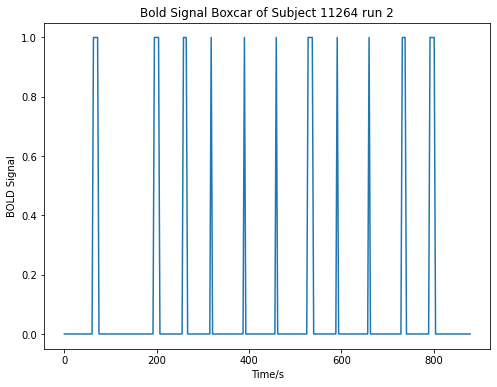

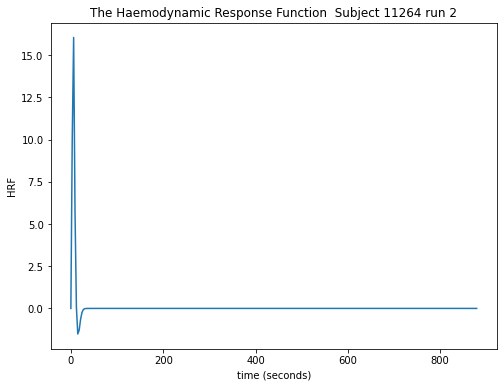

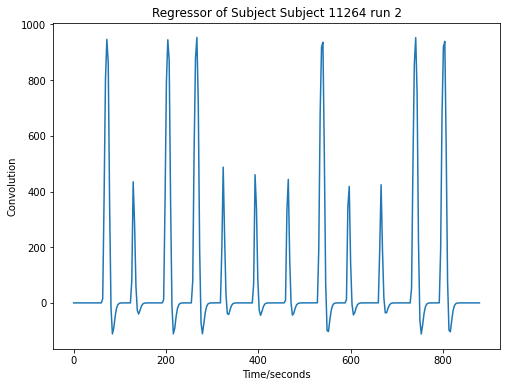

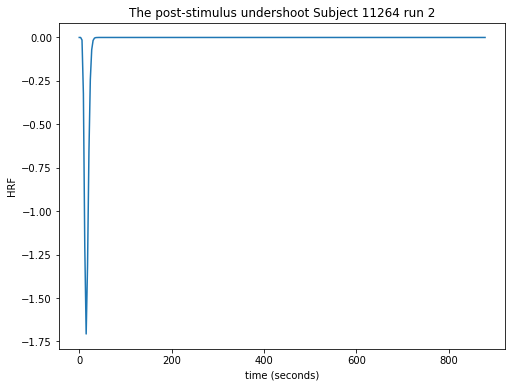

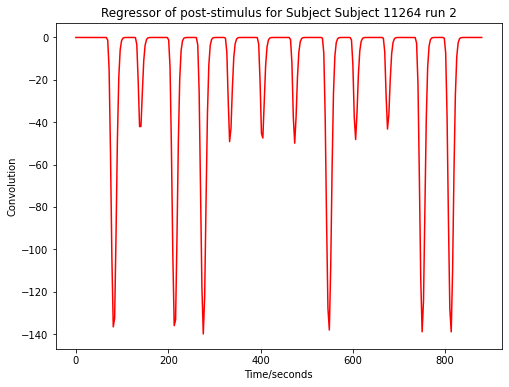


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Sun Jan 26 17:51:13 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[10.8266,  2.9968,  2.84  , 10.841 , 10.999 , 10.8438,  2.9252,
        10.9726, 10.9996,  3.    ,  2.9602,  2.833 ]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[10.8266  2.9968  2.84   10.841  10.999  10.8438  2.9252 10.9726 10.9996
   3.      2.9602  2.833 ]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791

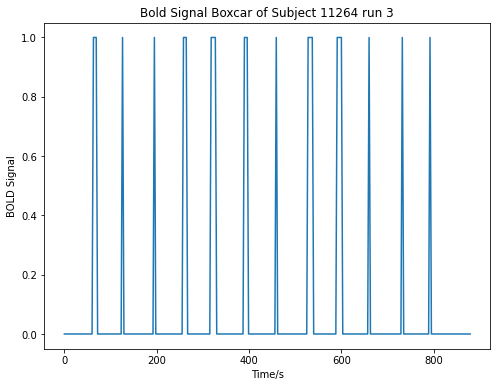

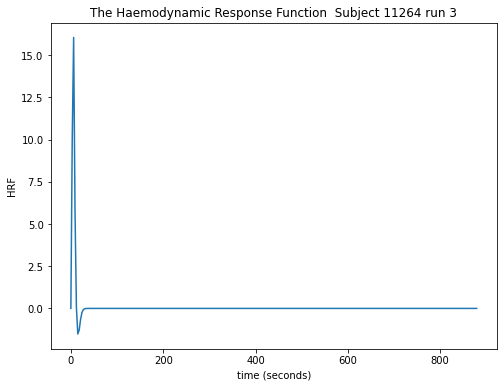

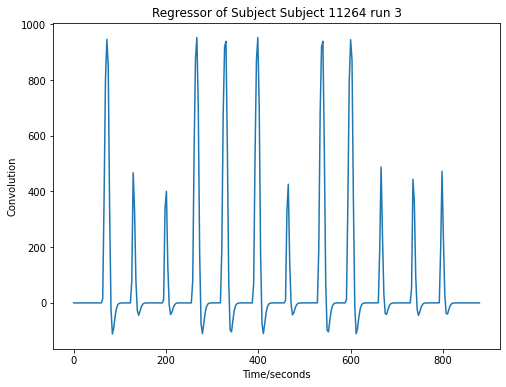

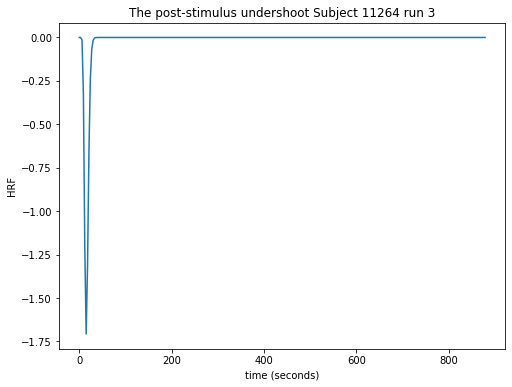

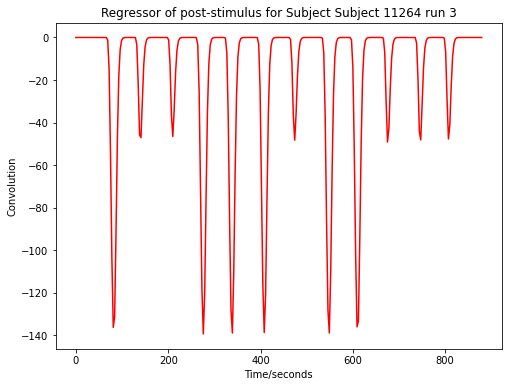

In [ ]:
#run 1
onset1_11264= sio.loadmat("Subject11264\\run1_BOLD_EMG_onset_11264")
durations1_11264 = sio.loadmat("Subject11264\\run1_durations_11264")
x1_11264,y1_11264,convolution1_11264,postconv1_11264= box_car("Subject 11264 run 1",onset1_11264,durations1_11264)
#run 2
onset2_11264= sio.loadmat("Subject11264\\run2_BOLD_EMG_onset_11264")
durations2_11264 = sio.loadmat("Subject11264\\run2_durations_11264")
x2_11264,y2_11264,convolution2_11264,postconv2_11264= box_car("Subject 11264 run 2",onset2_11264,durations2_11264)
#run 3
onset3_11264= sio.loadmat("Subject11264\\run3_BOLD_EMG_onset_11264")
durations3_11264 = sio.loadmat("Subject11264\\run3_durations_11264")
x3_11264,y3_11264,convolution3_11264,postconv3_11264= box_car("Subject 11264 run 3",onset3_11264,durations3_11264)

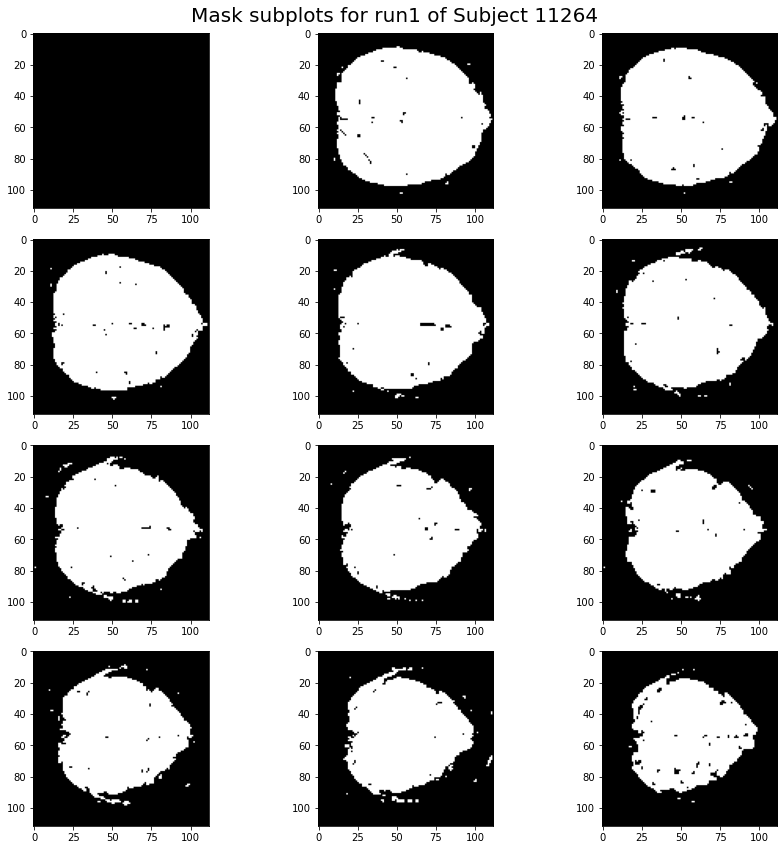

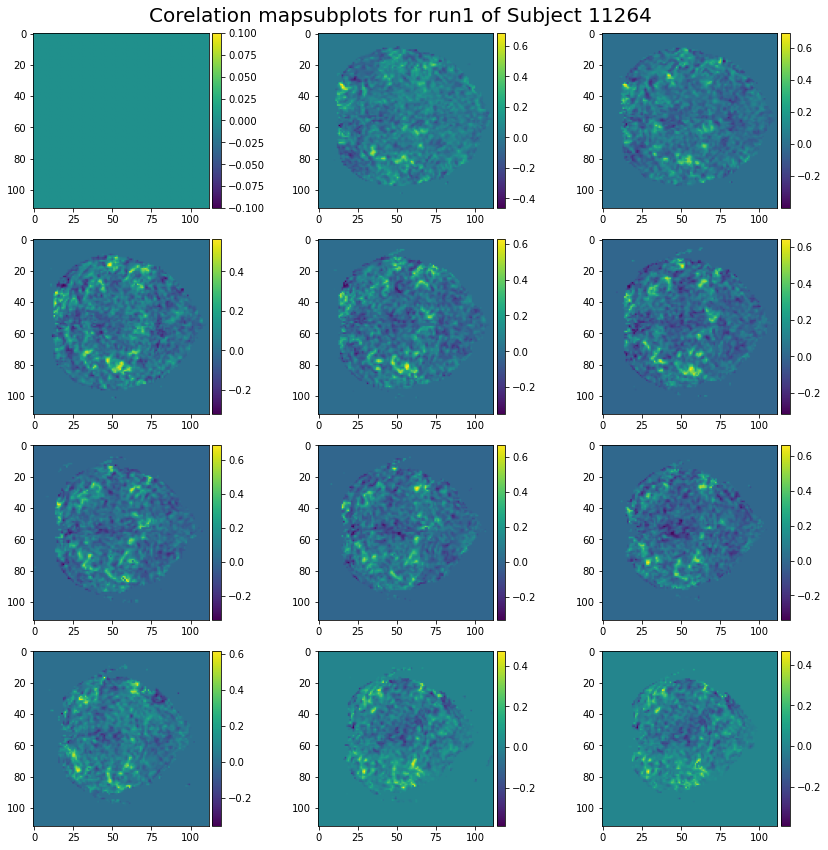

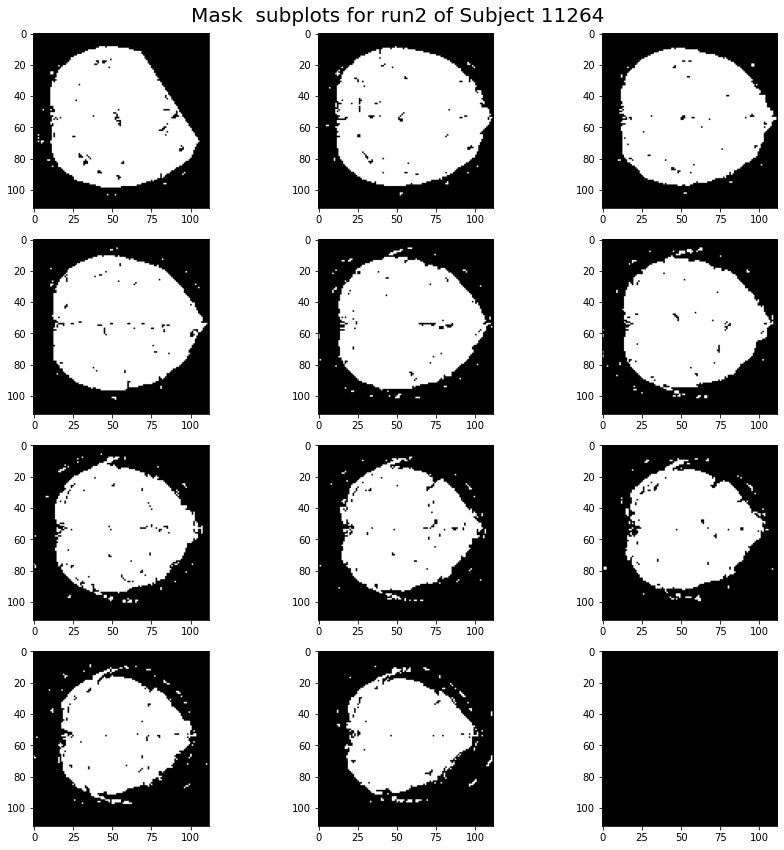

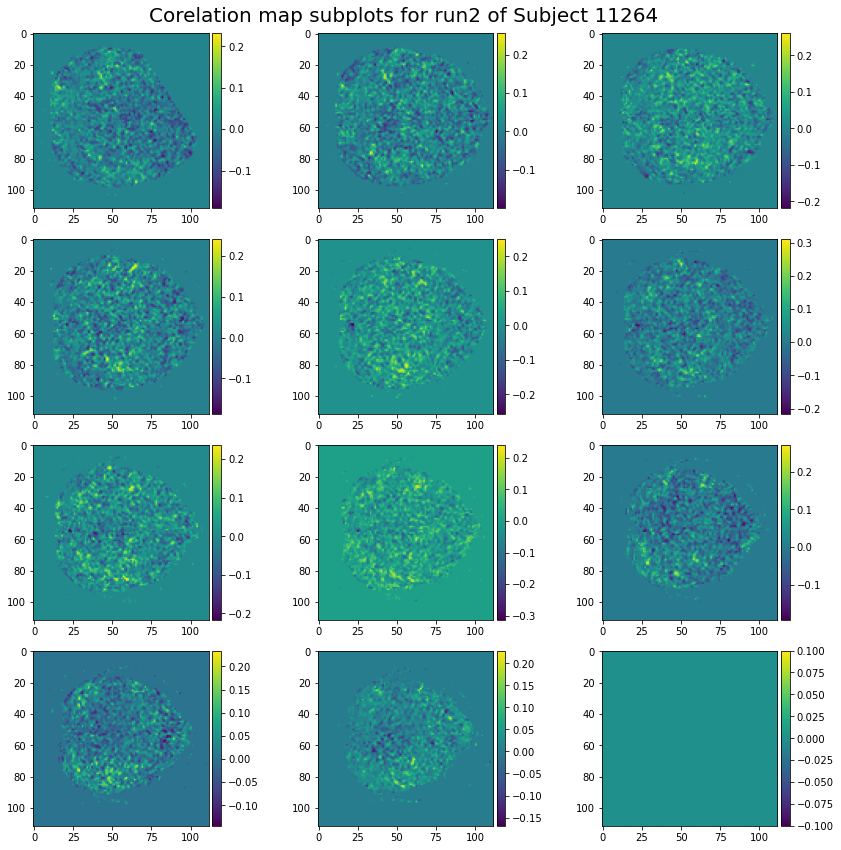

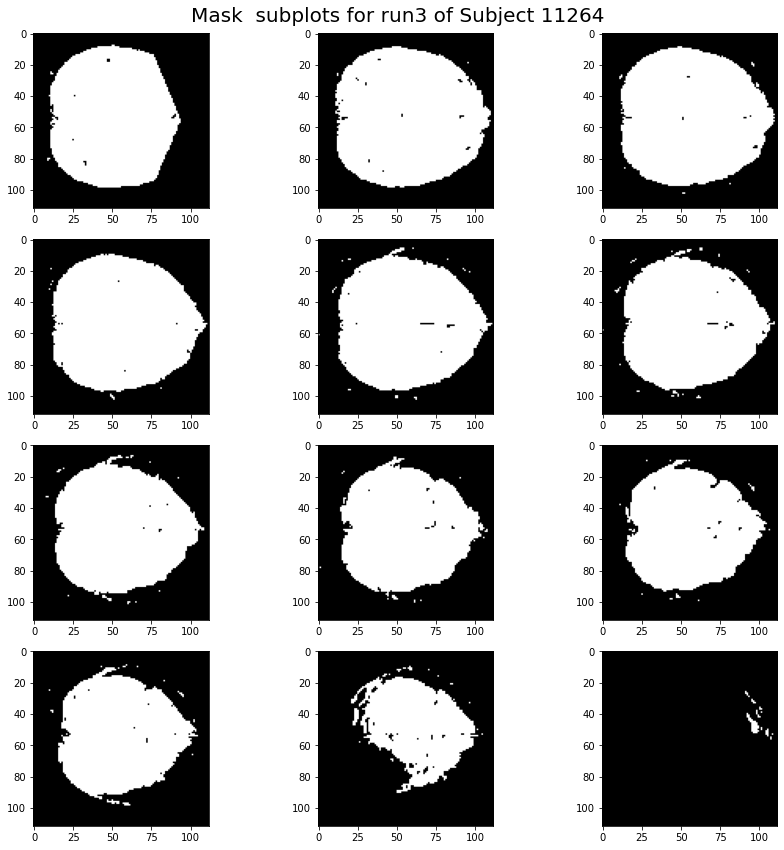

...

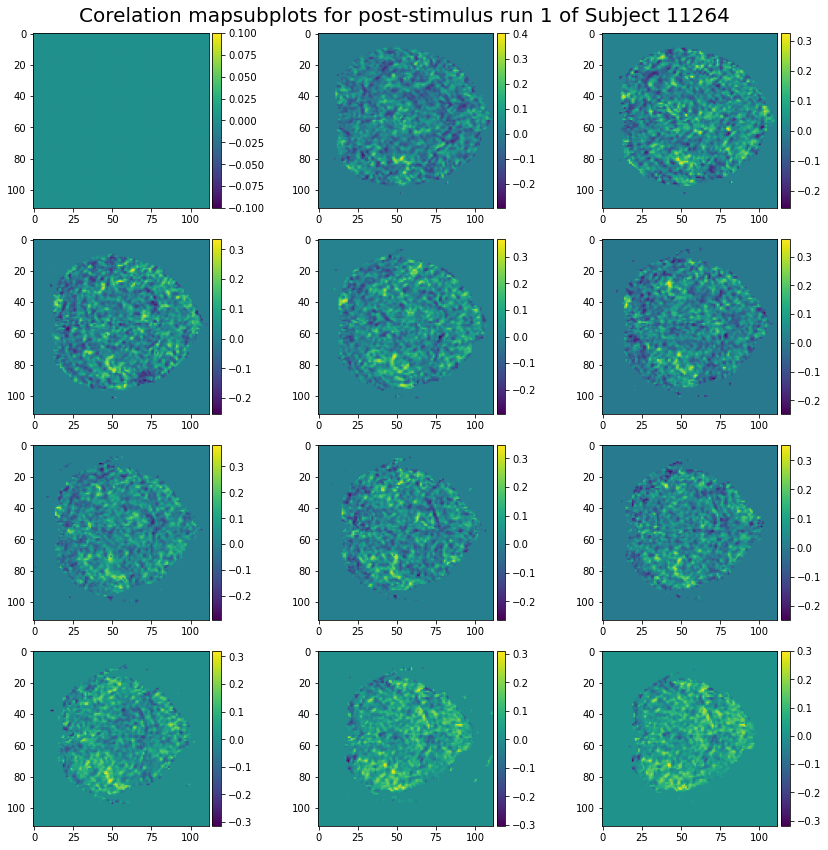

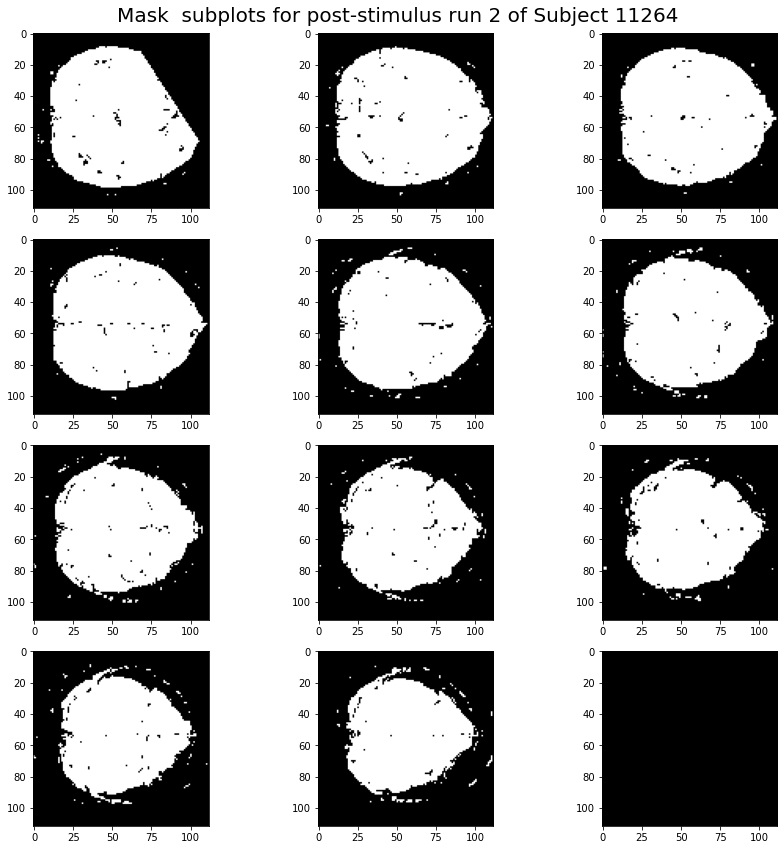

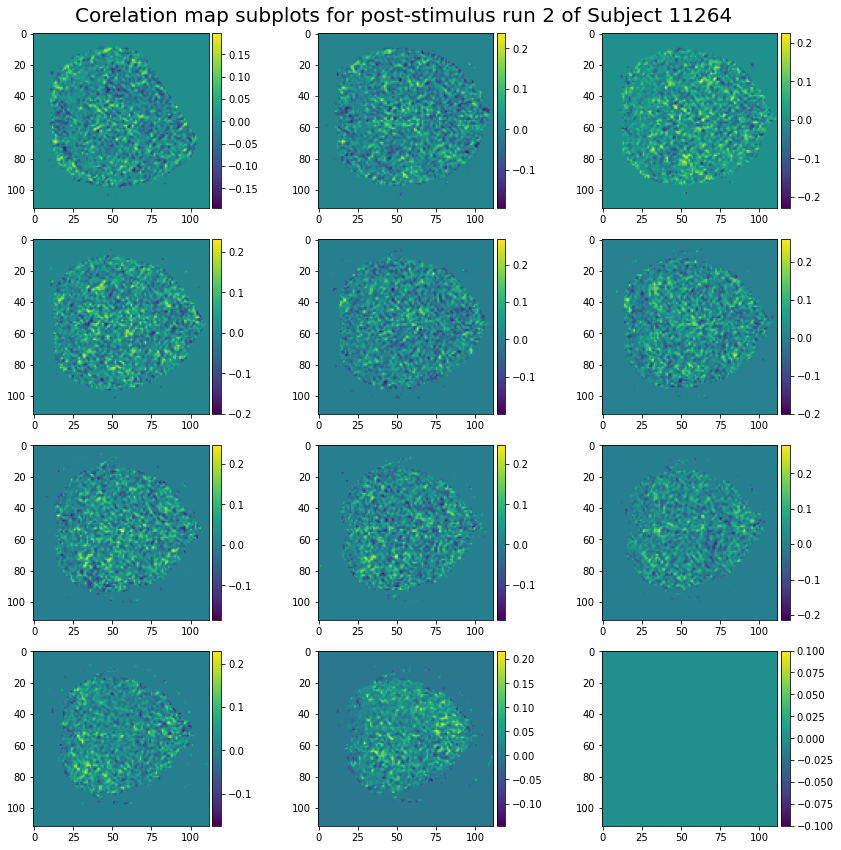

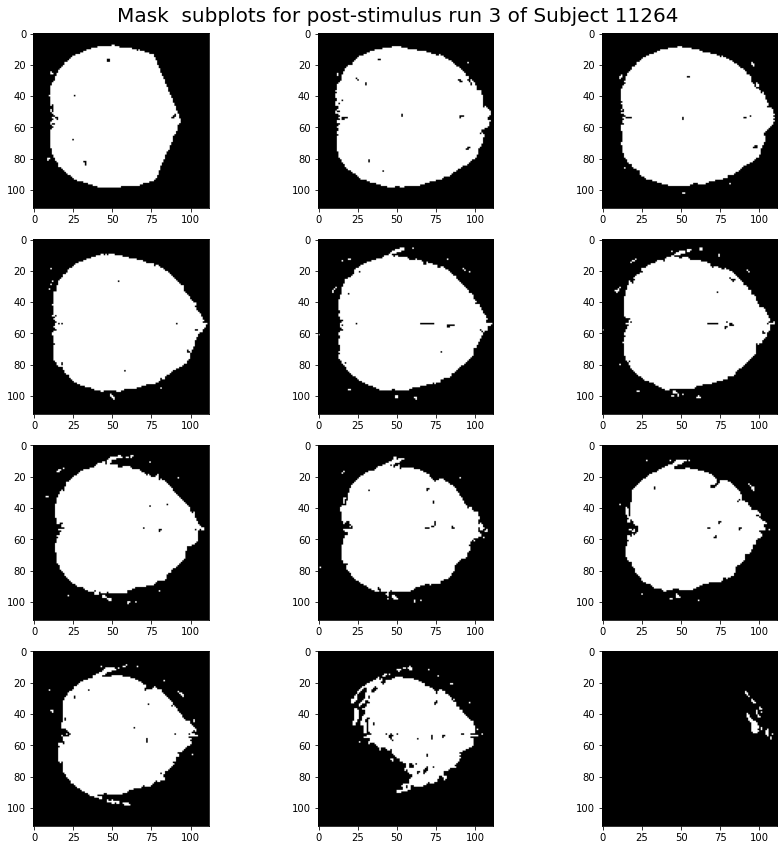

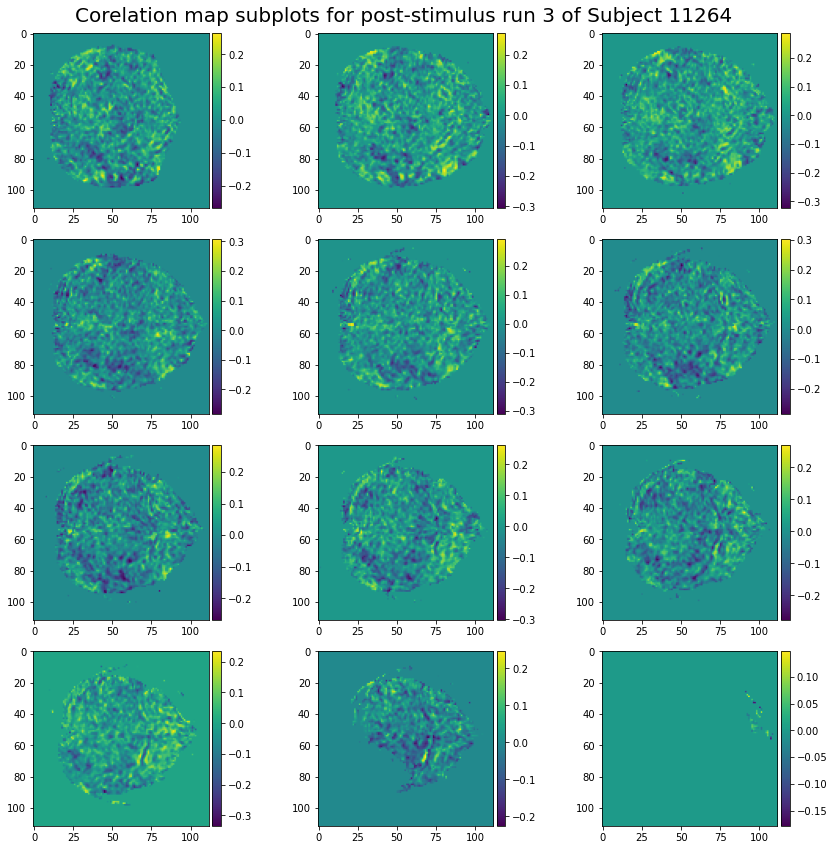

In [ ]:
import nibabel as nib # We'll call nibabel nib for short as we'll be calling it lots
from nibabel.processing import resample_from_to 
import matplotlib.pyplot as plt 
import scipy.io as sio
import os
from nibabel.testing import data_path
#showing mask and correlation maps for the BOLD response
epi_img1_11264 = nib.load("flirts\\flirt_BOLD_TS_11264_r1.nii") # Import the data. 
epi_voxels1_11264 = epi_img1_11264.get_fdata() # Get a 3D array of voxels
mask_list1_11264, cc_image1_11264 = correlation_map("subplots for run1 of Subject 11264 ",epi_voxels1_11264,convolution1_11264[::30])
epi_img2_11264 = nib.load("flirts\\realign_interleaved_BOLD_TS_11264_r2.img") # Import the data. 
epi_voxels2_11264 = epi_img2_11264.get_fdata() # Get a 3D array of voxels
mask_list2_11264, cc_image2_11264 = correlation_map(" subplots for run2 of Subject 11264",epi_voxels2_11264,convolution2_11264[::30])
epi_img3_11264 = nib.load("flirts\\flirt_BOLD_TS_11264_r3.nii") # Import the data. 
epi_voxels3_11264 = epi_img3_11264.get_fdata() # Get a 3D array of voxels
mask_list3_11264, cc_image3_11264 = correlation_map(" subplots for run3 of Subject 11264",epi_voxels3_11264,convolution3_11264[::30])

#showing post stimulus response
mask_list1_11264p, cc_image1_11264p = correlation_map("subplots for post-stimulus run 1 of Subject 11264",epi_voxels1_11264,postconv1_11264[::30])

mask_list2_11264p, cc_image2_11264p = correlation_map(" subplots for post-stimulus run 2 of Subject 11264",epi_voxels2_11264,postconv2_11264[::30])

mask_list3_11264p, cc_image3_11264p = correlation_map(" subplots for post-stimulus run 3 of Subject 11264",epi_voxels3_11264,postconv3_11264[::30])

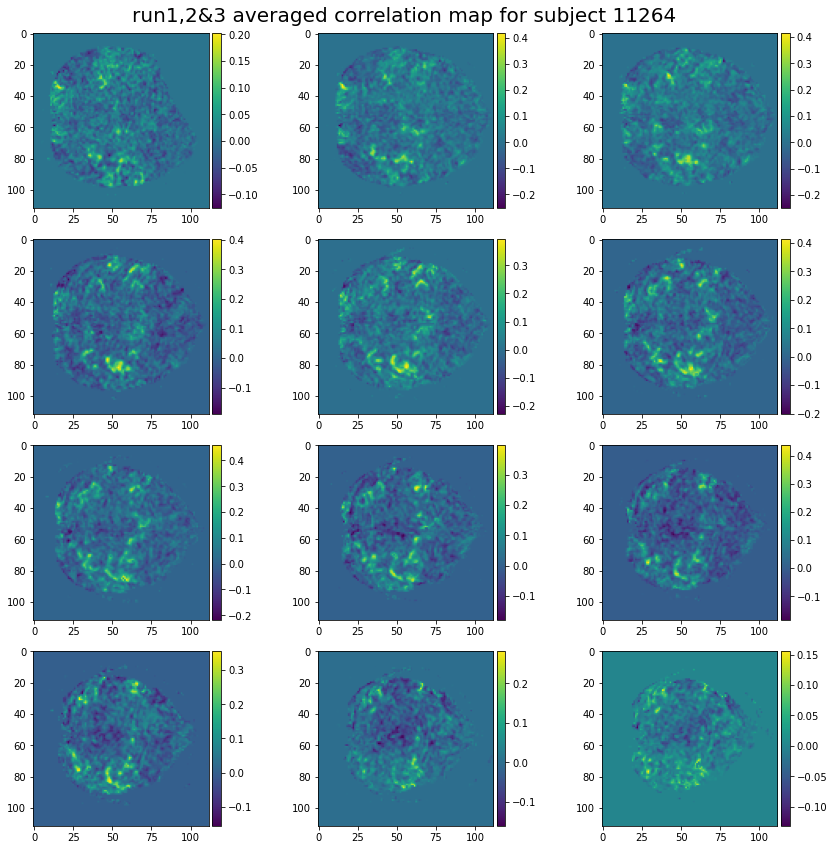

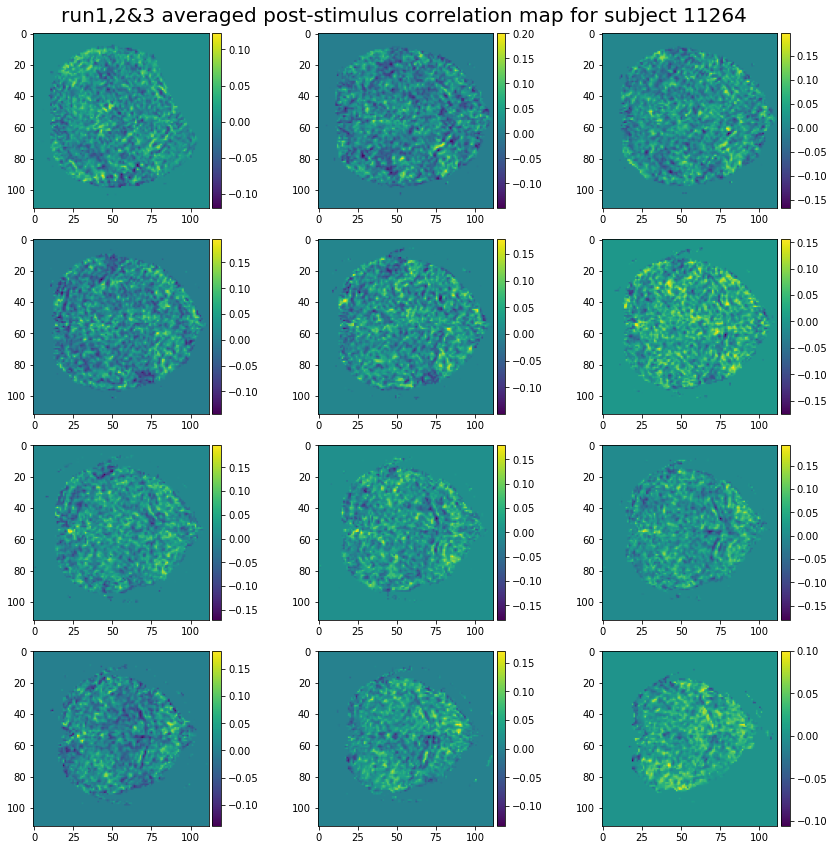

In [ ]:
cc_average_11264 = (cc_image1_11264 + cc_image2_11264 + cc_image3_11264)/3
average_plot_11264 = average_plot("run1,2&3 averaged correlation map for subject 11264",cc_average_11264)
cc_post_average_11264 = (cc_image1_11264p + cc_image2_11264p + cc_image3_11264p)/3
post_average_plot_11264 = average_plot("run1,2&3 averaged post-stimulus correlation map for subject 11264",cc_post_average_11264)

***
# Subject 11311


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Thu Jan 23 16:32:41 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[ 2.9976, 11.    ,  2.968 ,  2.9996, 11.    , 10.992 , 10.947 ,
         3.    , 10.9972, 10.9766,  2.8612,  2.8636]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[ 2.9976 11.      2.968   2.9996 11.     10.992  10.947   3.     10.9972
  10.9766  2.8612  2.8636]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791

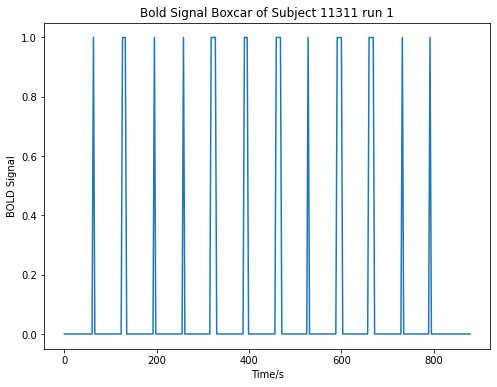

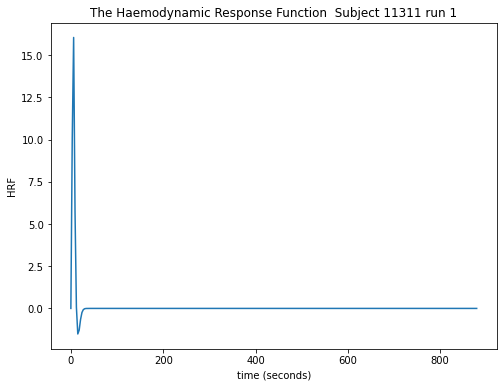

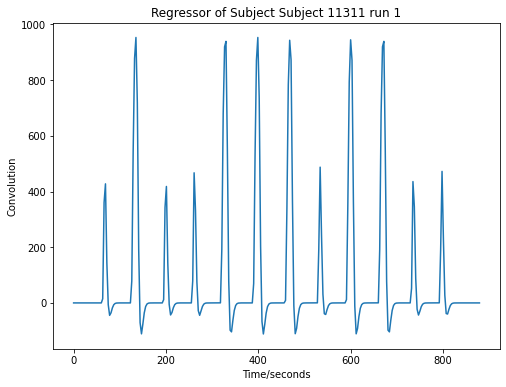

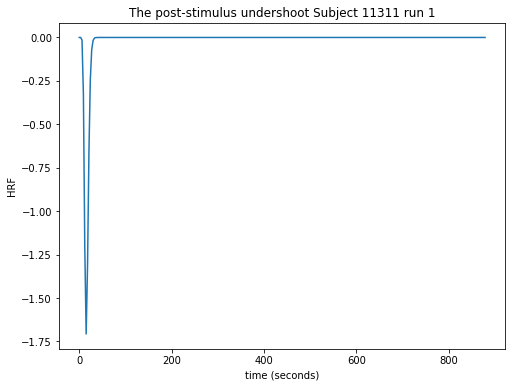

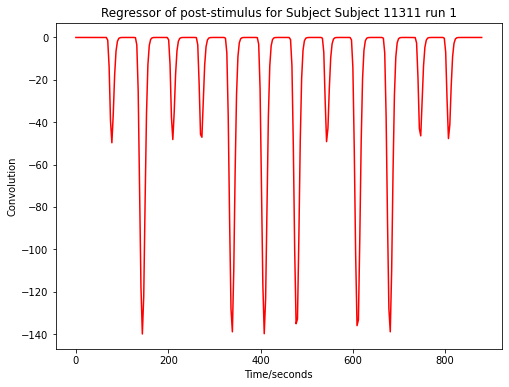


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Thu Jan 23 16:32:09 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[10.9302,  2.9696, 11.    , 10.9824,  2.8068,  2.9128,  2.9892,
        10.972 ,  2.9426,  3.    , 10.9886, 10.9804]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[10.9302  2.9696 11.     10.9824  2.8068  2.9128  2.9892 10.972   2.9426
   3.     10.9886 10.9804]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791

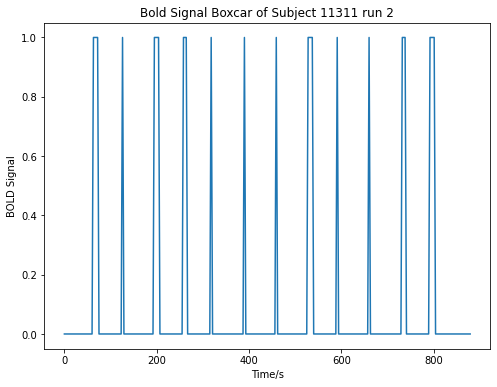

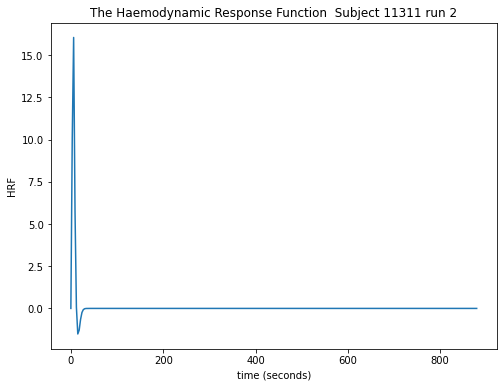

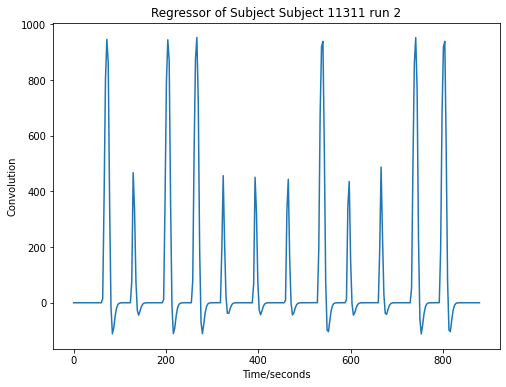

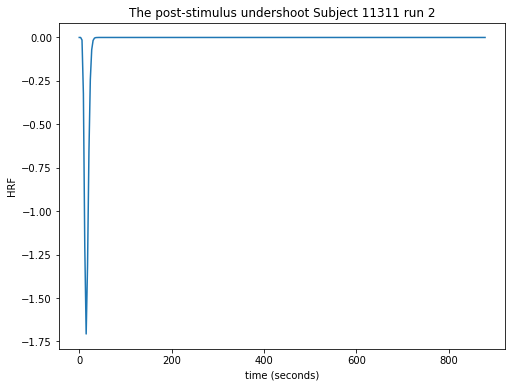

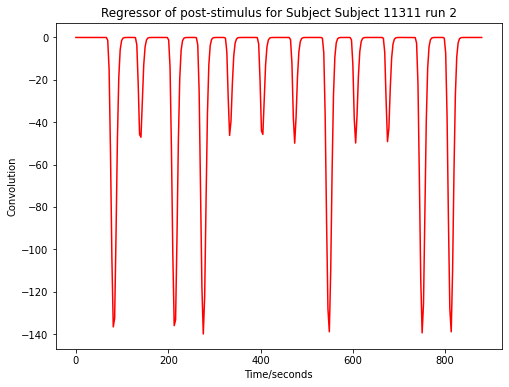


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Thu Jan 23 16:32:57 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[10.9914,  2.9432,  2.9424, 10.9716, 10.9148, 10.9964,  2.9414,
        11.    , 10.993 ,  2.9802,  2.616 ,  2.9976]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[10.9914  2.9432  2.9424 10.9716 10.9148 10.9964  2.9414 11.     10.993
   2.9802  2.616   2.9976]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791.

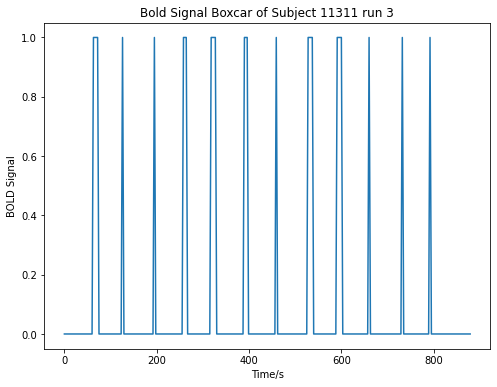

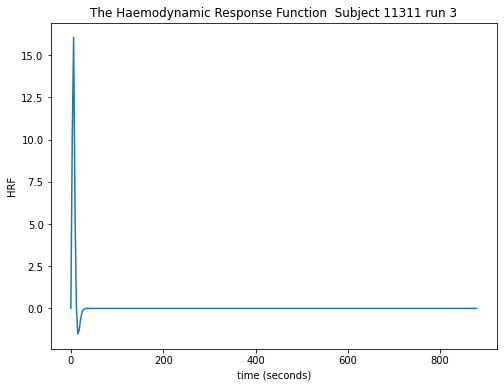

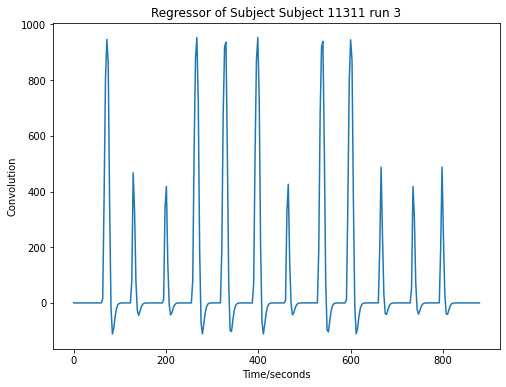

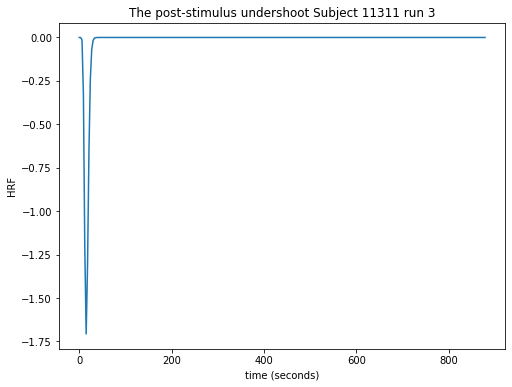

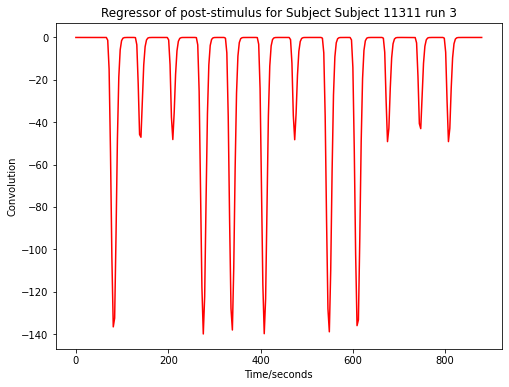

In [ ]:
#run 1
onset1_11311= sio.loadmat("Subject11311\\run1_BOLD_EMG_onset_11311")
durations1_11311 = sio.loadmat("Subject11311\\run1_durations_11311")
x1_11311,y1_11311,convolution1_11311,postconv1_11311= box_car("Subject 11311 run 1",onset1_11311,durations1_11311)
#run 2
onset2_11311= sio.loadmat("Subject11311\\run2_BOLD_EMG_onset_11311")
durations2_11311 = sio.loadmat("Subject11311\\run2_durations_11311")
x2_11311,y2_11311,convolution2_11311,postconv2_11311= box_car("Subject 11311 run 2",onset2_11311,durations2_11311)
#run 3
onset3_11311= sio.loadmat("Subject11311\\run3_BOLD_EMG_onset_11311")
durations3_11311 = sio.loadmat("Subject11311\\run3_durations_11311")
x3_11311,y3_11311,convolution3_11311,postconv3_11311= box_car("Subject 11311 run 3",onset3_11311,durations3_11311)

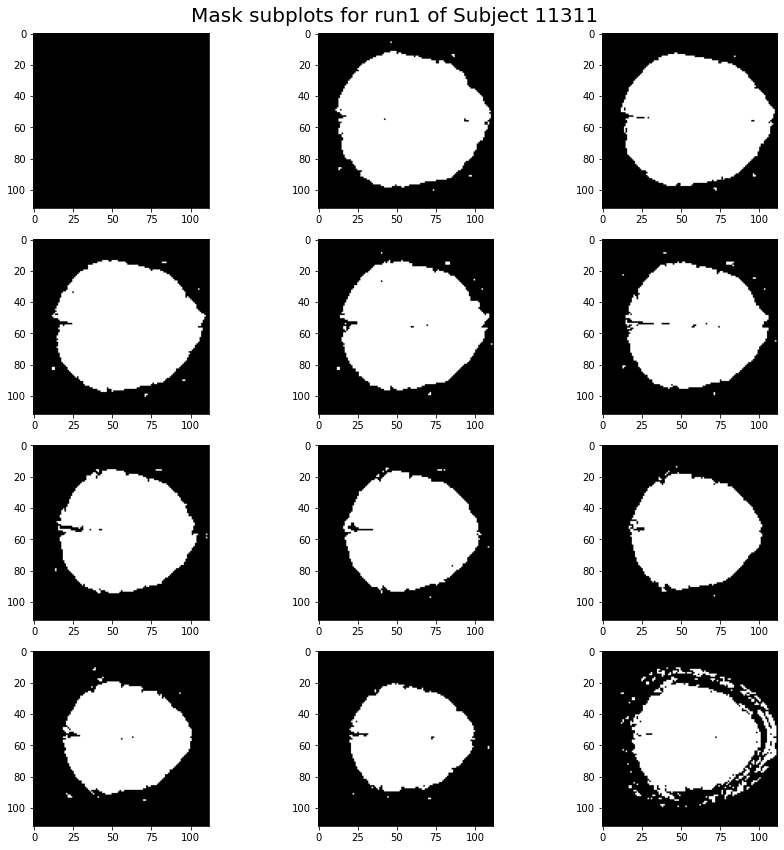

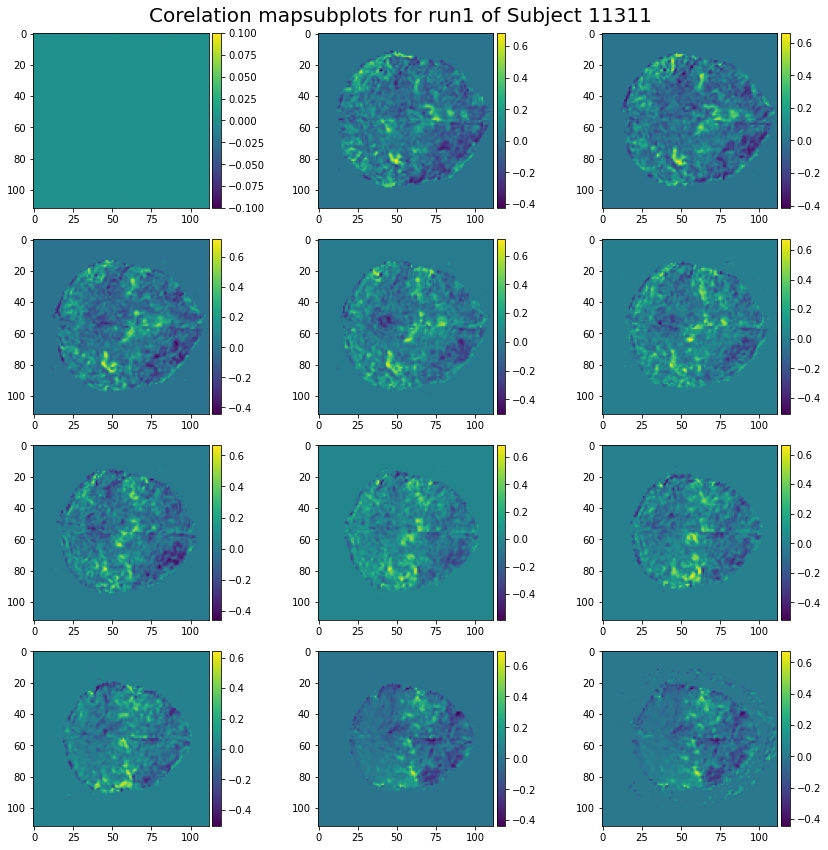

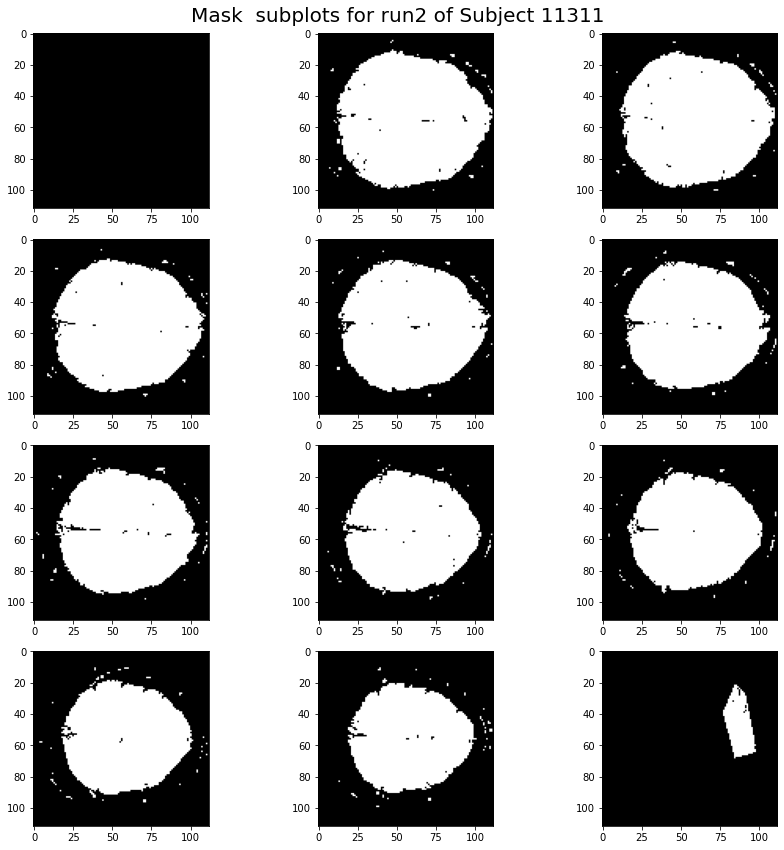

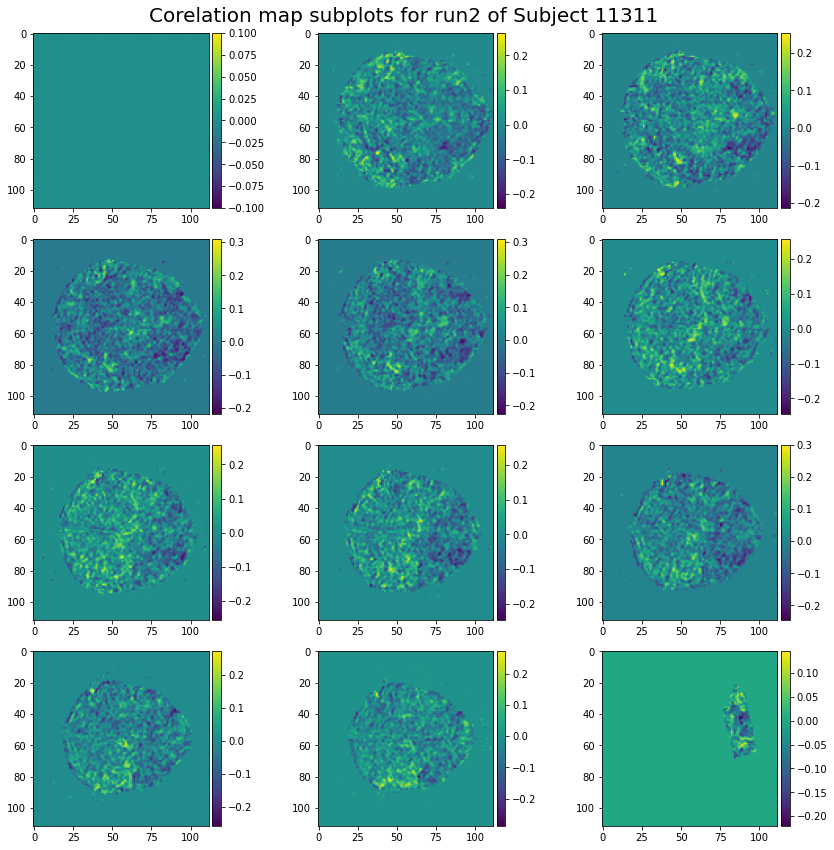

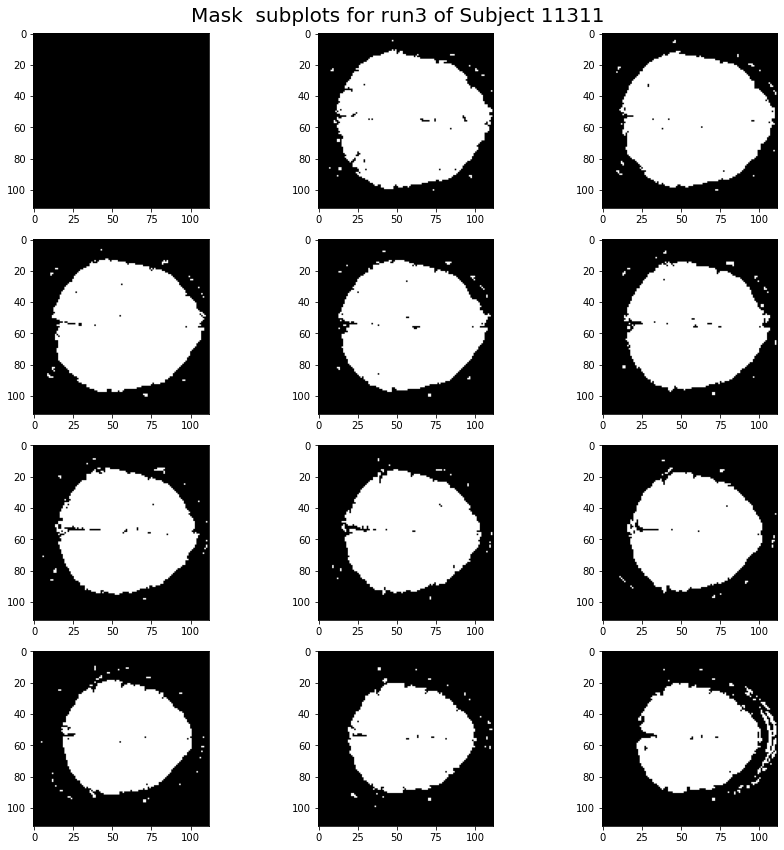

...

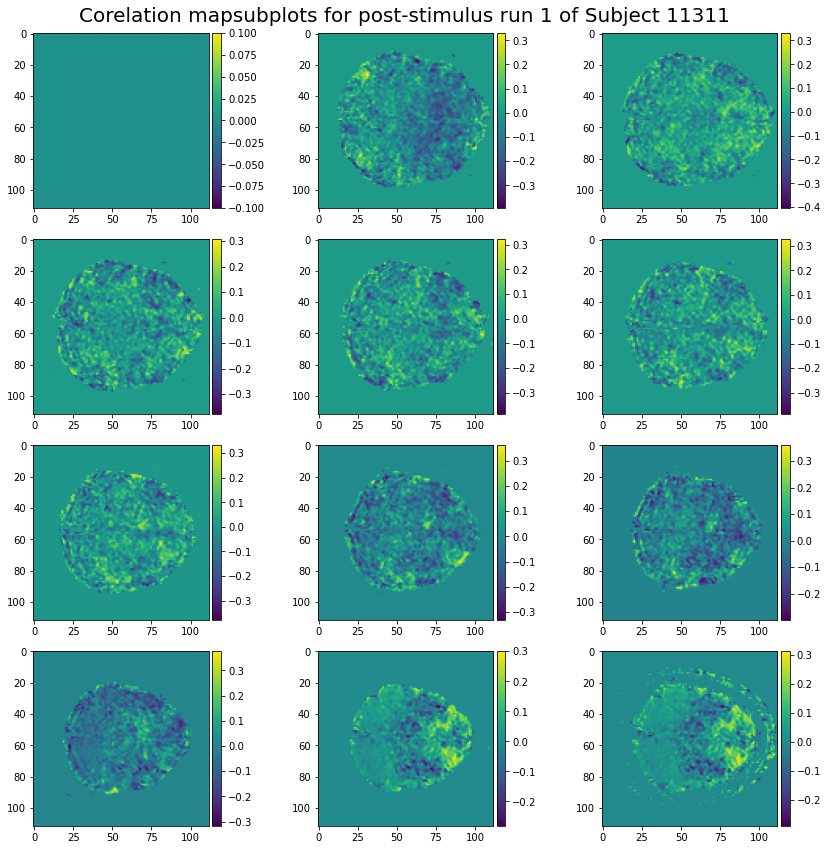

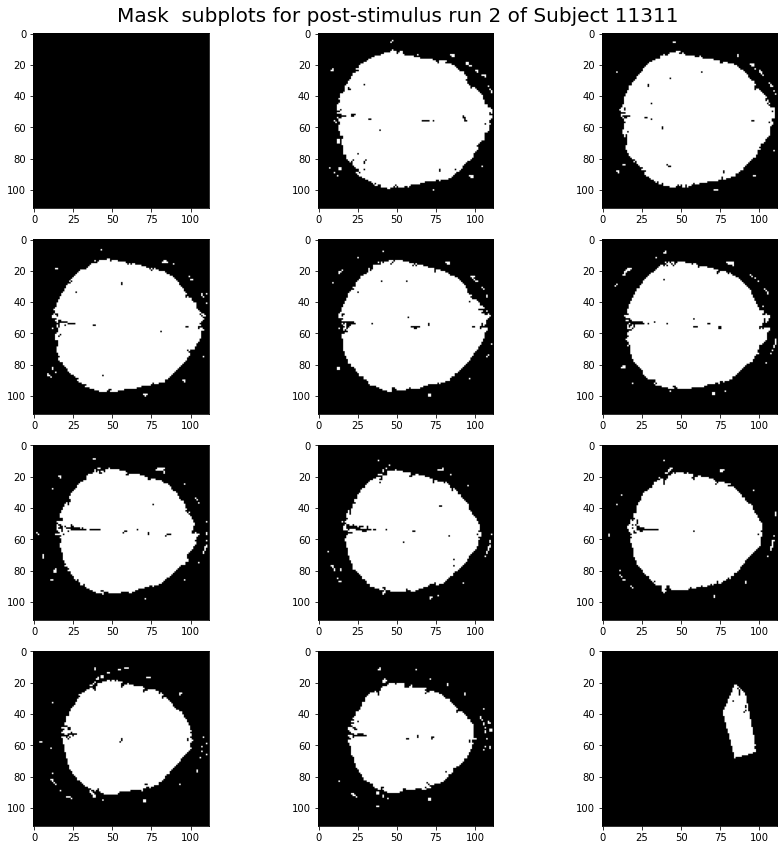

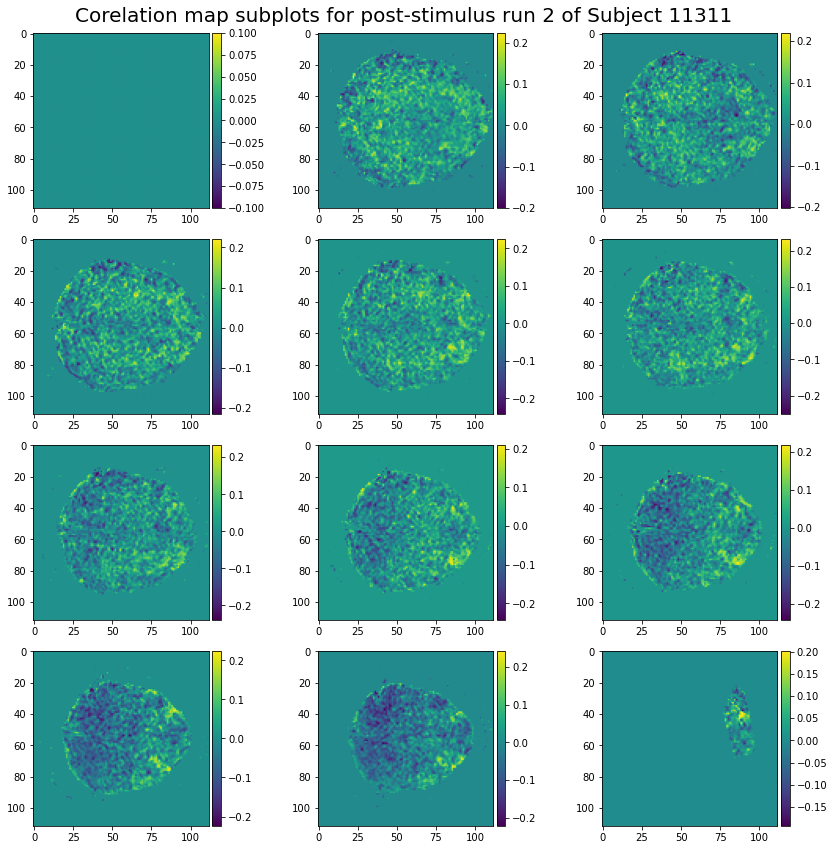

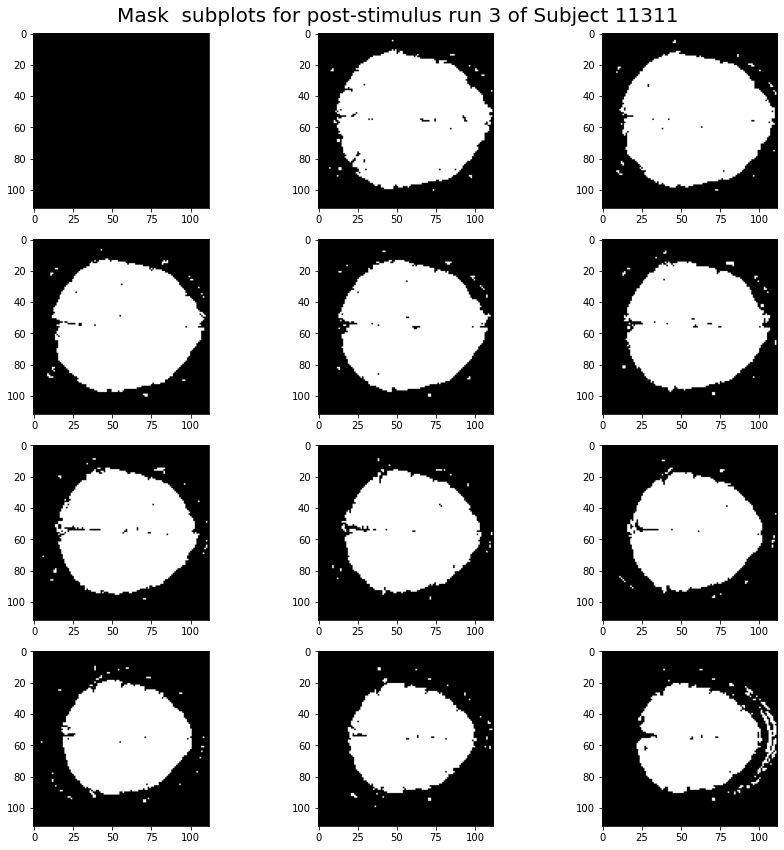

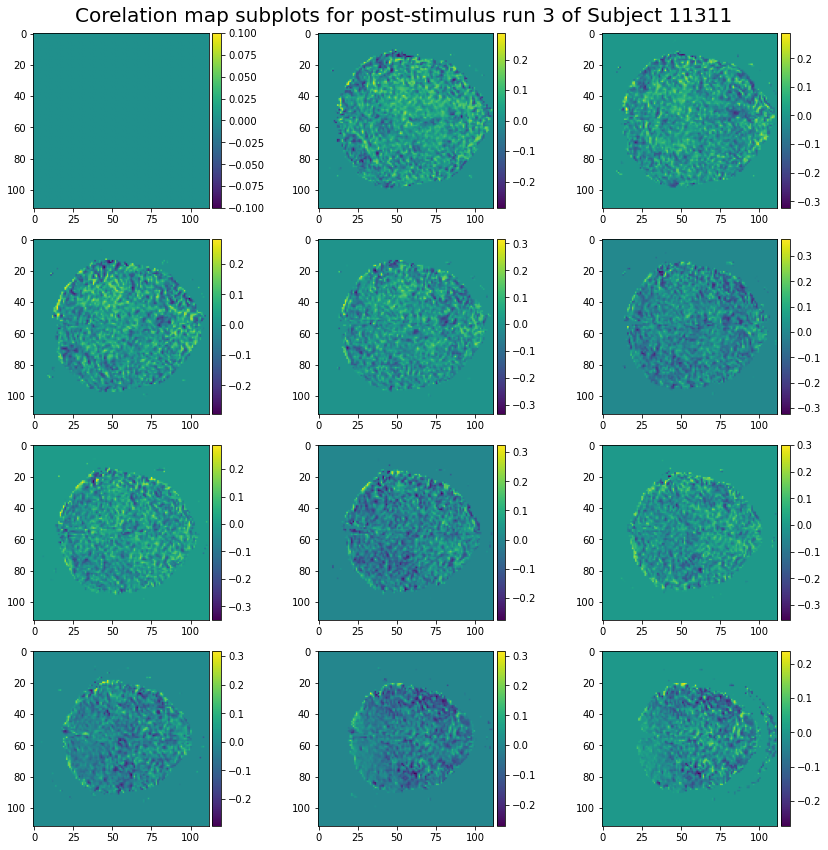

In [ ]:
import nibabel as nib # We'll call nibabel nib for short as we'll be calling it lots
from nibabel.processing import resample_from_to 
import matplotlib.pyplot as plt 
import scipy.io as sio
import os
from nibabel.testing import data_path
#showing mask and correlation maps for the BOLD response
epi_img1_11311 = nib.load("flirts\\flirt_BOLD_TS_11311_r1.nii") # Import the data. 
epi_voxels1_11311 = epi_img1_11311.get_fdata() # Get a 3D array of voxels
mask_list1_11311, cc_image1_11311 = correlation_map("subplots for run1 of Subject 11311 ",epi_voxels1_11311,convolution1_11311[::30])
epi_img2_11311 = nib.load("flirts\\realign_interleaved_BOLD_TS_11311_r2.img") # Import the data. 
epi_voxels2_11311 = epi_img2_11311.get_fdata() # Get a 3D array of voxels
mask_list2_11311, cc_image2_11311 = correlation_map(" subplots for run2 of Subject 11311",epi_voxels2_11311,convolution2_11311[::30])
epi_img3_11311 = nib.load("flirts\\flirt_BOLD_TS_11311_r3.nii") # Import the data. 
epi_voxels3_11311 = epi_img3_11311.get_fdata() # Get a 3D array of voxels
mask_list3_11311, cc_image3_11311 = correlation_map(" subplots for run3 of Subject 11311",epi_voxels3_11311,convolution3_11311[::30])

#showing post stimulus response
mask_list1_11311p, cc_image1_11311p = correlation_map("subplots for post-stimulus run 1 of Subject 11311",epi_voxels1_11311,postconv1_11311[::30])

mask_list2_11311p, cc_image2_11311p = correlation_map(" subplots for post-stimulus run 2 of Subject 11311",epi_voxels2_11311,postconv2_11311[::30])

mask_list3_11311p, cc_image3_11311p = correlation_map(" subplots for post-stimulus run 3 of Subject 11311",epi_voxels3_11311,postconv3_11311[::30])

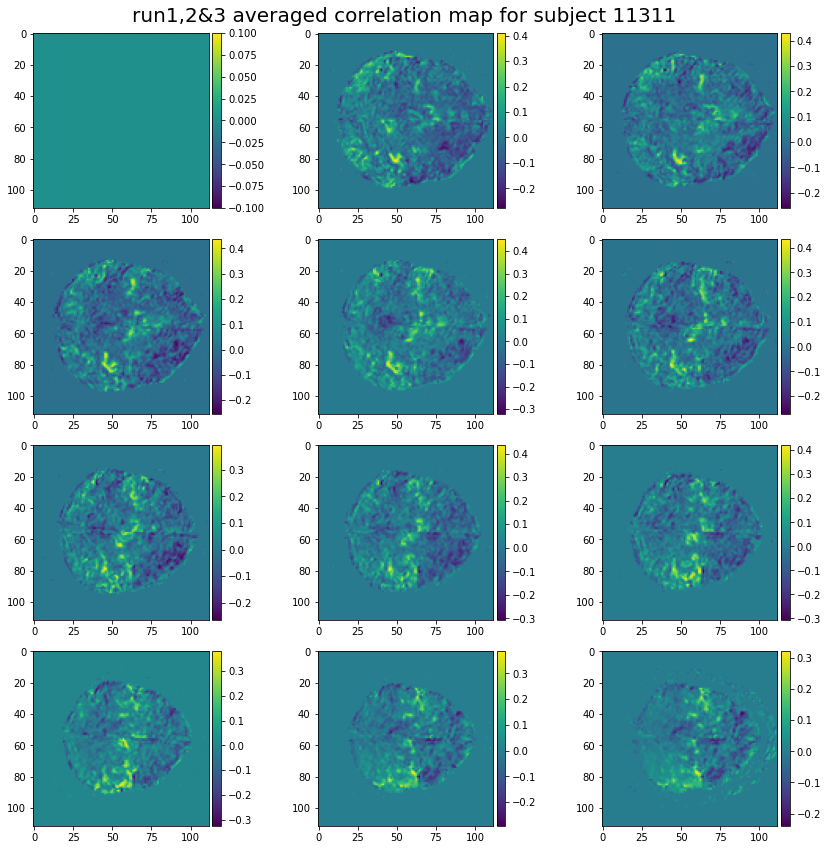

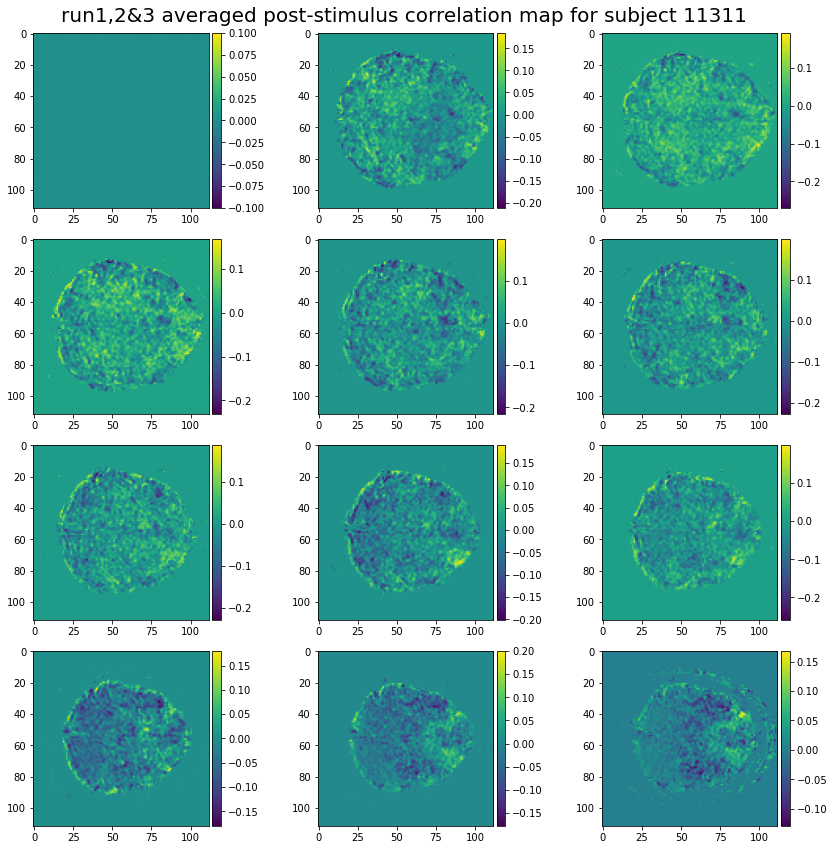

In [ ]:
cc_average_11311 = (cc_image1_11311 + cc_image2_11311 + cc_image3_11311)/3
average_plot_11311 = average_plot("run1,2&3 averaged correlation map for subject 11311",cc_average_11311)
cc_post_average_11311 = (cc_image1_11311p + cc_image2_11311p + cc_image3_11311p)/3
post_average_plot_11311 = average_plot("run1,2&3 averaged post-stimulus correlation map for subject 11311",cc_post_average_11311)

***
# Subject 14525


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Sun Jan 26 17:49:18 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[ 2.995 , 10.9982,  2.9782,  2.8758, 10.9932, 11.    , 10.9762,
         2.9324, 10.9786, 11.    ,  3.    ,  2.9746]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[ 2.995  10.9982  2.9782  2.8758 10.9932 11.     10.9762  2.9324 10.9786
  11.      3.      2.9746]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791

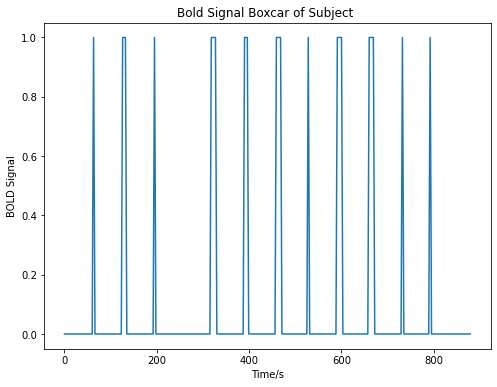

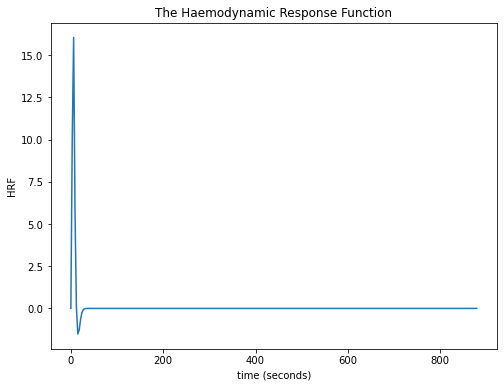

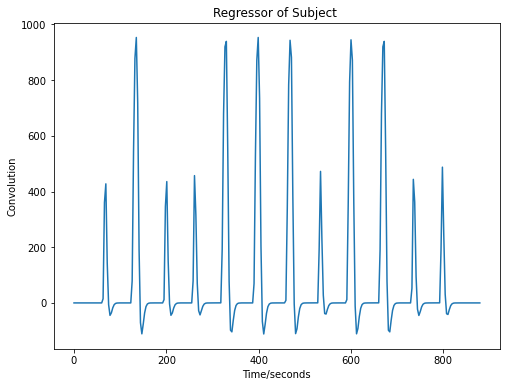

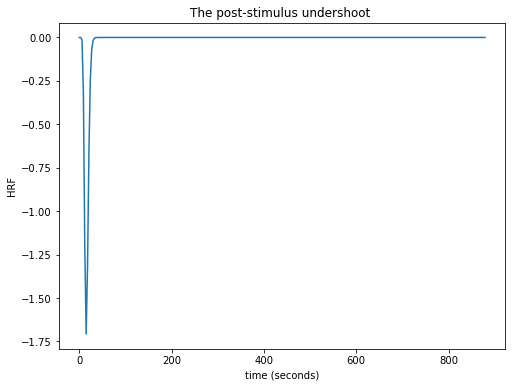

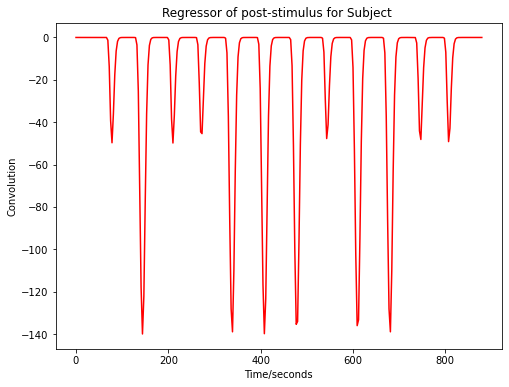


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Sun Jan 26 17:49:31 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[10.8218,  2.7416, 10.9086, 10.888 ,  3.    ,  2.911 ,  2.9928,
        10.9976,  2.9396,  2.9806, 10.908 , 10.9596]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[10.8218  2.7416 10.9086 10.888   3.      2.911   2.9928 10.9976  2.9396
   2.9806 10.908  10.9596]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791

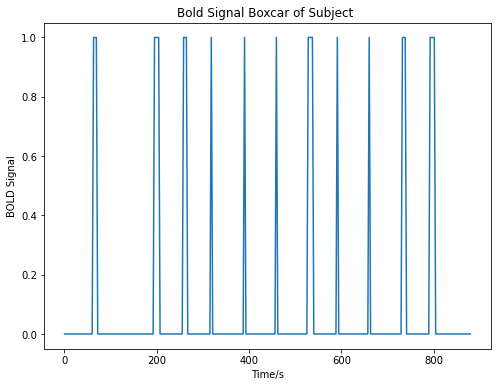

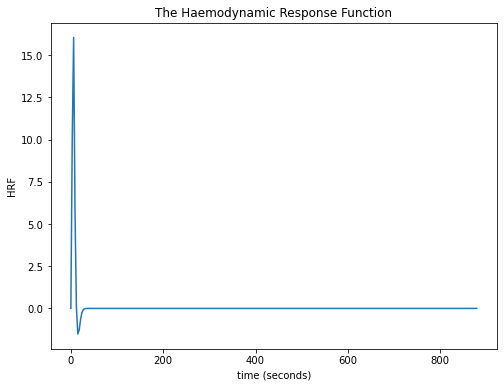

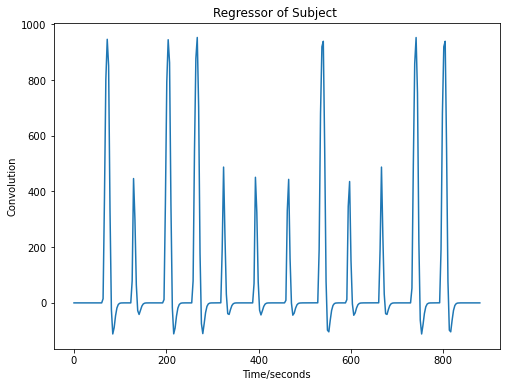

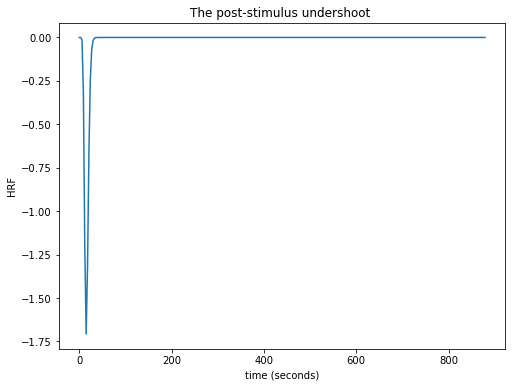

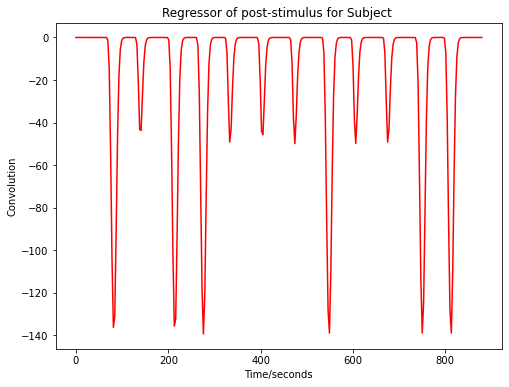


    Duration is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Sun Jan 26 17:49:45 2020', '__version__': '1.0', '__globals__': [], 'move_dur': array([[10.999 ,  2.8708,  2.7324, 10.9824, 10.8594, 10.8028,  2.8968,
        10.7148, 11.    ,  2.6626,  2.6698,  2.6994]])} of type <class 'dict'>
    Onset is: {'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Mon Jan 27 14:14:49 2020', '__version__': '1.0', '__globals__': [], 'bold': array([[ 61.09333841, 123.07882939, 193.12411625, 255.09806695,
        317.15448685, 387.13549555, 457.24581471, 527.14663077,
        589.17475437, 659.15839255, 729.38789992, 791.17921721]])} of type <class 'dict'>
    Durations specifically: [[10.999   2.8708  2.7324 10.9824 10.8594 10.8028  2.8968 10.7148 11.
   2.6626  2.6698  2.6994]]
    Onset specifically: [[ 61.09333841 123.07882939 193.12411625 255.09806695 317.15448685
  387.13549555 457.24581471 527.14663077 589.17475437 659.15839255
  729.38789992 791.179

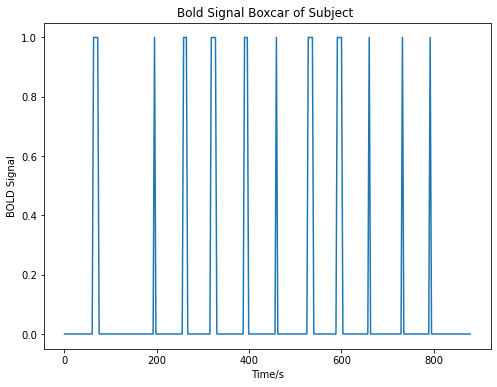

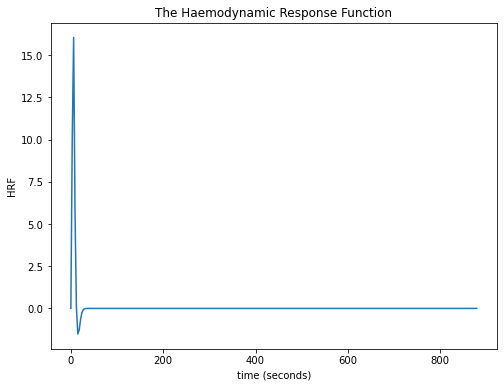

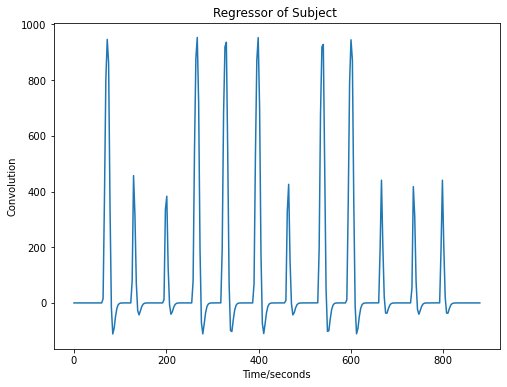

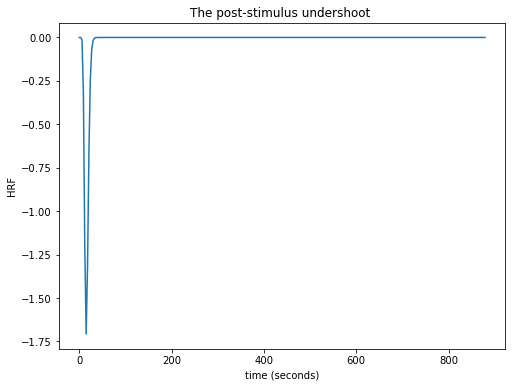

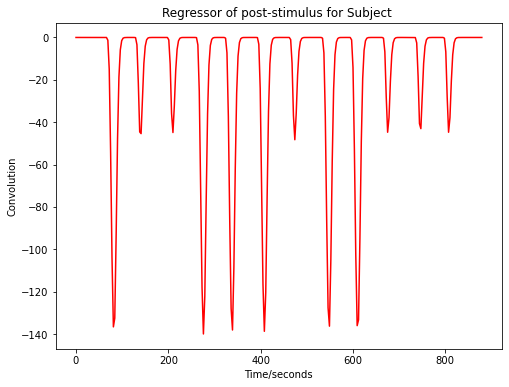

In [ ]:
#run 1
onset1_14525= sio.loadmat("Subject14525\\run1_BOLD_EMG_onset_14525")
durations1_14525 = sio.loadmat("Subject14525\\run1_durations_14525")
x1_14525,y1_14525,convolution1_14525,postconv1_14525= box_car("Subject 14525 run 1",onset1_14525,durations1_14525)
#run 2
onset2_14525= sio.loadmat("Subject14525\\run2_BOLD_EMG_onset_14525")
durations2_14525 = sio.loadmat("Subject14525\\run2_durations_14525")
x2_14525,y2_14525,convolution2_14525,postconv2_14525= box_car("Subject 14525 run 2",onset2_14525,durations2_14525)
#run 3
onset3_14525= sio.loadmat("Subject14525\\run3_BOLD_EMG_onset_14525")
durations3_14525 = sio.loadmat("Subject14525\\run3_durations_14525")
x3_14525,y3_14525,convolution3_14525,postconv3_14525= box_car("Subject 14525 run 3",onset3_14525,durations3_14525)

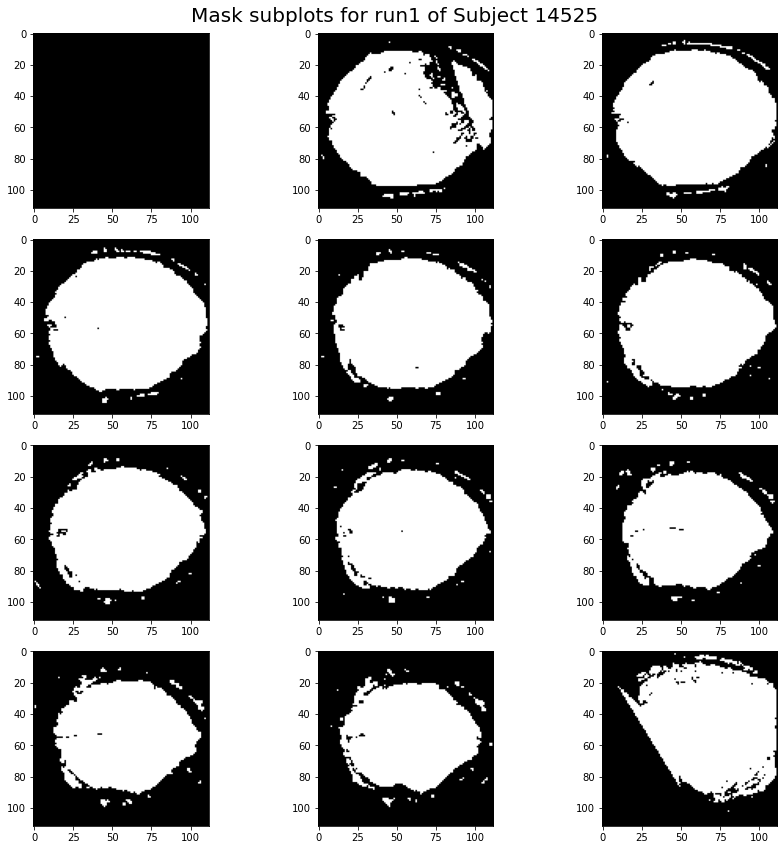

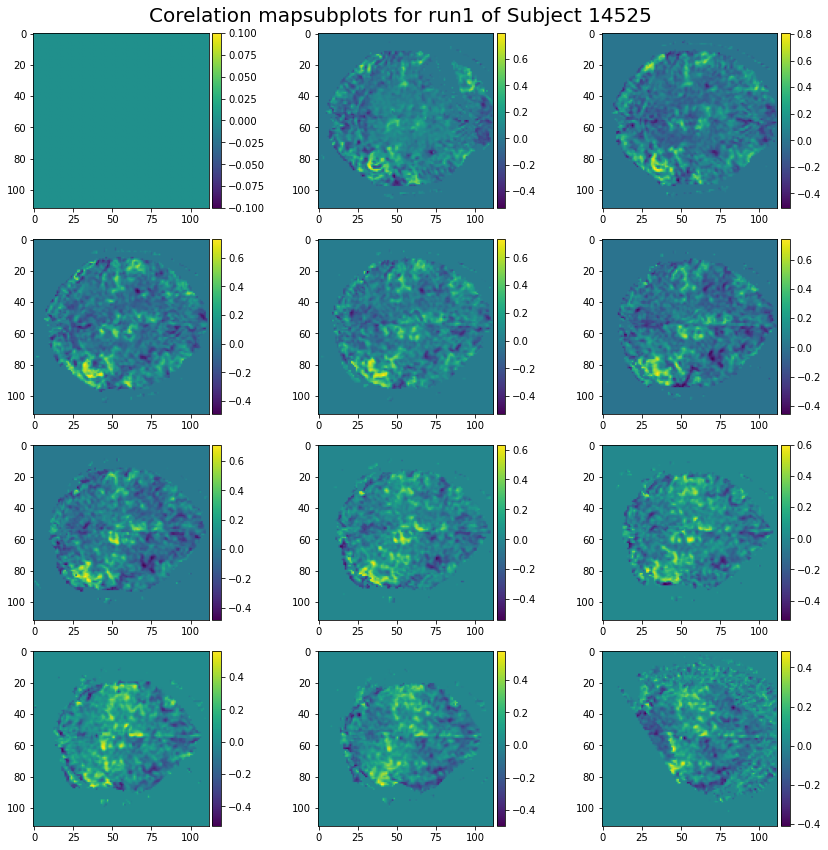

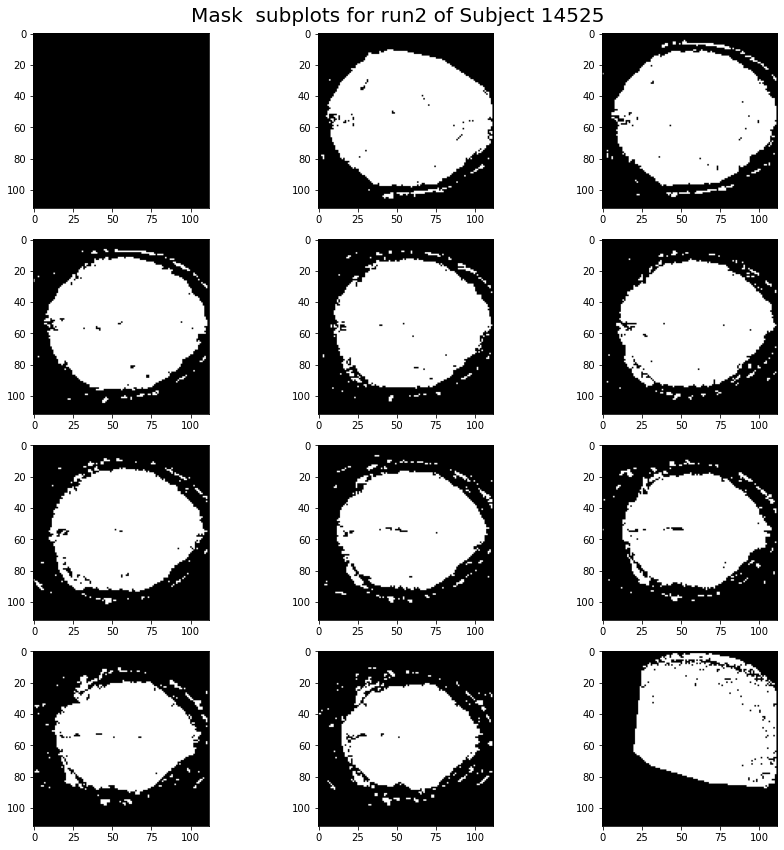

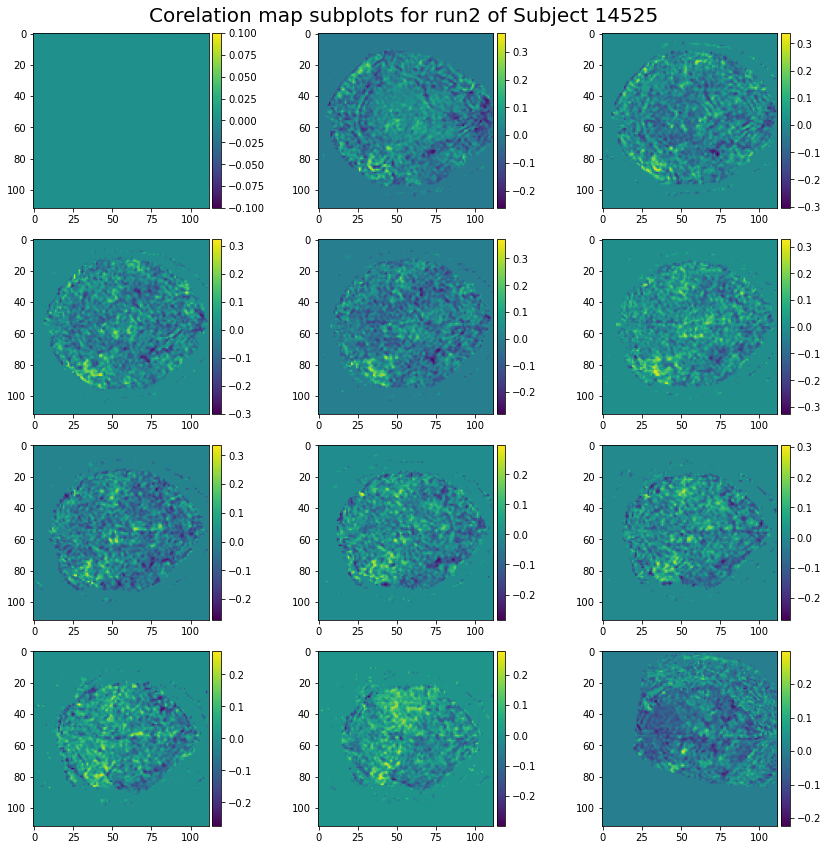

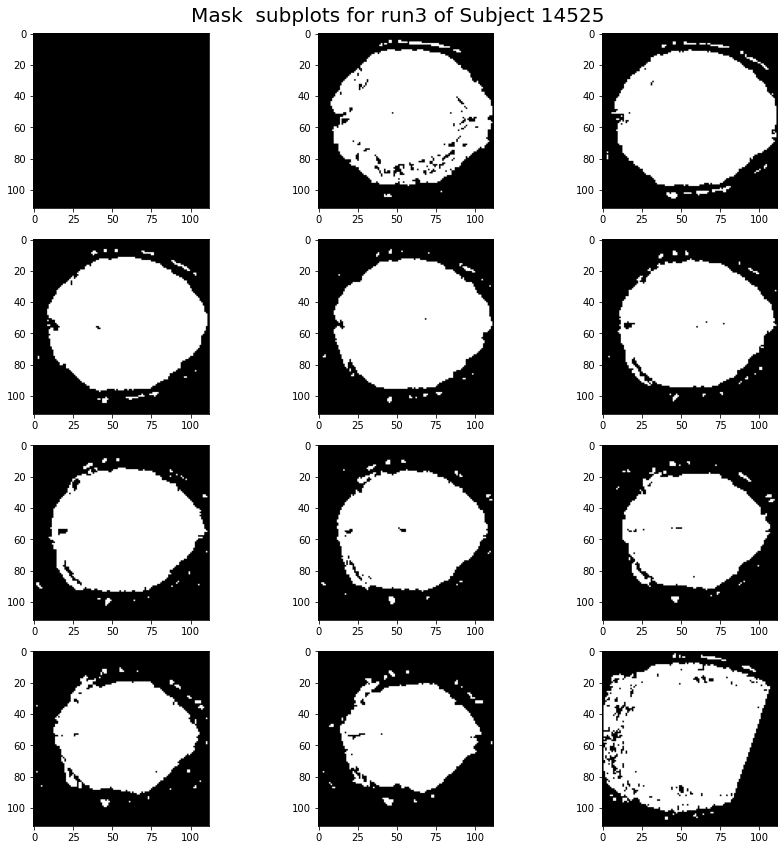

...

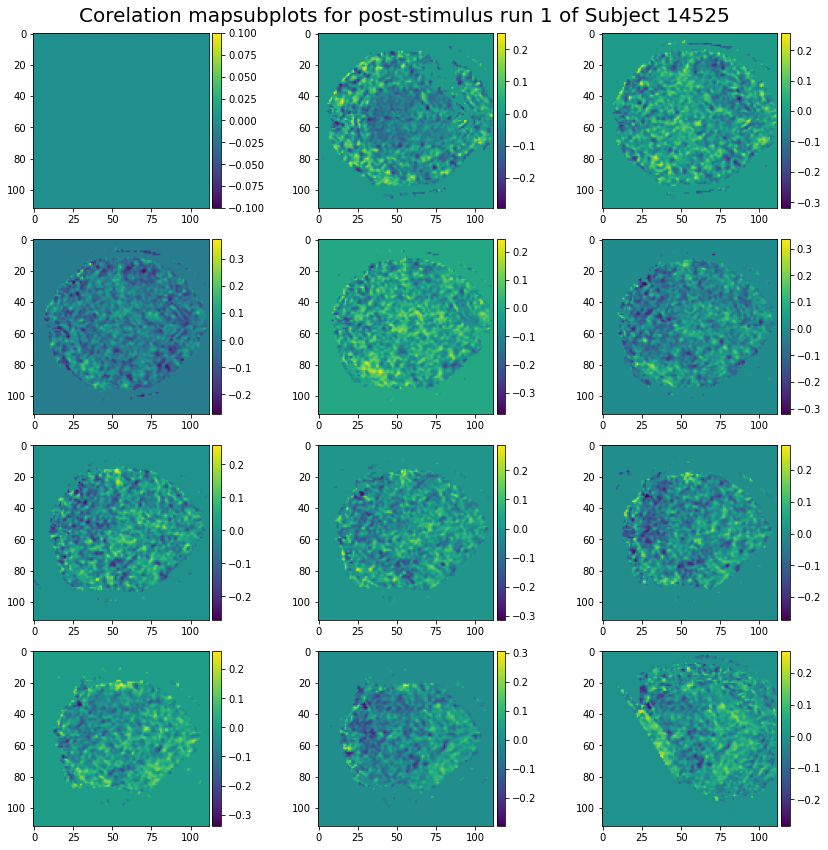

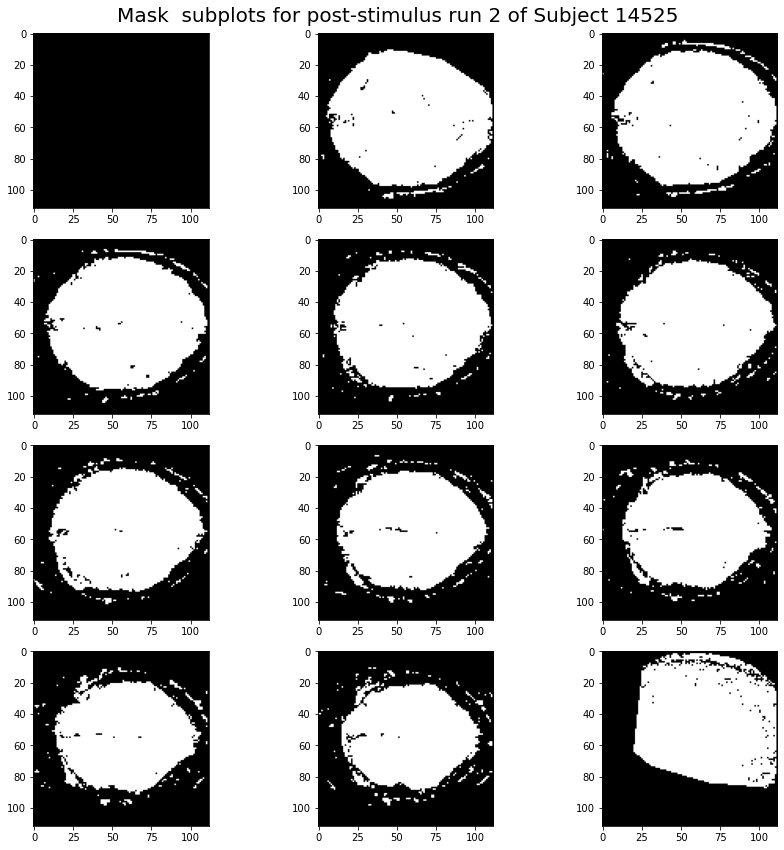

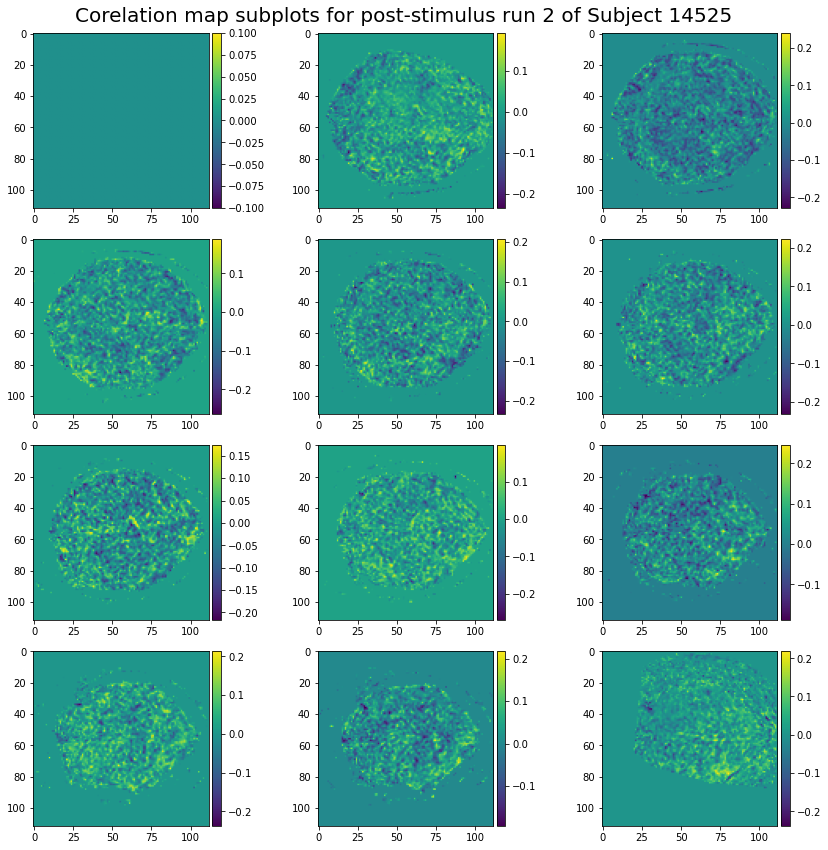

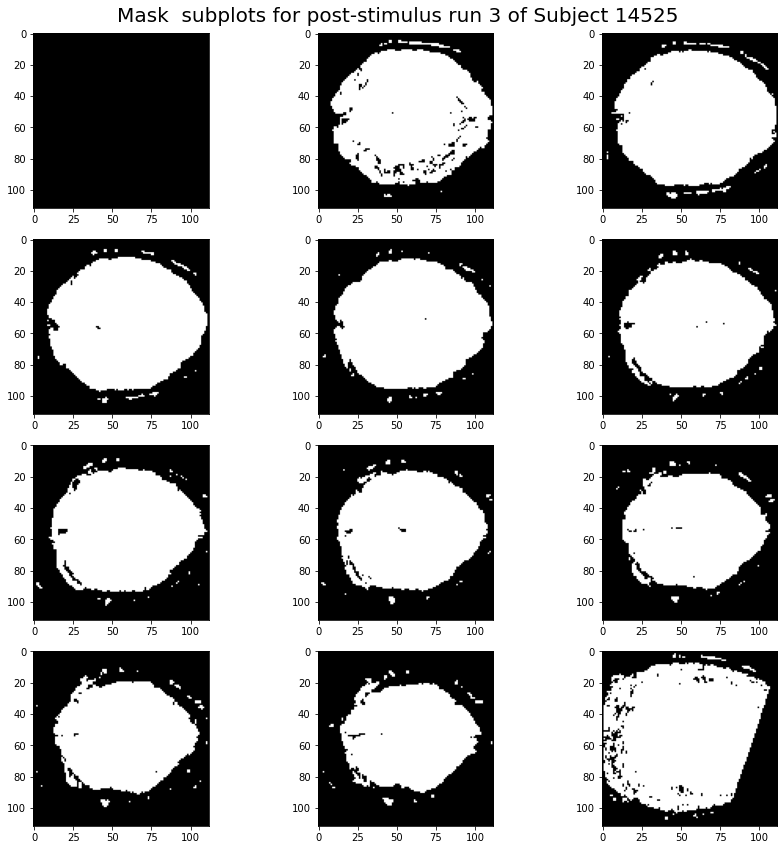

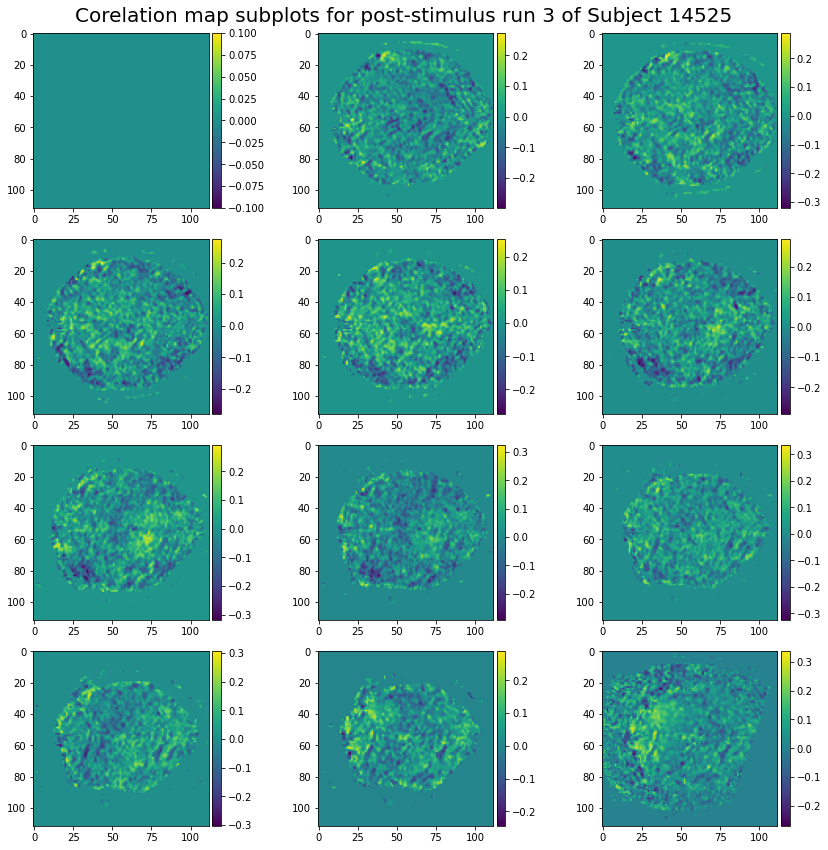

In [ ]:
import nibabel as nib # We'll call nibabel nib for short as we'll be calling it lots
from nibabel.processing import resample_from_to 
import matplotlib.pyplot as plt 
import scipy.io as sio
import os
from nibabel.testing import data_path
#showing mask and correlation maps for the BOLD response
epi_img1_14525 = nib.load("flirts\\flirt_BOLD_TS_14525_r1.nii") # Import the data. 
epi_voxels1_14525 = epi_img1_14525.get_fdata() # Get a 3D array of voxels
mask_list1_14525, cc_image1_14525 = correlation_map("subplots for run1 of Subject 14525 ",epi_voxels1_14525,convolution1_14525[::30])
epi_img2_14525 = nib.load("flirts\\realign_interleaved_BOLD_TS_14525_r2.img") # Import the data. 
epi_voxels2_14525 = epi_img2_14525.get_fdata() # Get a 3D array of voxels
mask_list2_14525, cc_image2_14525 = correlation_map(" subplots for run2 of Subject 14525",epi_voxels2_14525,convolution2_14525[::30])
epi_img3_14525 = nib.load("flirts\\flirt_BOLD_TS_14525_r3.nii") # Import the data. 
epi_voxels3_14525 = epi_img3_14525.get_fdata() # Get a 3D array of voxels
mask_list3_14525, cc_image3_14525 = correlation_map(" subplots for run3 of Subject 14525",epi_voxels3_14525,convolution3_14525[::30])

#showing post stimulus response
mask_list1_14525p, cc_image1_14525p = correlation_map("subplots for post-stimulus run 1 of Subject 14525",epi_voxels1_14525,postconv1_14525[::30])

mask_list2_14525p, cc_image2_14525p = correlation_map(" subplots for post-stimulus run 2 of Subject 14525",epi_voxels2_14525,postconv2_14525[::30])

mask_list3_14525p, cc_image3_14525p = correlation_map(" subplots for post-stimulus run 3 of Subject 14525",epi_voxels3_14525,postconv3_14525[::30])

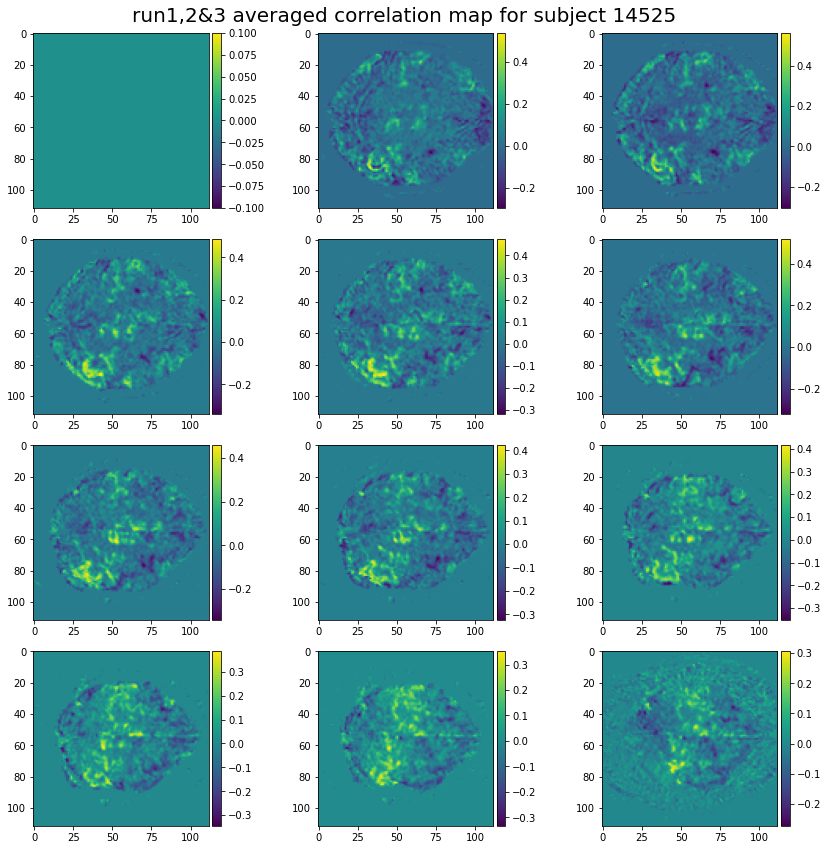

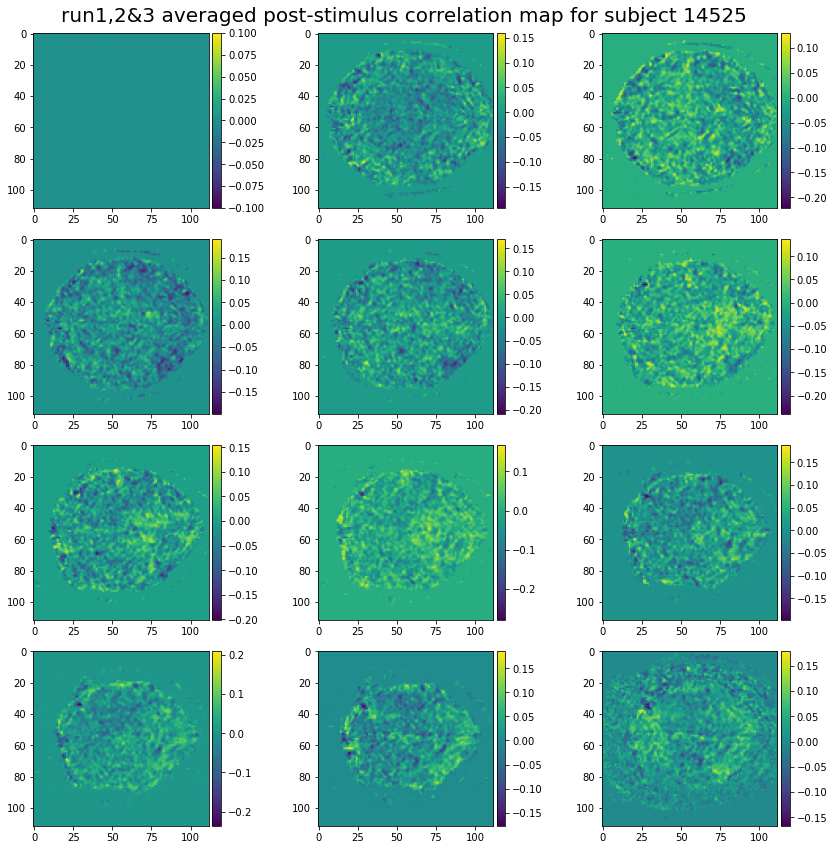

In [ ]:
cc_average_14525 = (cc_image1_14525 + cc_image2_14525 + cc_image3_14525)/3
average_plot_14525 = average_plot("run1,2&3 averaged correlation map for subject 14525",cc_average_14525)
cc_post_average_14525 = (cc_image1_14525p + cc_image2_14525p + cc_image3_14525p)/3
post_average_plot_14525 = average_plot("run1,2&3 averaged post-stimulus correlation map for subject 14525",cc_post_average_14525)